In [1]:
import csv
import os
import numpy as np
import pickle
import copy
if False:
    all_data = {}
    all_data['samples'] = {}
    all_data['final_times_arr'] = {}
    all_data['separation_dists'] = {}
    all_data['planned_times'] = {}
    all_data['planned_time_errors_arr'] = {}
    all_data['planned_time_error_pcts_arr'] = {}
else:
    all_data = pickle.load(open("processed_data.pkl","rb"))
task_summaries = {}
trt_names = {}
trt_names['1'] = 'HAMP-S-R'
trt_names['2'] = 'STAP-W'
trt_names['3'] = 'HAMP-P-R'
trt_names['4'] = 'HAMP-S-NR'
trt_names['5'] = 'HAMP-P-NR'

In [2]:
for subdir, dirs, filenames in os.walk(os.getcwd()):
    filenames.sort()
    for filename in filenames:
        if filename.endswith('.csv') and (not 'solver_perf' in filename) and (not '_plan_' in filename):
            path_parts = subdir.split(os.sep)
            if not "participant_data" in path_parts:
                print(path_parts)
                continue
            data_i = path_parts.index("participant_data")
            if (len(path_parts)>data_i+3):
                continue
            task = path_parts[data_i+2].split('_')[0][1:]
            method = path_parts[data_i+2].split('_')[1][1:]
            participant = path_parts[data_i+1][1:]
            found_keys = True
            for k in all_data.keys():
                if not task in all_data[k].keys():
                    found_keys = False
                elif not method in all_data[k][task].keys():
                    found_keys = False
                elif not participant in all_data[k][task][method].keys():
                    found_keys = False
            
            if not task in task_summaries.keys():
                task_summaries[task] = {}
            if not method in task_summaries[task].keys():
                task_summaries[task][method] = {}
            if not participant in task_summaries[task][method].keys():
                task_summaries[task][method][participant] = {}
            if found_keys:
                print('task {}, method {}, participant {} is in all_data, skip'.format(task,method,participant))
                task_summaries[task][method][participant] = '{} samples, \t{:.2f} seconds avg'.format(len(all_data['final_times_arr'][task][method][participant]),np.mean(all_data['final_times_arr'][task][method][participant]))
                continue
            else:
                print('task {}, method {}, participant {} is not in all_data, processing'.format(task,method,participant))
                            
            main_dir = path_parts[data_i+1]
            sub_dir = ''
            for i in range(data_i+2,len(path_parts)):
                sub_dir += path_parts[i] + '_'
            sub_dir += filename[:-4]
            test=filename[:-4]
            with open(os.path.join(subdir,filename)) as csv_file:
                csv_reader = csv.reader(csv_file, delimiter=',')
                line_count = 0
                prev_time = 0
                sample = np.empty((0,313))
                final_times = np.empty((0))
                planned_time = np.empty((0))
                planned_time_errors = np.empty((0))
                planned_time_error_pcts = np.empty((0))
                int_d_dts = np.empty((0))
                int_d_dt = 0
                samples = []
                for row in csv_reader:
    #                 print('{}, {}'.format(test,row[0]))
                    if row[0]=='t':
                        continue
                    if (float(row[0])<prev_time) and (sample.shape[0]>0):
#                         samples.setdefault(test, []).append(sample)
                        samples.append(copy.deepcopy(sample))
                        final_times = np.append(final_times,[sample[-1,0]])
#                         print(sample[0,272])
                        planned_time = np.append(planned_time,sample[0,310])
                        planned_time_errors = np.append(planned_time_errors,final_times[-1]-sample[0,310])
                        planned_time_error_pcts = np.append(planned_time_error_pcts,planned_time_errors[-1]/planned_time[-1]*100)
                        vels = np.linalg.norm(sample[:,6:12],axis=1,ord=2)
                        tmp_samples = sample[vels>0.01,311]
                        tmp_samples = tmp_samples[tmp_samples>0]
#                         print(tmp_samples.shape[0])
                        int_d_dts = np.append(int_d_dts,np.sum(tmp_samples)/tmp_samples.shape[0])
                        sample = np.empty((0,313))
#                         int_d_dts = np.append(int_d_dts,[int_d_dt/final_times[-1]])
                        int_d_dt = 0
                        prev_time = 0
                    row = ['0.0' if x==' ' else x for x in row]
                    try:
                        sample = np.append(sample,np.asarray(row[:314]).astype(float).reshape((1,313)),axis=0)
#                         if sample[-1,274]<0.5:
                        int_d_dt += sample[-1,311]*(float(row[0])-prev_time)
                        if ((float(row[0])-prev_time)<0) or (sample[-1,311]<0):
                            print('{},{},{}'.format(row[0],prev_time,sample[-1,311]))
                    except:
#                         print('{} error:{}'.format(test,row))
#                         print(len(row))
                        pass
                    prev_time = float(row[0])
#                 samples.setdefault(test, []).append(sample)
                try:
                    samples.append(copy.deepcopy(sample))
                    final_times = np.append(final_times,[sample[-1,0]])
                    planned_time = np.append(planned_time,sample[0,310])
                    planned_time_errors = np.append(planned_time_errors,final_times[-1]-sample[0,310])
                    planned_time_error_pcts = np.append(planned_time_error_pcts,planned_time_errors[-1]/planned_time[-1]*100)
                    vels = np.linalg.norm(sample[:,6:12],axis=1,ord=2)
                    tmp_samples = sample[vels>0.01,311]
                    tmp_samples = tmp_samples[tmp_samples>0]
#                         print(tmp_samples.shape[0])
                    int_d_dts = np.append(int_d_dts,np.sum(tmp_samples)/tmp_samples.shape[0])
                    datas = list(all_data.keys())
                    for k in datas:
                        if not task in all_data[k].keys():
                            all_data[k][task] = {}
                        if not method in all_data[k][task].keys():
                            all_data[k][task][method] = {}
                        if not participant in all_data[k][task][method].keys():
                            all_data[k][task][method][participant] = {}
                        if not task in task_summaries.keys():
                            task_summaries[task] = {}
                        if not method in task_summaries[task].keys():
                            task_summaries[task][method] = {}
                        if not participant in task_summaries[task][method].keys():
                            task_summaries[task][method][participant] = {}
                    all_data['samples'][task][method][participant] = copy.deepcopy(samples)
                    all_data['final_times_arr'][task][method][participant] = final_times
                    all_data['separation_dists'][task][method][participant] = int_d_dts
                    all_data['planned_times'][task][method][participant] = planned_time
                    all_data['planned_time_errors_arr'][task][method][participant] = planned_time_errors
                    all_data['planned_time_error_pcts_arr'][task][method][participant] = planned_time_error_pcts
                    print('{}:{} samples, \n\tavg final time:{:.3f} ({:.5f}), \n\tint_dist {:.3f} ({:.5f}), \n\tplan time {:.3f} ({:.5f}), \n\tpt error {:.3f} ({:.5f}), \n\tpt error % {:.3f} ({:.5f})'.format(test,len(final_times),np.mean(final_times),np.std(final_times),np.mean(int_d_dts),np.std(int_d_dts),np.mean(planned_time),np.std(planned_time),np.mean(planned_time_errors),np.std(planned_time_errors),np.mean(planned_time_error_pcts),np.std(planned_time_error_pcts)))
                    task_summaries[task][method][participant] = '{} samples'.format(len(final_times))
                except Exception as e:
                    print('test {} failed'.format(test))
                    task_summaries[task][method][participant] = 'error'
                    print(e)
for task in task_summaries.keys():
    for method in task_summaries[task].keys():
        for participant in task_summaries[task][method].keys():
            print('task {}, method {}, participant {} \t: {}'.format(task,method,participant,task_summaries[task][method][participant]))
with open('processed_data.pkl', 'wb') as f:
    pickle.dump(all_data, f)
    f.close()

['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'bad_timing']
['C:', 'Users', 'jared', 'OneDrive

['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'participant_data_backup', 'p9', 't2_m1']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'participant_data_backup', 'p9', 't2_m2']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'participant_data_backup', 'p9', 't2_m3']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'participant_questions']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'participant_questions']
['C:', 'Users', 'jared', 'OneDrive - University of Florida', 'STAP_PPF_Italy_data', 'participant_questions']
task 1, method 1, participant 1 	: 5 samples, 	77.23 seconds avg
task 1, method 1, participant 10 	: 5 samples, 	87.89 seconds avg
task 1, method 1, participant 11 	: 5 samples, 	94.81 seconds avg
task 1, method 1, participant 12 	: 5 samples, 	88.19 seconds avg
task 1, method 1, participant 13

In [ ]:
add_one_record(task,method,participant):
    all_data = pickle.load( open( "processed_data.pkl", "rb" ) )
    task = str(task)
    method = str(method)
    participant = str(participant)
    filename = os.path.join(os.getcwd(),'participant_data','p{}'.format(participant),'t{}_m{}'.format(task,method),'sequence.csv')
    with open(filename) as csv_file:
        csv_reader = csv.reader(csv_file, delimiter=',')
        line_count = 0
        prev_time = 0
        sample = np.empty((0,313))
        final_times = np.empty((0))
        planned_time = np.empty((0))
        planned_time_errors = np.empty((0))
        planned_time_error_pcts = np.empty((0))
        int_d_dts = np.empty((0))
        int_d_dt = 0
        samples = []
        for row in csv_reader:
    #                 print('{}, {}'.format(test,row[0]))
            if row[0]=='t':
                continue
            if (float(row[0])<prev_time) and (sample.shape[0]>0):
    #                         samples.setdefault(test, []).append(sample)
                samples.append(copy.deepcopy(sample))
                final_times = np.append(final_times,[sample[-1,0]])
    #                         print(sample[0,272])
                planned_time = np.append(planned_time,sample[0,310])
                planned_time_errors = np.append(planned_time_errors,final_times[-1]-sample[0,310])
                planned_time_error_pcts = np.append(planned_time_error_pcts,planned_time_errors[-1]/planned_time[-1]*100)
                vels = np.linalg.norm(sample[:,6:12],axis=1,ord=2)
                tmp_samples = sample[vels>0.01,311]
                tmp_samples = tmp_samples[tmp_samples>0]
    #                         print(tmp_samples.shape[0])
                int_d_dts = np.append(int_d_dts,np.sum(tmp_samples)/tmp_samples.shape[0])
                sample = np.empty((0,313))
    #                         int_d_dts = np.append(int_d_dts,[int_d_dt/final_times[-1]])
                int_d_dt = 0
                prev_time = 0
            row = ['0.0' if x==' ' else x for x in row]
            try:
                sample = np.append(sample,np.asarray(row[:313]).astype(float).reshape((1,313)),axis=0)
    #                         if sample[-1,274]<0.5:
                int_d_dt += sample[-1,311]*(float(row[0])-prev_time)
                if ((float(row[0])-prev_time)<0) or (sample[-1,311]<0):
                    print('{},{},{}'.format(row[0],prev_time,sample[-1,311]))
            except:
    #                         print('{} error:{}'.format(test,row))
                print(len(row))
                pass
            prev_time = float(row[0])
    #                 samples.setdefault(test, []).append(sample)
        try:
            samples.append(copy.deepcopy(sample))
            print(len(samples))
            print(sample.shape)
            final_times = np.append(final_times,[sample[-1,0]])
            planned_time = np.append(planned_time,sample[0,310])
            planned_time_errors = np.append(planned_time_errors,final_times[-1]-sample[0,310])
            planned_time_error_pcts = np.append(planned_time_error_pcts,planned_time_errors[-1]/planned_time[-1]*100)
            vels = np.linalg.norm(sample[:,6:12],axis=1,ord=2)
            tmp_samples = sample[vels>0.01,311]
            tmp_samples = tmp_samples[tmp_samples>0]
    #                         print(tmp_samples.shape[0])
            int_d_dts = np.append(int_d_dts,np.sum(tmp_samples)/tmp_samples.shape[0])
            datas = list(all_data.keys())
            for k in datas:
                if not task in all_data[k].keys():
                    all_data[k][task] = {}
                if not method in all_data[k][task].keys():
                    all_data[k][task][method] = {}
                if not participant in all_data[k][task][method].keys():
                    all_data[k][task][method][participant] = {}
            all_data['samples'][task][method][participant] = copy.deepcopy(samples)
            all_data['final_times_arr'][task][method][participant] = final_times
            all_data['separation_dists'][task][method][participant] = int_d_dts
            all_data['planned_times'][task][method][participant] = planned_time
            all_data['planned_time_errors_arr'][task][method][participant] = planned_time_errors
            all_data['planned_time_error_pcts_arr'][task][method][participant] = planned_time_error_pcts
            print('{}:{} samples, \n\tavg final time:{:.3f} ({:.5f}), \n\tint_dist {:.3f} ({:.5f}), \n\tplan time {:.3f} ({:.5f}), \n\tpt error {:.3f} ({:.5f}), \n\tpt error % {:.3f} ({:.5f})'.format(test,len(final_times),np.mean(final_times),np.std(final_times),np.mean(int_d_dts),np.std(int_d_dts),np.mean(planned_time),np.std(planned_time),np.mean(planned_time_errors),np.std(planned_time_errors),np.mean(planned_time_error_pcts),np.std(planned_time_error_pcts)))
            task_summaries[task][method][participant] = '{} samples'.format(len(final_times))
            with open('processed_data.pkl', 'wb') as f:
                pickle.dump(all_data, f)
                f.close()
        except Exception as e:
            print('test {} failed'.format(test))
            print(e)

In [10]:
import csv
import os
import numpy as np
import pickle
import copy
add_one_record(1,3,3)

360
6
(3757, 313)
sequence:6 samples, 
	avg final time:97.489 (15.71223), 
	int_dist 0.424 (0.07451), 
	plan time 1.000 (0.00000), 
	pt error 96.489 (15.71223), 
	pt error % 9648.883 (1571.22300)


In [3]:
def format_num_str(x,fmt,dec_pts):
#     num_pts_int = int(math.log10(abs(x)))+1
#     if num_pts_int==1:
#         num_pts_frac = 1
#     elif num_pts_int<1:
#         num_pts_frac = abs(num_pts_int)+2
#     else:
#         num_pts_frac = 0
    x_str = round(x,dec_pts)
    return fmt.format(x_str)

def get_num_dec_pts(x):
    num_pts_int = int(math.log10(abs(x)))+1
    if num_pts_int==1:
        num_pts_frac = 1
    elif num_pts_int<1:
        num_pts_frac = abs(num_pts_int)+2
    else:
        num_pts_frac = 0
    return num_pts_frac

In [4]:
class stats_results:
    tasks = None
    methods = None
    comparisons = None
    means = {}
    std_devs = {}
    conf_ints = {}

In [5]:
def tukey_test(data_key,dec_pts):
    results = stats_results()
    results.tasks = tasks
    results.methods = check_methods
    results.comparisons = comparisons
    results.means = {}
    results.std_devs = {}
    results.conf_ints = {}
    total_samples = {}
    SST = {}
    SSB = {}
    SSI = {}
    SSE = {}
    MST = {}
    MSB = {}
    MSI = {}
    MSE = {}
    Yavg = {}
    Ytrt = {}
    Yblk = {}
    Yall = {}
    n_tot = {}
    n_blocks = {}
    n_block = {}
    n_trts = {}
    TSS = {}
    SS_sum = {}
    ci = {}
    HSD = {}
    std_devs = {}
    means = {}
    for task in tasks:
        SST[task]= 0 
        SSB[task]= 0 
        SSI[task]= 0 
        SSE[task]= 0 
        Yavg[task] = {}
        Ytrt[task] = {}
        Yblk[task] = {}
        Yall[task] = 0
        n_tot[task] = 0
        n_blocks[task] = {}
        n_trts[task] = 0
        TSS[task] = 0
        SS_sum[task] = 0
        n_block[task] = 0
        results.conf_ints[task]  ={}
        HSD[task] = {}
        n2 = 0
        results.means[task] = {}
        results.std_devs[task] = {}
        for method in check_methods[task]:
            HSD[task][method] = 0
            n_trts[task] += 1
            n_blocks[task][method] = 0
            Yavg[task][method] = {}
            all_parts_data = np.empty((0))
            for participant in participants:
                n_blocks[task][method] += 1
                n_tot[task]+=5
                n2+=1
                all_parts_data = np.append(all_parts_data,all_data[data_key][task][method][participant][:reps_per_method])
                Yavg[task][method][participant] = np.mean(all_data[data_key][task][method][participant][:reps_per_method])
                Yall[task]+=Yavg[task][method][participant]
                if not participant in Yblk[task].keys():
                    Yblk[task][participant] = 0
#             print('nb {}:{}'.format(method,n_blocks[task][method]))
            n_block[task] = n_blocks[task][method]
            results.means[task][method] = np.mean(all_parts_data)
            results.std_devs[task][method] = np.std(all_parts_data)
        Yall[task]/=n2

    for task in tasks:
        n_blk = {}
        n_trt = {}
        for method in check_methods[task]:
            Ytrt[task][method] = 0
            for participant in participants:
                Ytrt[task][method]+=Yavg[task][method][participant]
                if not method in n_trt.keys():
                    n_trt[method] = 0
                n_trt[method]+=1
                Yblk[task][participant]+=Yavg[task][method][participant]
                if not participant in n_blk.keys():
                    n_blk[participant] = 0
                n_blk[participant]+=1
            Ytrt[task][method] = Ytrt[task][method]/n_trt[method] #n_blocks[task][method] 
            SST[task]+=n_blocks[task][method]*reps_per_method*(Ytrt[task][method]-Yall[task])**2
        for participant in participants:
            Yblk[task][participant]/=n_blk[participant]
            SSB[task]+=n_trts[task]*reps_per_method* (Yblk[task][participant]-Yall[task])**2
        for method in check_methods[task]: 
            for participant in participants: 
                SSI[task]+=reps_per_method*(Yavg[task][method][participant]-Ytrt[task][method]-Yblk[task][participant]+Yall[task])**2
                for i in range(reps_per_method):
                    SSE[task]+=(all_data[data_key][task][method][participant][i]-Yavg[task][method][participant])**2
                    TSS[task] += (all_data[data_key][task][method][participant][i]-Yall[task])**2
        SS_sum[task] = SST[task] + SSB[task] + SSE[task] + SSI[task]
        print('task {} - \n\tSST:{}, \n\tSSB:{}, \n\tSSE:{}, \n\tSST+SSB+SSE:{}, \n\tTSS:{}'.format(task,SST[task],SSB[task],SSE[task],SS_sum[task],TSS[task]))
        MST[task] = SST[task] / (n_trts[task]-1)
        MSB[task] = SSB[task] / (n_block[task]-1)
        MSI[task] = SSI[task] / ((n_trts[task]-1)*(n_block[task]-1))
        MSE[task] = SSE[task] / (n_trts[task]*n_block[task]*(test_reps_per_method-1))
        print('task {} - MST:{}, MSB:{}, MSE:{}'.format(task,MST[task],MSB[task],MSE[task]))
        q = studentized_range.ppf(0.95, n_trts[task], (n_trts[task]-1)*(n_block[task]-1))
        for i in range(len(comparisons)):
            HSD[task][method] = q*math.sqrt(MSE[task]/(n_block[task]))
            diff = Ytrt[task][comparisons[i][0]] - Ytrt[task][comparisons[i][1]]
            comparison = '{}:{}'.format(comparisons[i][0],comparisons[i][1])
            results.conf_ints[task][comparison] = {}
            results.conf_ints[task][comparison]['hi'] = diff + HSD[task][method]
            results.conf_ints[task][comparison]['low'] = diff - HSD[task][method]
            output_str = '{} - {}:\t'.format(trt_names[comparisons[i][0]],trt_names[comparisons[i][1]])
            tab_stop_number = math.ceil((len(output_str))/8)
            while tab_stop_number<5:
                output_str += '\t'
                tab_stop_number += 1
            output_str += '({},{})'.format(format_num_str(results.conf_ints[task][comparison]['low'],'{{:>5.{}f}}'.format(dec_pts),dec_pts),format_num_str(results.conf_ints[task][comparison]['hi'],'{{:>5.{}f}}'.format(dec_pts),dec_pts))
            print(output_str)
    return copy.deepcopy(results)
        

In [6]:
def tukey_test(data_key,dec_pts):
    results = stats_results()
    results.tasks = tasks
    results.methods = check_methods
    results.comparisons = comparisons
    results.means = {}
    results.std_devs = {}
    results.conf_ints = {}
    total_samples = {}
    SST = {}
    SSB = {}
#     SScross = {}
    SSE = {}
    MST = {}
    MSB = {}
    MScross = {}
    MSE = {}
    Yavg = {}
    Ysum = {}
    Ytrt = {}
    Yblk = {}
    Yall = {}
    n_tot = {}
    n_blocks = {}
    n_block = {}
    n_trts = {}
    TSS = {}
    SS_sum = {}
    ci = {}
    HSD = {}
    std_devs = {}
    means = {}
    for task in tasks:
        SST[task]= 0 
        SSB[task]= 0 
#         SSI[task]= 0 
        SSE[task]= 0 
        Yavg[task] = {}
        Ysum[task] = {}
        Ytrt[task] = {}
        Yblk[task] = {}
        Yall[task] = 0
        n_tot[task] = 0
        n_blocks[task] = {}
        n_trts[task] = 0
        TSS[task] = 0
        SS_sum[task] = 0
        n_block[task] = 0
        results.conf_ints[task]  ={}
        HSD[task] = {}
        n2 = 0
        results.means[task] = {}
        results.std_devs[task] = {}
        for method in check_methods[task]:
            HSD[task][method] = 0
            n_trts[task] += 1
            n_blocks[task][method] = 0
            Yavg[task][method] = {}
            Ysum[task][method] = {}
            all_parts_data = np.empty((0))
            for participant in participants:
                n_blocks[task][method] += 1
                n_tot[task]+=5
                n2+=1
                all_parts_data = np.append(all_parts_data,all_data[data_key][task][method][participant][:reps_per_method])
                Ysum[task][method][participant] = np.sum(all_data[data_key][task][method][participant][:reps_per_method])
                Yavg[task][method][participant] = np.mean(all_data[data_key][task][method][participant][:reps_per_method])
                Yall[task]+=Yavg[task][method][participant]
                if not participant in Yblk[task].keys():
                    Yblk[task][participant] = 0
#             print('nb {}:{}'.format(method,n_blocks[task][method]))
            n_block[task] = n_blocks[task][method]
            results.means[task][method] = np.mean(all_parts_data)
            results.std_devs[task][method] = np.std(all_parts_data)
        Yall[task]/=n2

    for task in tasks:
        n_blk = {}
        n_trt = {}
        Y_sum_all = 0
        SSbn = 0
        for method in check_methods[task]:
            Ytrt[task][method] = 0
            for participant in participants:
                Ytrt[task][method]+=Ysum[task][method][participant]
                if not method in n_trt.keys():
                    n_trt[method] = 0
                n_trt[method]+=5
                Yblk[task][participant]+=Ysum[task][method][participant]
                if not participant in n_blk.keys():
                    n_blk[participant] = 0
                n_blk[participant]+=5
                SSbn += Ysum[task][method][participant]**2/5
            SST[task]+=Ytrt[task][method]**2/n_trt[method]
            Y_sum_all += Ytrt[task][method]
            n_trt_ = n_trt[method]
        SST[task]-=Y_sum_all**2/n_tot[task]
        SSbn -= Y_sum_all**2/n_tot[task]
        for participant in participants:
#             Yblk[task][participant]/=n_blk[participant]
            SSB[task]+=Yblk[task][participant]**2/n_blk[participant]
            n_blk_ = n_blk[participant]
        SSB[task]-=Y_sum_all**2/n_tot[task]
        SScross = SSbn - SST[task] - SSB[task]
        for method in check_methods[task]: 
            for participant in participants: 
                for i in range(reps_per_method):
                    TSS[task] += all_data[data_key][task][method][participant][i]**2
        TSS[task]-=Y_sum_all**2/n_tot[task]
        SSE[task] = TSS[task] - SScross
        SS_sum[task] = SST[task] + SSB[task] + SSE[task] + SScross
        print('task {} - \n\tSST:{}, \n\tSSB:{}, \n\tSSE:{}, \n\tSST+SSB+SSE:{}, \n\tTSS:{}'.format(task,SST[task],SSB[task],SSE[task],SS_sum[task],TSS[task]))
        df_t = n_trts[task]-1
        df_b = n_block[task]-1
        df_cross = df_t*df_b
        df_e = n_tot[task] - n_trts[task]*n_block[task]
        MST[task] = SST[task] / df_t
        MSB[task] = SSB[task] / df_b
        MScross[task] = SScross / df_cross
        MSE[task] = SSE[task] / (n_trts[task]*n_block[task]*(test_reps_per_method-1))
        print('task {} - MST:{}, MSB:{}, MSE:{}'.format(task,MST[task],MSB[task],MSE[task]))
        q = studentized_range.ppf(0.95, n_trts[task], df_e)
        HSD[task] = q*math.sqrt(MSE[task]/(n_trt_))
        for i in range(len(comparisons)):
            diff = (Ytrt[task][comparisons[i][0]] - Ytrt[task][comparisons[i][1]])/n_trt_
            comparison = '{}:{}'.format(comparisons[i][0],comparisons[i][1])
            results.conf_ints[task][comparison] = {}
            results.conf_ints[task][comparison]['hi'] = diff + HSD[task]
            results.conf_ints[task][comparison]['low'] = diff - HSD[task]
            output_str = '{} - {}:\t'.format(trt_names[comparisons[i][0]],trt_names[comparisons[i][1]])
            tab_stop_number = math.ceil((len(output_str))/8)
            while tab_stop_number<5:
                output_str += '\t'
                tab_stop_number += 1
            output_str += '({},{})'.format(format_num_str(results.conf_ints[task][comparison]['low'],'{{:>5.{}f}}'.format(dec_pts),dec_pts),format_num_str(results.conf_ints[task][comparison]['hi'],'{{:>5.{}f}}'.format(dec_pts),dec_pts))
            print(output_str)
    return copy.deepcopy(results)
        

In [7]:
from scipy.stats import t
def independent_t_test(data_key,dec_pts):
    results = stats_results()
    results.tasks = tasks
    results.methods = check_methods
    results.comparisons = comparisons
    results.means = {}
    results.std_devs = {}
    results.conf_ints = {}
    n={}
    f_var = {}
    f_mean = {}
    MSE = 0
    for task in tasks:
        print('task {}'.format(task))
        if not task in n.keys():
            n[task] = {}
        if not task in f_var.keys():
            f_var[task] = {}
            f_mean[task] = {}
        results.means[task] = {}
        results.std_devs[task] = {}
        results.conf_ints[task]  ={}
        for method in check_methods[task]:
            if not method in n[task].keys():
                n[task][method] = 0
            if not method in f_var[task].keys():
                f_var[task][method] = 0
                f_mean[task][method] = 0
            all_part_data = np.empty((0))
            for participant in participants:
                n[task][method] += reps_per_method
                all_part_data = np.append(all_part_data,all_data[data_key][task][method][participant][:reps_per_method])
            f_var[task][method] = np.var(all_part_data)
            f_mean[task][method] = np.mean(all_part_data)
            results.means[task][method] = f_mean[task][method]
            results.std_devs[task][method] = np.std(all_part_data)
            MSE+=(reps_per_method*len(participants)-1)*f_var[task][method]
        df = total_samples-num_trts
        MSE = MSE/df
        q = studentized_range.ppf(0.95, num_trts, df) 
        for i in range(len(comparisons)):    
            sp2 = ((n[task][comparisons[i][0]]-1)*f_var[task][comparisons[i][0]]+(n[task][comparisons[i][1]]-1)*f_var[task][comparisons[i][0]])/(n[task][comparisons[i][0]]+n[task][comparisons[i][1]]+2)
            diff = f_mean[task][comparisons[i][0]]-f_mean[task][comparisons[i][1]]
            se = math.sqrt(sp2*(1/n[task][comparisons[i][0]]+1/n[task][comparisons[i][1]]))
            t_obs = diff/se
            t_crit = t.ppf(0.95,n[task][comparisons[i][0]]+n[task][comparisons[i][1]]-2)
            comparison = '{}:{}'.format(comparisons[i][0],comparisons[i][1])
            results.conf_ints[task][comparison] = {}
            results.conf_ints[task][comparison]['hi'] = diff+t_crit*se
            results.conf_ints[task][comparison]['low'] = diff-t_crit*se
            output_str = '{} - {}:\t'.format(trt_names[comparisons[i][0]],trt_names[comparisons[i][1]])
            tab_stop_number = math.ceil((len(output_str))/8)
            while tab_stop_number<5:
                output_str += '\t'
                tab_stop_number += 1
            output_str += '({},{})'.format(format_num_str(results.conf_ints[task][comparison]['low'],'{{:>5.{}f}}'.format(dec_pts),dec_pts),format_num_str(results.conf_ints[task][comparison]['hi'],'{{:>5.{}f}}'.format(dec_pts),dec_pts))
            print(output_str)
    return copy.deepcopy(results)
            

In [8]:
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300
fname = "Times New Roman"
fweight="normal"
fsize=12

def plot_durations(results,task,ax1,dec_pts):
    task = str(task)

    whiskerprops = dict(linestyle='-',linewidth=1.4, color='black')
    boxprops = dict(linewidth=1.4)
    meanlineprops = dict(marker='D', markeredgecolor='black',
                          markerfacecolor='firebrick')
    medianprops = dict(linestyle='-', linewidth=2.0, color='tab:blue')
    width = 1.5
    colors = ['tab:green','tab:blue','tab:blue','tab:blue','tab:blue']
    hatch = [ "//" , "","","",""]
    bg_colors = ['lightgray','whitesmoke','lightgray','whitesmoke','lightgray','whitesmoke','lightgray','whitesmoke']

    plot_data = []
    means = np.empty((0))
    std_devs = np.empty((0))
    labels=[]
    num_tests = len(results.means[task].keys())
    test_names = []
    for method in results.means[task].keys():
        means = np.append(means,results.means[task][method])
        std_devs = np.append(std_devs,results.std_devs[task][method])
        labels.append('{}\n({})'.format(format_num_str(means[-1],'{}',dec_pts),format_num_str(std_devs[-1],'{}',dec_pts)))
        test_names.append(trt_names[method])
    rects0 = ax1.bar(np.arange(num_tests)+1,means,width/2,yerr=std_devs,color=colors[:num_tests],hatch=hatch[:num_tests])
    ax1.bar_label(rects0, padding=1,labels=labels,fontsize=fsize,fontweight=fweight)
    ax1.set_ylim([0,max(means+std_devs)*1.4])
    ax1.tick_params(axis='y', labelsize=fsize)
    ax1.set_xticks(range(1,num_tests+1),test_names,rotation=45,fontsize=fsize,fontweight=fweight,ha='right')
    ax1.set_ylabel('Duration (seconds)',fontsize=fsize,fontweight=fweight)
    
def plot_comparisons(results,task,ax1):
    task = str(task)
    comparisons = list(results.conf_ints[task].keys())
    comp_labels=[]
    for i in range(len(comparisons)):
        comparison = comparisons[i]
        ax1.add_patch(Rectangle((i-0.4,results.conf_ints[task][comparison]['low']), 0.8, results.conf_ints[task][comparison]['hi']-results.conf_ints[task][comparison]['low']))
        mean_diff = 0.5*(results.conf_ints[task][comparison]['low']+results.conf_ints[task][comparison]['hi'])
        ax1.plot([i-0.4,i+0.4],[mean_diff,mean_diff],color='tab:orange',linewidth=3)
        comp_methods = comparison.split(':')
        comp_labels.append('{} v. {}'.format(trt_names[comp_methods[0]],trt_names[comp_methods[1]]))
    ax1.axhline(0.0,linestyle=':',color='black')
    ax1.set_xlim([-1,len(results.comparisons)])
    ax1.set_xticks([])
    ax1.set_xticks(range(len(comparisons)),comp_labels,rotation=45,fontsize=fsize,ha='right')
    lbls = ax1.get_xticklabels()
    for i in range(len(lbls)):
#         lbls[i].set_backgroundcolor('lightgray' if i % 2 == 0 else 'whitesmoke')
        lbls[i].set_bbox(dict(boxstyle='square,pad=0.2',facecolor='lightgray' if i % 2 == 0 else 'whitesmoke', edgecolor='None'))
    ax1.set_ylabel('duration diff. (s)',fontsize=fsize,fontweight=fweight,labelpad=10.0)
    ax1.yaxis.tick_right()
    ax1.yaxis.set_label_position("right")


tukey task time comparisons, only task 1 and 2 with 3 methods
task 1 - 
	SST:19938.428165036254, 
	SSB:5980.554067443358, 
	SSE:51485.88840280846, 
	SST+SSB+SSE:85936.56378259929, 
	TSS:60017.58155011968
task 1 - MST:9969.214082518127, MSB:351.7972980849034, MSE:238.36059445744655
STAP-W - HAMP-S-R:			(-20.0, -9.1)
STAP-W - HAMP-P-R:			(-25.9,-15.0)
task 2 - 
	SST:16930.686958333652, 
	SSB:3505.2564311615424, 
	SSE:29330.82279598323, 
	SST+SSB+SSE:52709.243559827446, 
	TSS:32273.30017033225
task 2 - MST:8465.343479166826, MSB:206.19155477420838, MSE:135.79084627770013
STAP-W - HAMP-S-R:			(-18.6,-10.4)
STAP-W - HAMP-P-R:			(-22.5,-14.3)
task 1
STAP-W - HAMP-S-R:			(-17.1,-11.9)
STAP-W - HAMP-P-R:			(-23.1,-17.8)
task 2
STAP-W - HAMP-S-R:			(-15.3,-13.8)
STAP-W - HAMP-P-R:			(-19.1,-17.7)


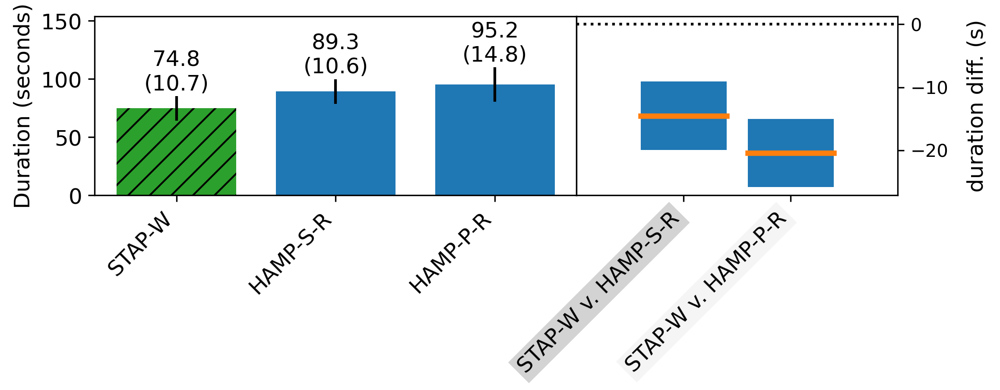

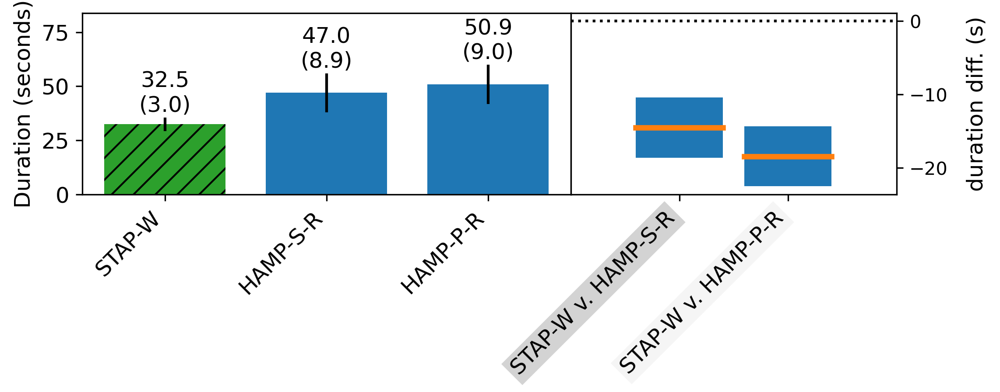

In [9]:
print('tukey task time comparisons, only task 1 and 2 with 3 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['1'] = ['2','1','3']
check_methods['2'] = ['2','1','3']
check_methods['3'] = ['1','2','3','4','5']
tasks = ['1','2']
participants = list(np.arange(1,19).astype(str))
# comparisons = [['2','1'],['2','3'],['1','3']]
comparisons = [['2','1'],['2','3']]
reps_per_method=5
test_reps_per_method=5
task_1_2_tukey_time_results = tukey_test('final_times_arr',1)
task_1_2_t_test_time_results = independent_t_test('final_times_arr',1)
n1 = len(task_1_2_tukey_time_results.means['1'].keys())
n2 = len(task_1_2_tukey_time_results.conf_ints['1'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_time_results,1,ax1[0],1)
plot_comparisons(task_1_2_tukey_time_results,1,ax1[1])
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_1_2_tukey_time_results.means['2'].keys())
n2 = len(task_1_2_tukey_time_results.conf_ints['2'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_time_results,2,ax2[0],1)
plot_comparisons(task_1_2_tukey_time_results,2,ax2[1])
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

tukey task time comparisons, only task 2 and 3 with 5 methods
task 2 - 
	SST:15303.600686883088, 
	SSB:974.3586447883572, 
	SSE:18967.011632103502, 
	SST+SSB+SSE:36994.33548751421, 
	TSS:20716.376155842765
task 2 - MST:3825.900171720772, MSB:194.87172895767145, MSE:158.0584302675292
STAP-W - HAMP-S-R:			(-28.0,-10.1)
STAP-W - HAMP-P-R:			(-28.6,-10.6)
STAP-W - HAMP-S-NR:			( -6.2, 11.7)
STAP-W - HAMP-P-NR:			( -8.1,  9.9)
task 3 - 
	SST:14726.51841099828, 
	SSB:151.55133493832545, 
	SSE:20066.45734473254, 
	SST+SSB+SSE:36303.706660942174, 
	TSS:21425.63691500557
task 3 - MST:3681.62960274957, MSB:30.31026698766509, MSE:167.22047787277114
STAP-W - HAMP-S-R:			(-32.7,-14.2)
STAP-W - HAMP-P-R:			(-32.4,-13.9)
STAP-W - HAMP-S-NR:			(-14.5,  4.0)
STAP-W - HAMP-P-NR:			(-14.3,  4.2)


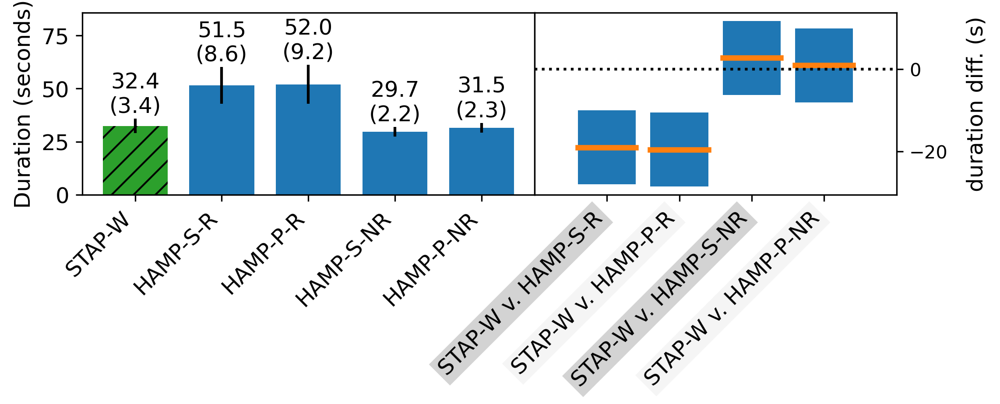

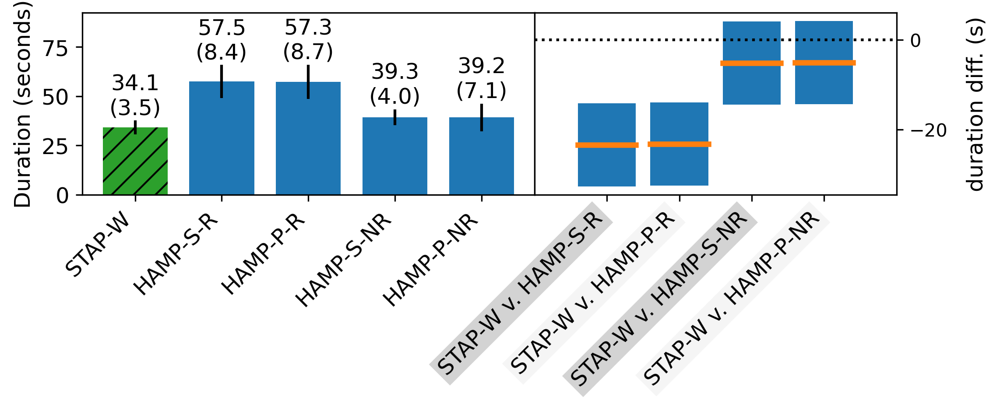

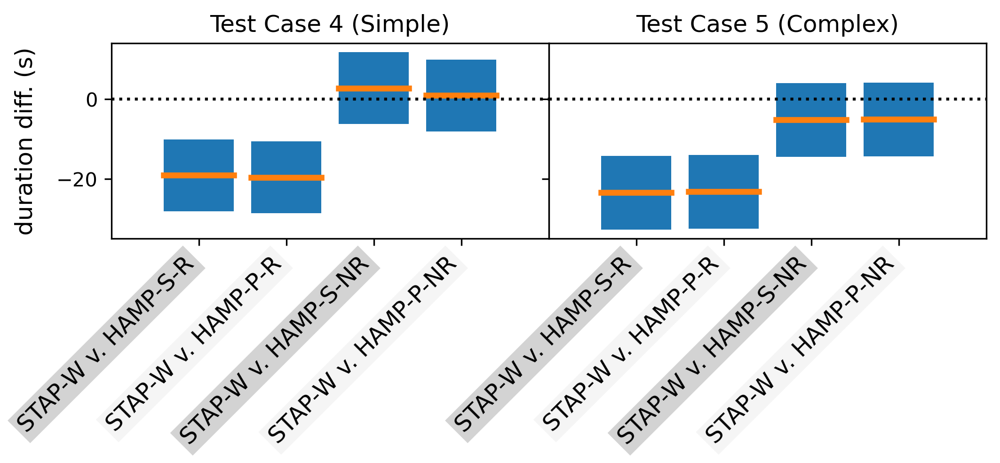

In [10]:
print('tukey task time comparisons, only task 2 and 3 with 5 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5
test_reps_per_method=5#21
task_2_3_tukey_time_results = tukey_test('final_times_arr',1)
n1 = len(task_2_3_tukey_time_results.means['2'].keys())
n2 = len(task_2_3_tukey_time_results.conf_ints['2'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_time_results,2,ax1[0],1)
plot_comparisons(task_2_3_tukey_time_results,2,ax1[1])
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_2_3_tukey_time_results.means['3'].keys())
n2 = len(task_2_3_tukey_time_results.conf_ints['3'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_time_results,3,ax2[0],1)
plot_comparisons(task_2_3_tukey_time_results,3,ax2[1])
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig3, ax3= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_tukey_time_results,2,ax3[0])
plot_comparisons(task_2_3_tukey_time_results,3,ax3[1])
ax3[0].set_ylabel('duration diff. (s)',fontsize=fsize,fontweight=fweight)
ax3[0].yaxis.tick_left()
ax3[0].yaxis.set_label_position("left")
ax3[0].set_title('Test Case 4 (Simple)')
ax3[1].yaxis.tick_left()
ax3[1].set_ylabel('')
ax3[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

timing independent t-test
task 2
STAP-W - HAMP-S-R:			(-20.5,-17.7)
STAP-W - HAMP-P-R:			(-21.0,-18.2)
STAP-W - HAMP-S-NR:			(  1.3,  4.1)
STAP-W - HAMP-P-NR:			( -0.5,  2.3)
task 3
STAP-W - HAMP-S-R:			(-24.9,-21.9)
STAP-W - HAMP-P-R:			(-24.7,-21.7)
STAP-W - HAMP-S-NR:			( -6.7, -3.7)
STAP-W - HAMP-P-NR:			( -6.6, -3.6)


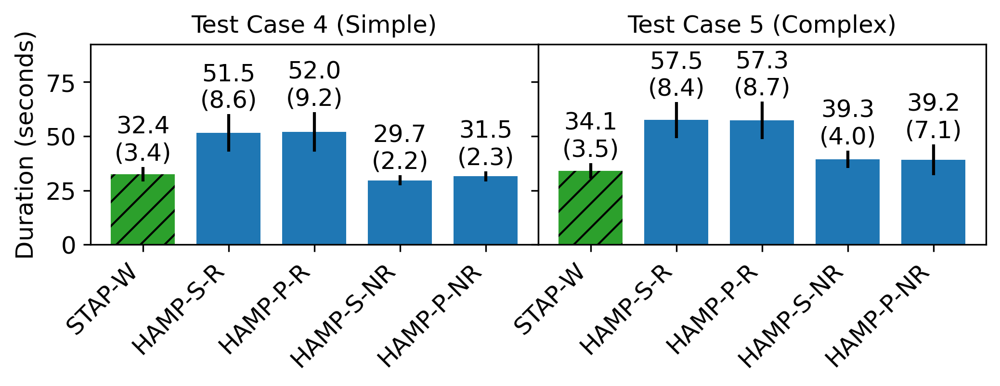

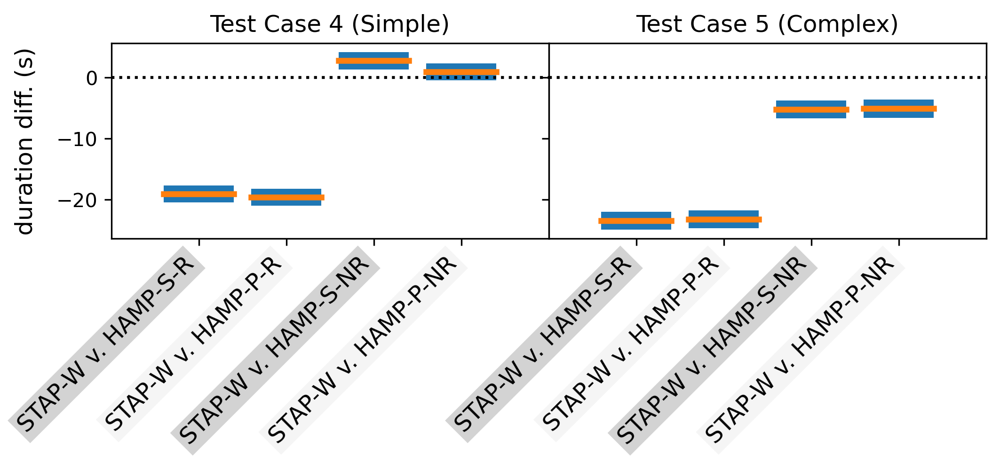

In [11]:
from scipy.stats import t
print('timing independent t-test')
check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
num_trts = 5
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5    
task_2_3_t_test_time_results = independent_t_test('final_times_arr',1)
fig1, ax1= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_durations(task_2_3_t_test_time_results,2,ax1[0],1)
plot_durations(task_2_3_t_test_time_results,3,ax1[1],1)
ax1[1].set_ylabel('')
ax1[0].set_title('Test Case 4 (Simple)')
ax1[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig2, ax2= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_time_results,2,ax2[0])
plot_comparisons(task_2_3_t_test_time_results,3,ax2[1])
ax2[0].set_ylabel('duration diff. (s)',fontsize=fsize,fontweight=fweight)
ax2[0].yaxis.tick_left()
ax2[0].yaxis.set_label_position("left")
ax2[0].set_title('Test Case 4 (Simple)')
ax2[1].yaxis.tick_left()
ax2[1].set_ylabel('')
ax2[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

task 1, method 1, participant 1:4.1
task 1, method 1, participant 10:21.0
task 1, method 1, participant 11:25.0
task 1, method 1, participant 12:32.3
task 1, method 1, participant 13:36.7
task 1, method 1, participant 14:23.3
task 1, method 1, participant 15:29.1
task 1, method 1, participant 16:40.2
task 1, method 1, participant 17:24.8
task 1, method 1, participant 18:41.4
task 1, method 1, participant 19:27.9
task 1, method 1, participant 2:32.7
task 1, method 1, participant 3:33.5
task 1, method 1, participant 4:38.4
task 1, method 1, participant 5:24.2
task 1, method 1, participant 6:30.9
task 1, method 1, participant 7:26.2
task 1, method 1, participant 8:34.6
task 1, method 1, participant 9:32.1
task 1, method 2, participant 1:4.8
task 1, method 2, participant 10:23.7
task 1, method 2, participant 11:8.0
task 1, method 2, participant 12:28.4
task 1, method 2, participant 13:30.4
task 1, method 2, participant 14:26.9
task 1, method 2, participant 15:27.8
task 1, method 2, partici

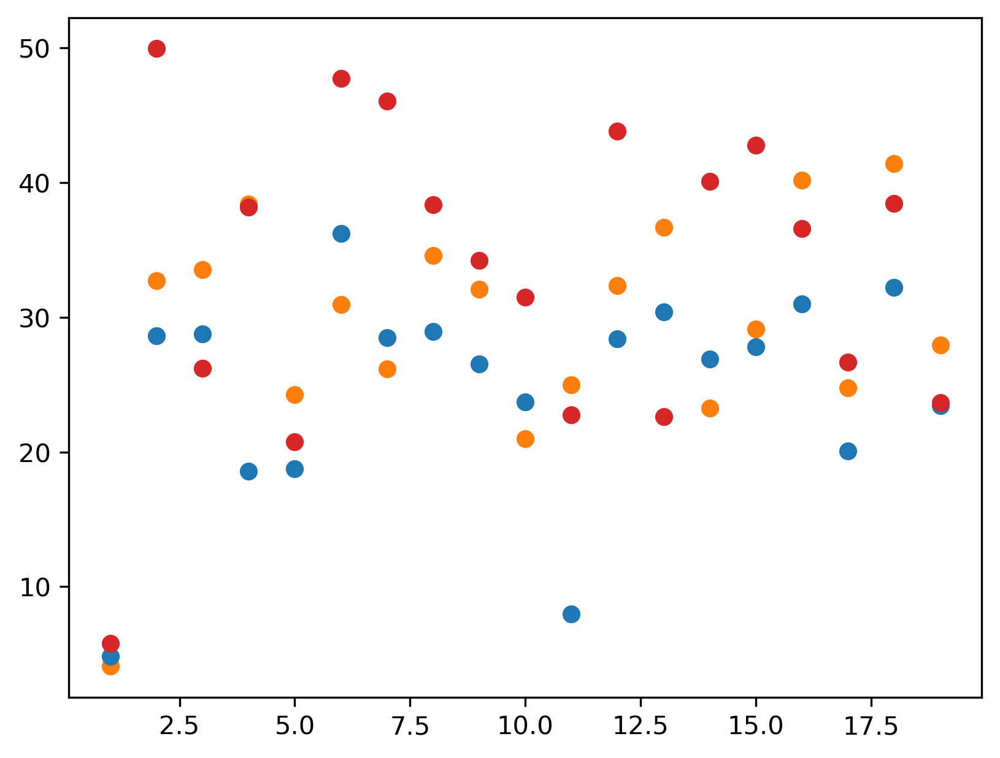

task 2, method 1, participant 1:3.6
task 2, method 1, participant 10:5.7
task 2, method 1, participant 11:18.2
task 2, method 1, participant 12:11.3
task 2, method 1, participant 13:14.4
task 2, method 1, participant 14:9.7
task 2, method 1, participant 15:16.3
task 2, method 1, participant 16:23.1
task 2, method 1, participant 17:14.3
task 2, method 1, participant 18:11.5
task 2, method 1, participant 19:8.9
task 2, method 1, participant 2:10.9
task 2, method 1, participant 3:10.5
task 2, method 1, participant 4:13.1
task 2, method 1, participant 5:9.5
task 2, method 1, participant 6:11.3
task 2, method 1, participant 7:12.4
task 2, method 1, participant 8:10.9
task 2, method 1, participant 9:12.3
task 2, method 2, participant 1:0.4
task 2, method 2, participant 10:0.4
task 2, method 2, participant 11:2.8
task 2, method 2, participant 12:4.1
task 2, method 2, participant 13:6.7
task 2, method 2, participant 14:2.8
task 2, method 2, participant 15:4.5
task 2, method 2, participant 16:9

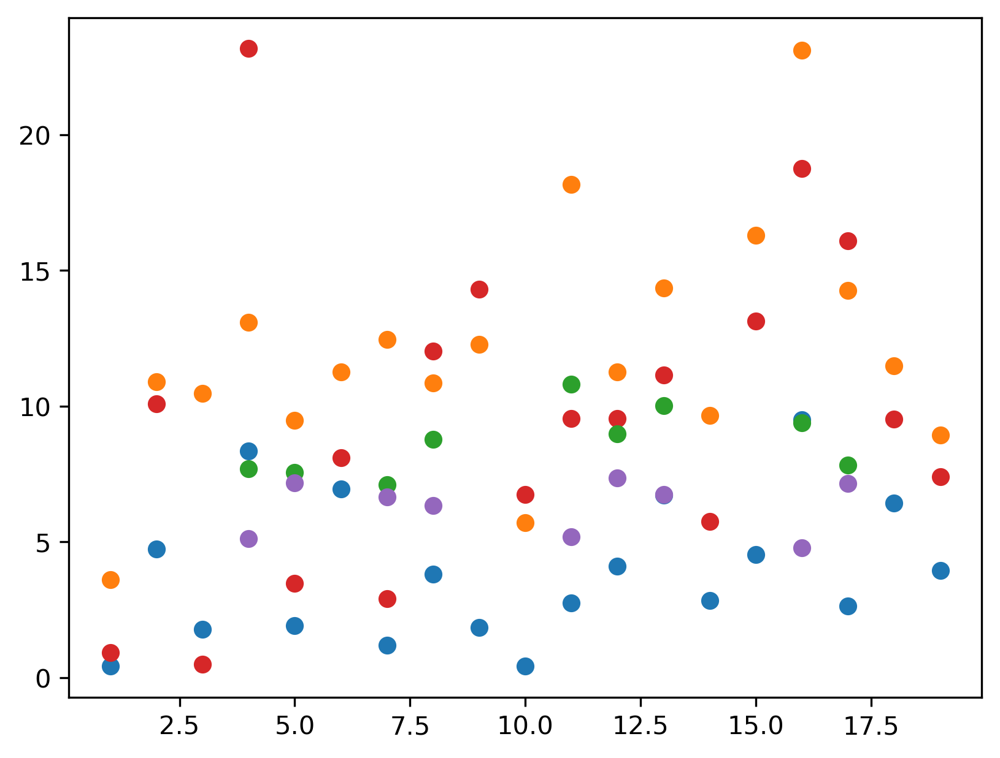

task 3, method 1, participant 12:32.5
task 3, method 1, participant 5:25.0
task 3, method 1, participant 11:33.2
task 3, method 1, participant 17:23.6
task 3, method 1, participant 16:20.1
task 3, method 1, participant 7:26.0
task 3, method 2, participant 12:1.3
task 3, method 2, participant 5:1.6
task 3, method 2, participant 11:3.3
task 3, method 2, participant 17:7.1
task 3, method 2, participant 16:6.0
task 3, method 2, participant 7:2.8
task 3, method 3, participant 12:22.2
task 3, method 3, participant 5:15.6
task 3, method 3, participant 11:18.9
task 3, method 3, participant 17:25.5
task 3, method 3, participant 16:20.2
task 3, method 3, participant 7:18.4
task 3, method 4, participant 12:20.5
task 3, method 4, participant 5:20.2
task 3, method 4, participant 11:18.5
task 3, method 4, participant 17:19.9
task 3, method 4, participant 16:15.3
task 3, method 4, participant 7:21.0
task 3, method 5, participant 12:14.4
task 3, method 5, participant 5:13.1
task 3, method 5, participa

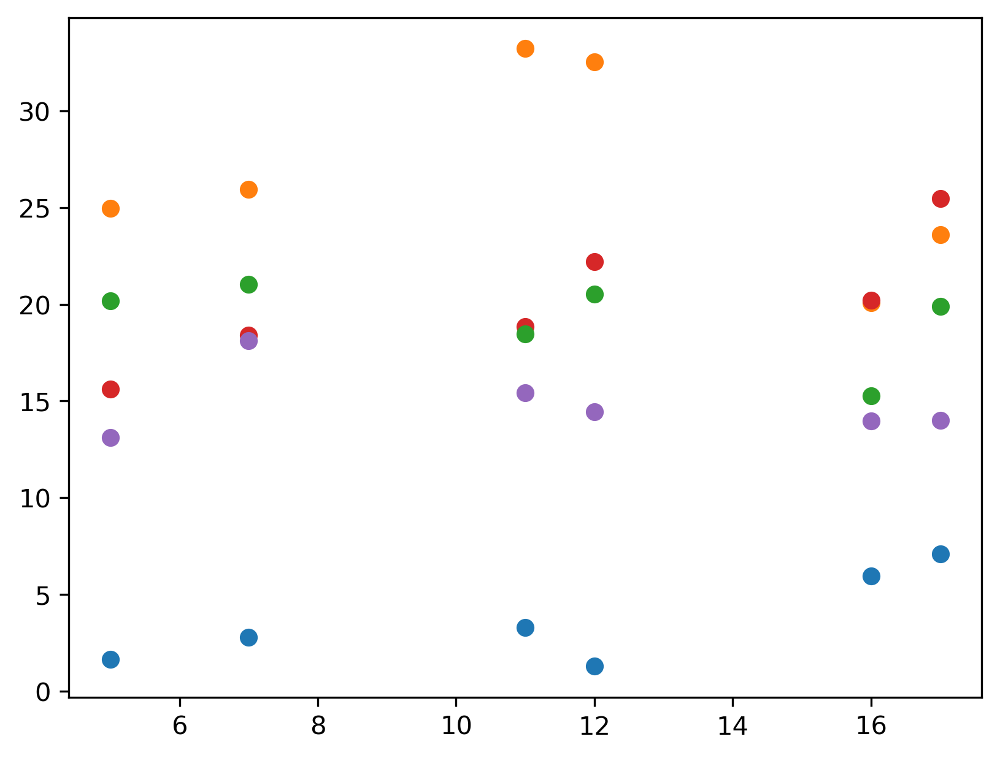

In [12]:
all_data['time_under_0p3m'] = {}
colors = {}
colors['1'] = 'tab:orange'
colors['2'] = 'tab:blue'
colors['3'] = 'tab:red'
colors['4'] = 'tab:green'
colors['5'] = 'tab:purple'

for task in all_data['samples'].keys():
    plt_data = {}
    fig = plt.figure()
    if not task in all_data['time_under_0p3m'].keys():
        all_data['time_under_0p3m'][task] = {}
    for method in all_data['samples'][task].keys(): 
        plt_data[method] = np.empty((2,0))
        if not method in all_data['time_under_0p3m'][task].keys():
            all_data['time_under_0p3m'][task][method] = {}
        for participant in all_data['samples'][task][method].keys():
            all_data['time_under_0p3m'][task][method][participant] = np.empty((0))
            for i in range(len(all_data['samples'][task][method][participant])):
                all_data['time_under_0p3m'][task][method][participant] = np.append(all_data['time_under_0p3m'][task][method][participant],np.sum(all_data['samples'][task][method][participant][i][:,311]<0.3)*(1/30))
            print('task {}, method {}, participant {}:{:.1f}'.format(task,method,participant,np.mean(all_data['time_under_0p3m'][task][method][participant])))
            plt_data[method] = np.append(plt_data[method],np.array([int(participant),np.mean(all_data['time_under_0p3m'][task][method][participant])]).reshape(2,1),axis=1)
        plt.scatter(plt_data[method][0],plt_data[method][1],color=colors[method])
    plt.show()
        
            

task 1, method 1, participant 1:0.5
task 1, method 1, participant 10:0.4
task 1, method 1, participant 11:0.4
task 1, method 1, participant 12:0.4
task 1, method 1, participant 13:0.3
task 1, method 1, participant 14:0.4
task 1, method 1, participant 15:0.4
task 1, method 1, participant 16:0.3
task 1, method 1, participant 17:0.4
task 1, method 1, participant 18:0.3
task 1, method 1, participant 19:0.4
task 1, method 1, participant 2:0.4
task 1, method 1, participant 3:0.4
task 1, method 1, participant 4:0.3
task 1, method 1, participant 5:0.4
task 1, method 1, participant 6:0.4
task 1, method 1, participant 7:0.4
task 1, method 1, participant 8:0.4
task 1, method 1, participant 9:0.4
task 1, method 2, participant 1:0.5
task 1, method 2, participant 10:0.4
task 1, method 2, participant 11:0.5
task 1, method 2, participant 12:0.3
task 1, method 2, participant 13:0.3
task 1, method 2, participant 14:0.4
task 1, method 2, participant 15:0.4
task 1, method 2, participant 16:0.3
task 1, met

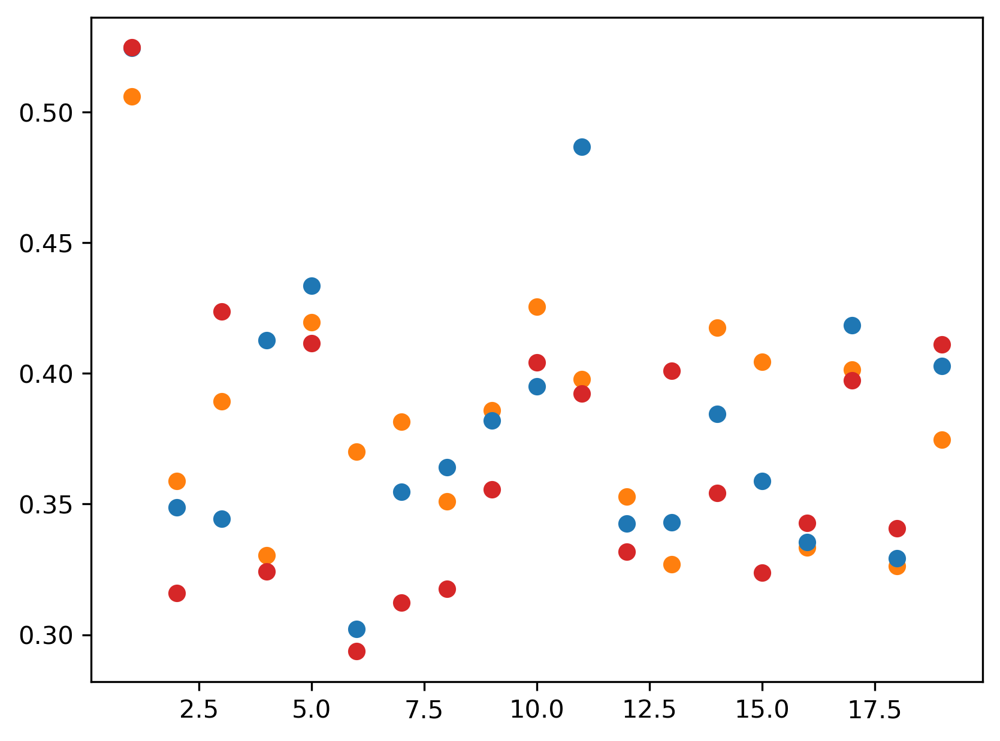

task 2, method 1, participant 1:0.6
task 2, method 1, participant 10:0.5
task 2, method 1, participant 11:0.4
task 2, method 1, participant 12:0.4
task 2, method 1, participant 13:0.4
task 2, method 1, participant 14:0.4
task 2, method 1, participant 15:0.4
task 2, method 1, participant 16:0.3
task 2, method 1, participant 17:0.4
task 2, method 1, participant 18:0.5
task 2, method 1, participant 19:0.5
task 2, method 1, participant 2:0.4
task 2, method 1, participant 3:0.5
task 2, method 1, participant 4:0.4
task 2, method 1, participant 5:0.5
task 2, method 1, participant 6:0.4
task 2, method 1, participant 7:0.4
task 2, method 1, participant 8:0.4
task 2, method 1, participant 9:0.4
task 2, method 2, participant 1:0.6
task 2, method 2, participant 10:0.5
task 2, method 2, participant 11:0.5
task 2, method 2, participant 12:0.5
task 2, method 2, participant 13:0.4
task 2, method 2, participant 14:0.5
task 2, method 2, participant 15:0.4
task 2, method 2, participant 16:0.4
task 2, met

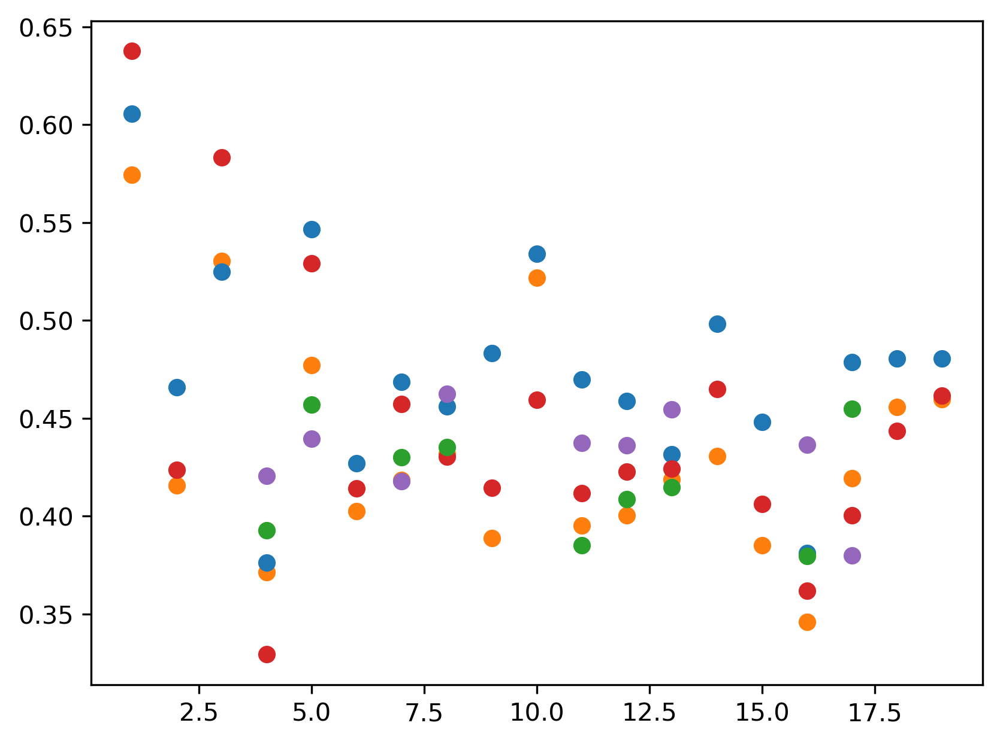

task 3, method 1, participant 12:0.3
task 3, method 1, participant 5:0.3
task 3, method 1, participant 11:0.3
task 3, method 1, participant 17:0.3
task 3, method 1, participant 16:0.4
task 3, method 1, participant 7:0.3
task 3, method 2, participant 12:0.5
task 3, method 2, participant 5:0.5
task 3, method 2, participant 11:0.4
task 3, method 2, participant 17:0.4
task 3, method 2, participant 16:0.4
task 3, method 2, participant 7:0.4
task 3, method 3, participant 12:0.4
task 3, method 3, participant 5:0.4
task 3, method 3, participant 11:0.4
task 3, method 3, participant 17:0.4
task 3, method 3, participant 16:0.3
task 3, method 3, participant 7:0.4
task 3, method 4, participant 12:0.3
task 3, method 4, participant 5:0.3
task 3, method 4, participant 11:0.3
task 3, method 4, participant 17:0.3
task 3, method 4, participant 16:0.3
task 3, method 4, participant 7:0.3
task 3, method 5, participant 12:0.4
task 3, method 5, participant 5:0.4
task 3, method 5, participant 11:0.3
task 3, me

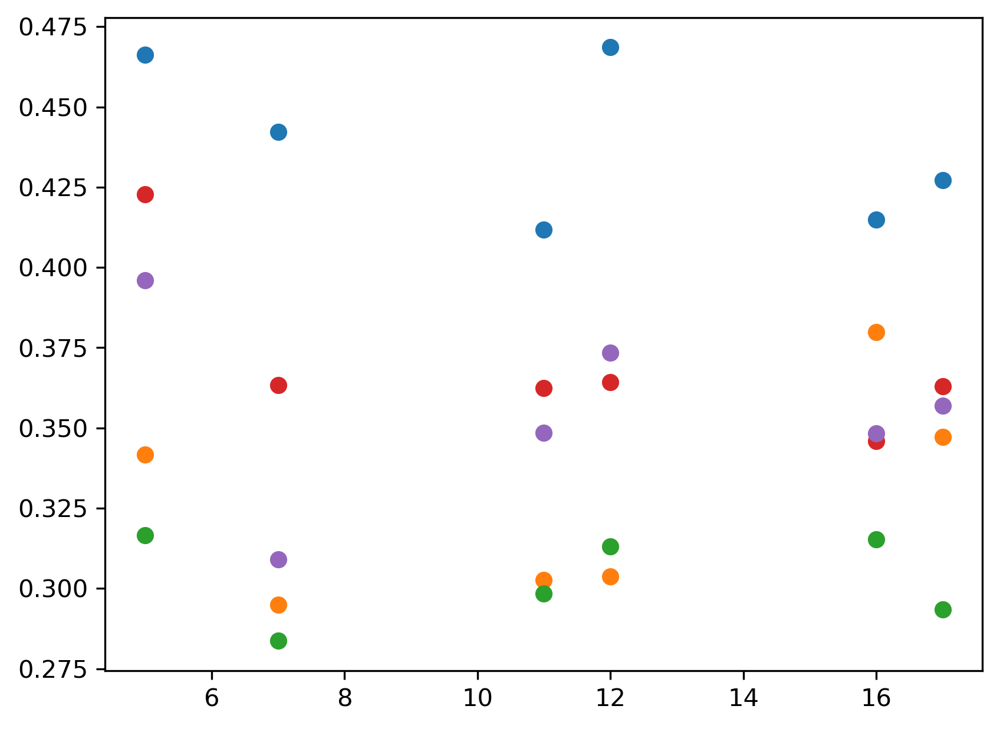

In [13]:
                    
    
all_data['avg_sep'] = {}
colors = {}
colors['1'] = 'tab:orange'
colors['2'] = 'tab:blue'
colors['3'] = 'tab:red'
colors['4'] = 'tab:green'
colors['5'] = 'tab:purple'

for task in all_data['samples'].keys():
    plt_data = {}
    fig = plt.figure()
    if not task in all_data['avg_sep'].keys():
        all_data['avg_sep'][task] = {}
    for method in all_data['samples'][task].keys(): 
        plt_data[method] = np.empty((2,0))
        if not method in all_data['avg_sep'][task].keys():
            all_data['avg_sep'][task][method] = {}
        for participant in all_data['samples'][task][method].keys():
            all_data['avg_sep'][task][method][participant] = np.empty((0))
            for i in range(len(all_data['samples'][task][method][participant])):
                vels = np.linalg.norm(all_data['samples'][task][method][participant][i][:,6:12],axis=1,ord=2)
                tmp_samples = all_data['samples'][task][method][participant][i][:,311]
#                 tmp_samples = tmp_samples[tmp_samples>0]
                all_data['avg_sep'][task][method][participant] = np.append(all_data['avg_sep'][task][method][participant],np.mean(tmp_samples))
            print('task {}, method {}, participant {}:{:.1f}'.format(task,method,participant,np.mean(all_data['avg_sep'][task][method][participant])))
            plt_data[method] = np.append(plt_data[method],np.array([int(participant),np.mean(all_data['avg_sep'][task][method][participant])]).reshape(2,1),axis=1)
        plt.scatter(plt_data[method][0],plt_data[method][1],color=colors[method])
    plt.show()

tukey task average separation distance comparisons, only task 1 and 2 with 3 methods
task 1 - 
	SST:0.01747267247198181, 
	SSB:0.5521642176361894, 
	SSE:0.7846488909110079, 
	SST+SSB+SSE:1.5137349041108052, 
	TSS:0.944098014002634
task 1 - MST:0.008736336235990905, MSB:0.03248024809624644, MSE:0.003632633754217629
STAP-W - HAMP-S-R:			(-0.024,0.019)
STAP-W - HAMP-P-R:			(-0.006,0.037)
task 2 - 
	SST:0.07525867007947795, 
	SSB:0.9443247002047812, 
	SSE:1.4499934637019933, 
	SST+SSB+SSE:2.5664443131912265, 
	TSS:1.5468609429069673
task 2 - MST:0.037629335039738976, MSB:0.05554851177675184, MSE:0.006712932702324043
STAP-W - HAMP-S-R:			(0.011,0.069)
STAP-W - HAMP-P-R:			(-0.001,0.056)
task 1
STAP-W - HAMP-S-R:			(-0.018,0.012)
STAP-W - HAMP-P-R:			(0.001,0.030)
task 2
STAP-W - HAMP-S-R:			(0.024,0.056)
STAP-W - HAMP-P-R:			(0.012,0.043)


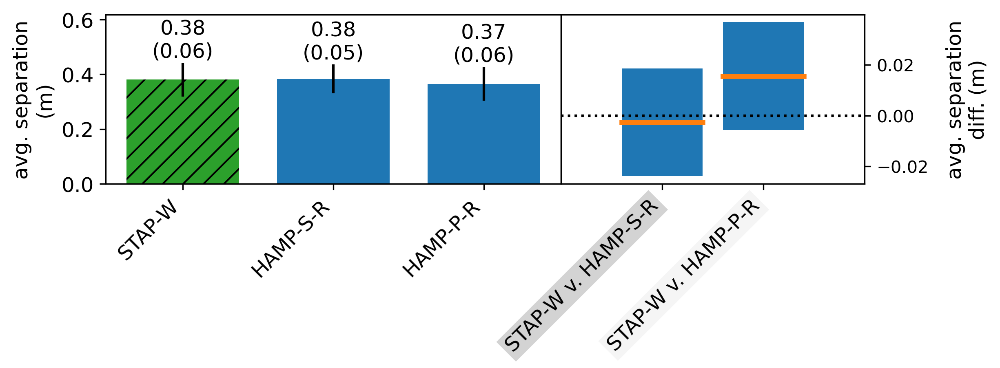

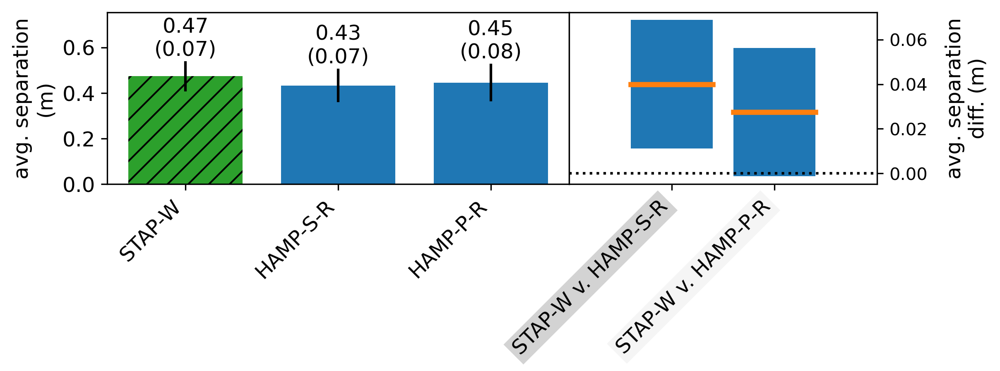

In [14]:
print('tukey task average separation distance comparisons, only task 1 and 2 with 3 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['1'] = ['2','1','3']
check_methods['2'] = ['2','1','3']
check_methods['3'] = ['1','2','3','4','5']
tasks = ['1','2']
participants = list(np.arange(1,19).astype(str))
# comparisons = [['2','1'],['2','3'],['1','3']]
comparisons = [['2','1'],['2','3']]
reps_per_method=5
test_reps_per_method=5
task_1_2_tukey_separation_results = tukey_test('avg_sep',3)
task_1_2_t_test_separation_results = independent_t_test('avg_sep',3)
n1 = len(task_1_2_tukey_separation_results.means['1'].keys())
n2 = len(task_1_2_tukey_separation_results.conf_ints['1'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_separation_results,1,ax1[0],2)
ax1[0].set_ylabel('avg. separation\n(m)',fontsize=fsize,fontweight=fweight)
plot_comparisons(task_1_2_tukey_separation_results,1,ax1[1])
ax1[1].set_ylabel('avg. separation\ndiff. (m)',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_1_2_tukey_separation_results.means['2'].keys())
n2 = len(task_1_2_tukey_separation_results.conf_ints['2'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_separation_results,2,ax2[0],2)
ax2[0].set_ylabel('avg. separation\n(m)',fontsize=fsize,fontweight=fweight)
plot_comparisons(task_1_2_tukey_separation_results,2,ax2[1])
ax2[1].set_ylabel('avg. separation\ndiff. (m)',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

tukey task separation comparisons, only task 2 and 3 with 5 methods
task 2 - 
	SST:0.05653440610306859, 
	SSB:0.1590031263048104, 
	SSE:0.4342286615189046, 
	SST+SSB+SSE:0.7376785844033265, 
	TSS:0.5221410519954475
task 2 - MST:0.014133601525767148, MSB:0.03180062526096208, MSE:0.003618572179324205
STAP-W - HAMP-S-R:			(0.014,0.100)
STAP-W - HAMP-P-R:			(-0.008,0.078)
STAP-W - HAMP-S-NR:			(0.004,0.090)
STAP-W - HAMP-P-NR:			(-0.001,0.085)
task 3 - 
	SST:0.311280846206234, 
	SSB:0.03980946078129577, 
	SSE:0.517789867242012, 
	SST+SSB+SSE:0.9171079847449057, 
	TSS:0.566017677757376
task 3 - MST:0.0778202115515585, MSB:0.007961892156259153, MSE:0.0043149155603501
STAP-W - HAMP-S-R:			(0.063,0.157)
STAP-W - HAMP-P-R:			(0.021,0.115)
STAP-W - HAMP-S-NR:			(0.087,0.181)
STAP-W - HAMP-P-NR:			(0.036,0.130)


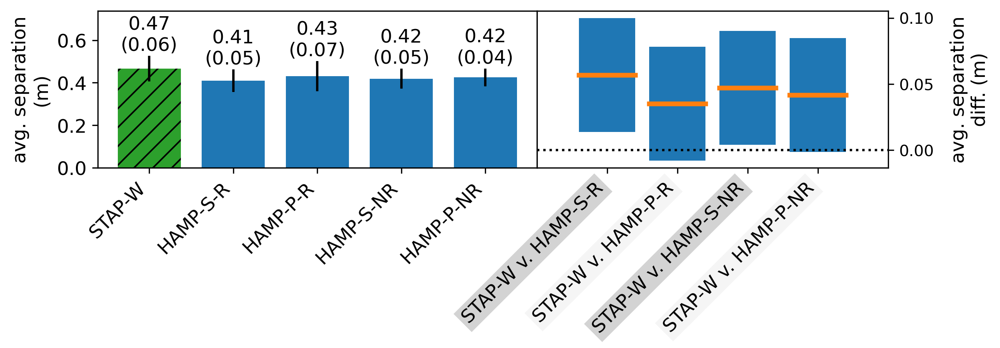

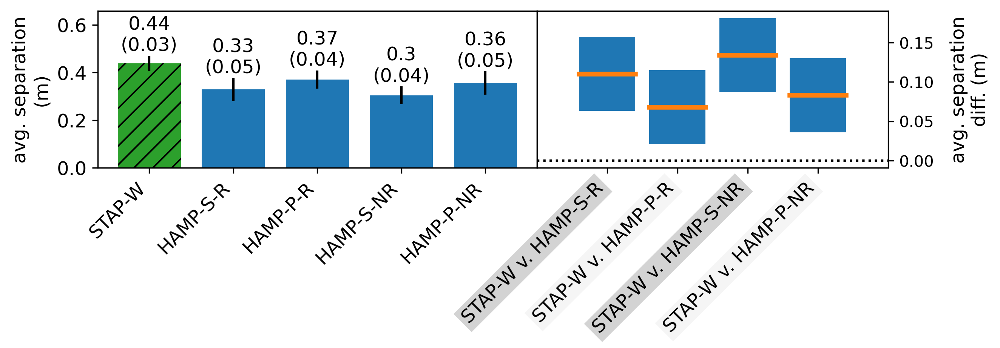

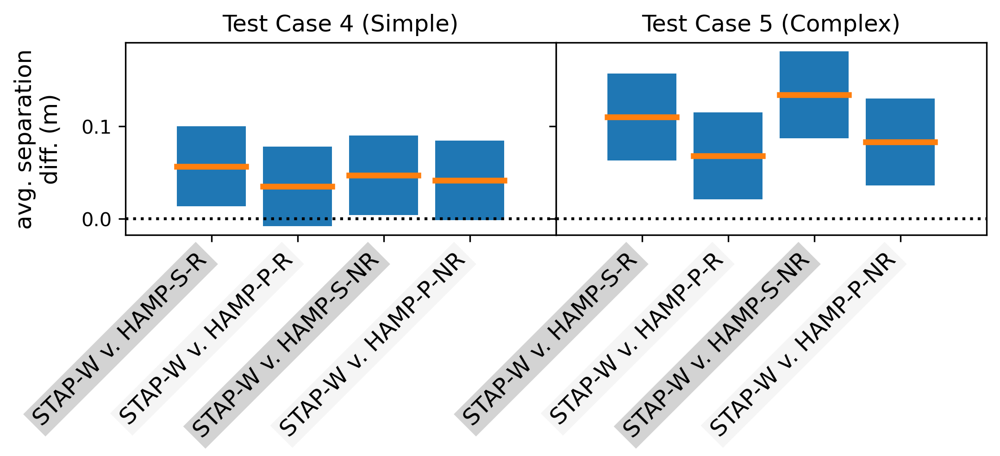

In [15]:
print('tukey task separation comparisons, only task 2 and 3 with 5 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5
test_reps_per_method=5#21
task_2_3_tukey_separation_results = tukey_test('avg_sep',3)
n1 = len(task_2_3_tukey_separation_results.means['2'].keys())
n2 = len(task_2_3_tukey_separation_results.conf_ints['2'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_separation_results,2,ax1[0],2)
ax1[0].set_ylabel('avg. separation\n(m)',fontsize=fsize,fontweight=fweight)
plot_comparisons(task_2_3_tukey_separation_results,2,ax1[1])
ax1[1].set_ylabel('avg. separation\ndiff. (m)',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_2_3_tukey_separation_results.means['3'].keys())
n2 = len(task_2_3_tukey_separation_results.conf_ints['3'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_separation_results,3,ax2[0],2)
ax2[0].set_ylabel('avg. separation\n(m)',fontsize=fsize,fontweight=fweight)
plot_comparisons(task_2_3_tukey_separation_results,3,ax2[1])
ax2[1].set_ylabel('avg. separation\ndiff. (m)',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig3, ax3= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_tukey_separation_results,2,ax3[0])
plot_comparisons(task_2_3_tukey_separation_results,3,ax3[1])
ax3[0].set_ylabel('avg. separation\ndiff. (m)',fontsize=fsize,fontweight=fweight)
ax3[0].yaxis.tick_left()
ax3[0].yaxis.set_label_position("left")
ax3[0].set_title('Test Case 4 (Simple)')
ax3[1].yaxis.tick_left()
ax3[1].set_ylabel('')
ax3[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

avg separation independent t-test
task 2
STAP-W - HAMP-S-R:			(0.032,0.082)
STAP-W - HAMP-P-R:			(0.010,0.060)
STAP-W - HAMP-S-NR:			(0.022,0.072)
STAP-W - HAMP-P-NR:			(0.016,0.067)
task 3
STAP-W - HAMP-S-R:			(0.097,0.123)
STAP-W - HAMP-P-R:			(0.055,0.081)
STAP-W - HAMP-S-NR:			(0.121,0.147)
STAP-W - HAMP-P-NR:			(0.070,0.096)


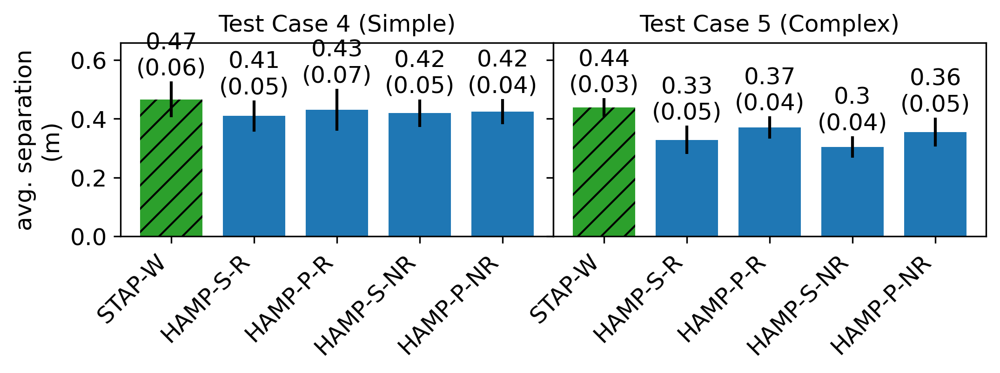

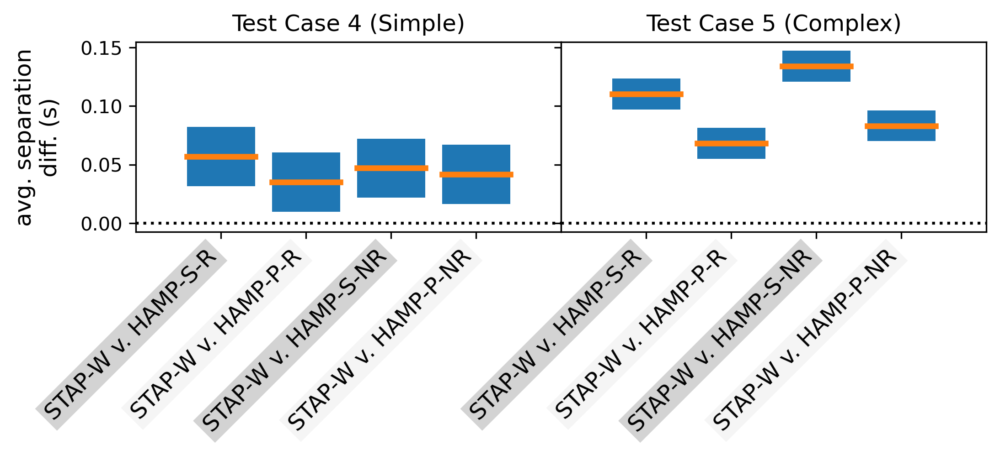

In [16]:
from scipy.stats import t
print('avg separation independent t-test')
check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
num_trts = 5
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5    
task_2_3_t_test_separation_results = independent_t_test('avg_sep',3)
fig1, ax1= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_durations(task_2_3_t_test_separation_results,2,ax1[0],2)
plot_durations(task_2_3_t_test_separation_results,3,ax1[1],2)
ax1[0].set_ylabel('avg. separation\n(m)',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('')
ax1[0].set_title('Test Case 4 (Simple)')
ax1[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig2, ax2= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_separation_results,2,ax2[0])
plot_comparisons(task_2_3_t_test_separation_results,3,ax2[1])
ax2[0].set_ylabel('avg. separation\ndiff. (s)',fontsize=fsize,fontweight=fweight)
ax2[0].yaxis.tick_left()
ax2[0].yaxis.set_label_position("left")
ax2[0].set_title('Test Case 4 (Simple)')
ax2[1].yaxis.tick_left()
ax2[1].set_ylabel('')
ax2[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

tukey task time dist < 0.3m comparisons, only task 1 and 2 with 3 methods
task 1 - 
	SST:3588.8730946502183, 
	SSB:16834.744032921706, 
	SSE:33056.33134979417, 
	SST+SSB+SSE:60216.56279012337, 
	TSS:39792.94566255144
task 1 - MST:1794.4365473251091, MSB:990.2790607601004, MSE:153.0385710638619
STAP-W - HAMP-S-R:			( -8.5,  0.2)
STAP-W - HAMP-P-R:			(-13.3, -4.6)
task 2 - 
	SST:3087.430427983538, 
	SSB:3871.503427983538, 
	SSE:13924.302744855951, 
	SST+SSB+SSE:22481.456246913564, 
	TSS:15522.522390946488
task 2 - MST:1543.715213991769, MSB:227.73549576373753, MSE:64.46436455951829
STAP-W - HAMP-S-R:			(-10.9, -5.2)
STAP-W - HAMP-P-R:			( -8.5, -2.9)
task 1
STAP-W - HAMP-S-R:			( -6.4, -1.9)
STAP-W - HAMP-P-R:			(-11.2, -6.7)
task 2
STAP-W - HAMP-S-R:			( -9.0, -7.1)
STAP-W - HAMP-P-R:			( -6.7, -4.7)


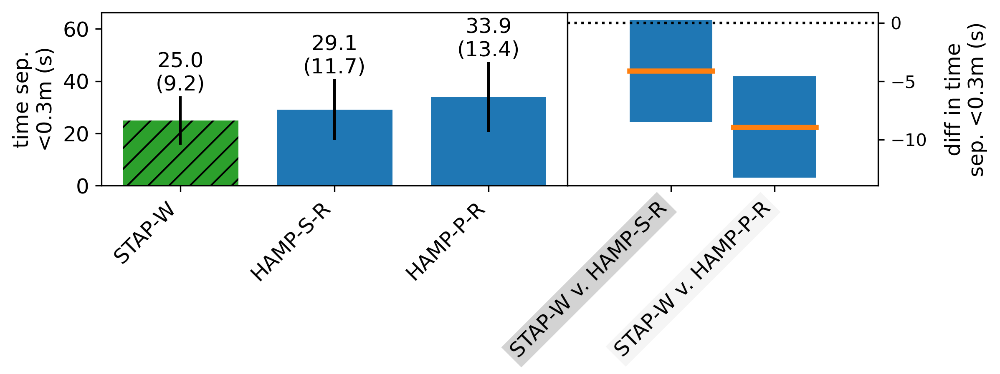

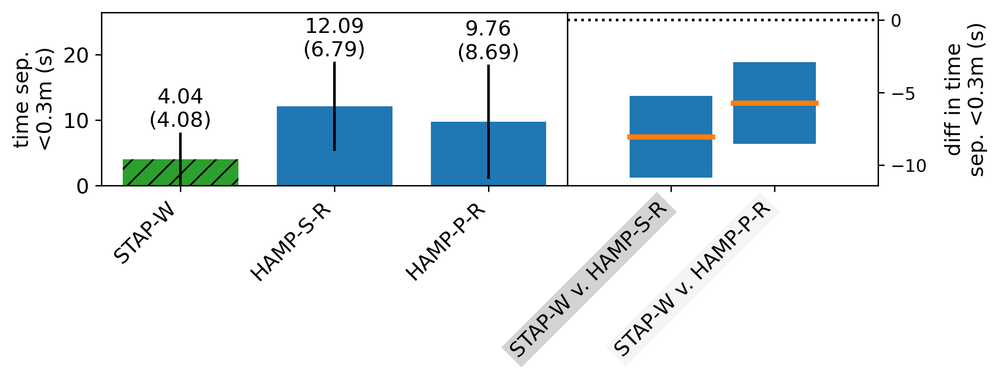

In [17]:
print('tukey task time dist < 0.3m comparisons, only task 1 and 2 with 3 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['1'] = ['2','1','3']
check_methods['2'] = ['2','1','3']
check_methods['3'] = ['1','2','3','4','5']
tasks = ['1','2']
participants = list(np.arange(1,19).astype(str))
# comparisons = [['2','1'],['2','3'],['1','3']]
comparisons = [['2','1'],['2','3']]
reps_per_method=5
test_reps_per_method=5
task_1_2_tukey_tu3_results = tukey_test('time_under_0p3m',1)
task_1_2_t_test_tu3_results = independent_t_test('time_under_0p3m',1)
n1 = len(task_1_2_tukey_tu3_results.means['1'].keys())
n2 = len(task_1_2_tukey_tu3_results.conf_ints['1'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_tu3_results,1,ax1[0],1)
plot_comparisons(task_1_2_tukey_tu3_results,1,ax1[1])
ax1[0].set_ylabel('time sep.\n<0.3m (s)',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in time\nsep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_1_2_tukey_tu3_results.means['2'].keys())
n2 = len(task_1_2_tukey_tu3_results.conf_ints['2'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_tu3_results,2,ax2[0],2)
plot_comparisons(task_1_2_tukey_tu3_results,2,ax2[1])
ax2[0].set_ylabel('time sep.\n<0.3m (s)',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in time\nsep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

tukey task time dist < 0.3m comparisons, only task 2 and 3 with 5 methods
task 2 - 
	SST:2021.0804000000026, 
	SSB:938.3064888888912, 
	SSE:5874.915777777775, 
	SST+SSB+SSE:9939.64928888889, 
	TSS:6980.262399999996
task 2 - MST:505.27010000000064, MSB:187.66129777777823, MSE:48.95763148148146
STAP-W - HAMP-S-R:			(-15.89,-5.88)
STAP-W - HAMP-P-R:			(-11.20,-1.20)
STAP-W - HAMP-S-NR:			(-9.71, 0.29)
STAP-W - HAMP-P-NR:			(-7.49, 2.52)
task 3 - 
	SST:8743.833140740739, 
	SSB:252.06817777777906, 
	SSE:13189.510651851895, 
	SST+SSB+SSE:23239.717051851905, 
	TSS:14243.815733333387
task 3 - MST:2185.9582851851846, MSB:50.413635555555814, MSE:109.91258876543246
STAP-W - HAMP-S-R:			(-30.56,-15.56)
STAP-W - HAMP-P-R:			(-23.95,-8.96)
STAP-W - HAMP-S-NR:			(-23.00,-8.00)
STAP-W - HAMP-P-NR:			(-18.67,-3.68)


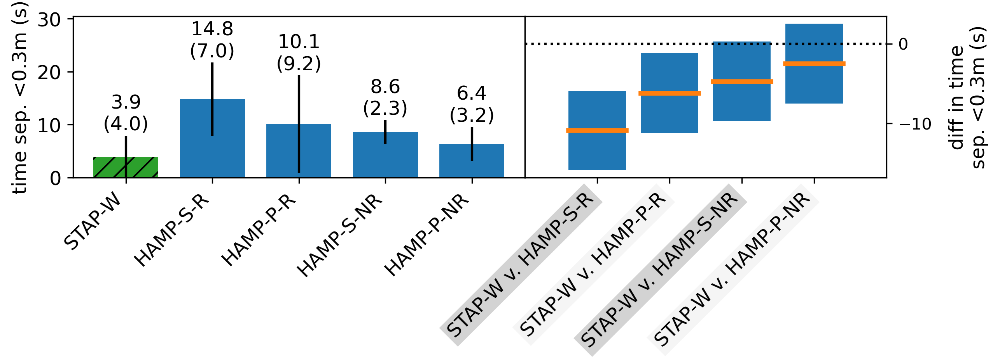

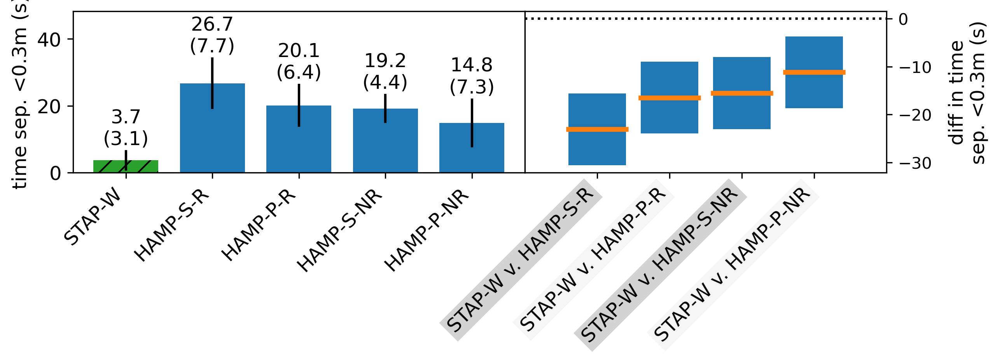

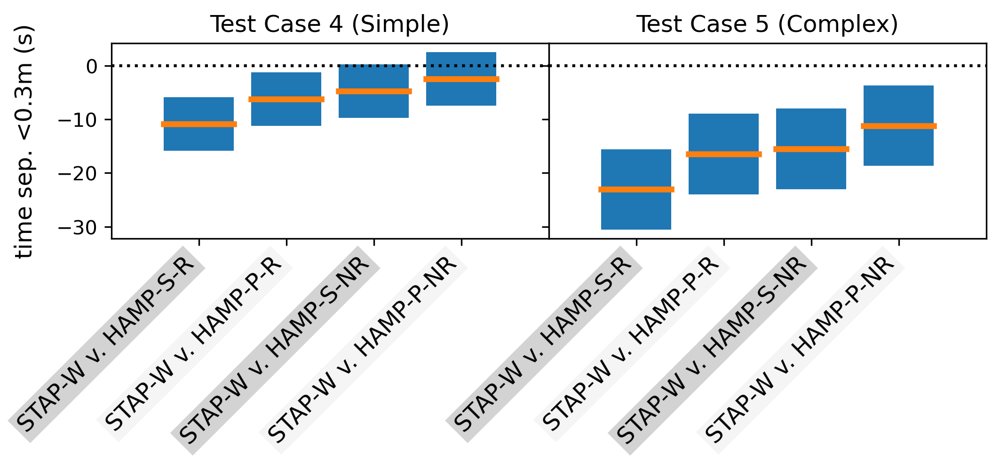

In [18]:
print('tukey task time dist < 0.3m comparisons, only task 2 and 3 with 5 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5
test_reps_per_method=5#21
task_2_3_tukey_tu3_results = tukey_test('time_under_0p3m',2)
n1 = len(task_2_3_tukey_tu3_results.means['2'].keys())
n2 = len(task_2_3_tukey_tu3_results.conf_ints['2'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_tu3_results,2,ax1[0],1)
plot_comparisons(task_2_3_tukey_tu3_results,2,ax1[1])
ax1[0].set_ylabel('time sep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in time\nsep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_2_3_tukey_tu3_results.means['3'].keys())
n2 = len(task_2_3_tukey_tu3_results.conf_ints['3'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_tu3_results,3,ax2[0],1)
plot_comparisons(task_2_3_tukey_tu3_results,3,ax2[1])
ax2[0].set_ylabel('time sep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in time\nsep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig3, ax3= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_tukey_tu3_results,2,ax3[0])
plot_comparisons(task_2_3_tukey_tu3_results,3,ax3[1])
ax3[0].set_ylabel('time sep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
ax3[0].yaxis.tick_left()
ax3[0].yaxis.set_label_position("left")
ax3[0].set_title('Test Case 4 (Simple)')
ax3[1].yaxis.tick_left()
ax3[1].set_ylabel('')
ax3[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

time dist < 0.3m independent t-test
task 2
STAP-W - HAMP-S-R:			(-12.57,-9.20)
STAP-W - HAMP-P-R:			(-7.89,-4.52)
STAP-W - HAMP-S-NR:			(-6.40,-3.03)
STAP-W - HAMP-P-NR:			(-4.17,-0.80)
task 3
STAP-W - HAMP-S-R:			(-24.34,-21.78)
STAP-W - HAMP-P-R:			(-17.74,-15.18)
STAP-W - HAMP-S-NR:			(-16.78,-14.22)
STAP-W - HAMP-P-NR:			(-12.45,-9.89)


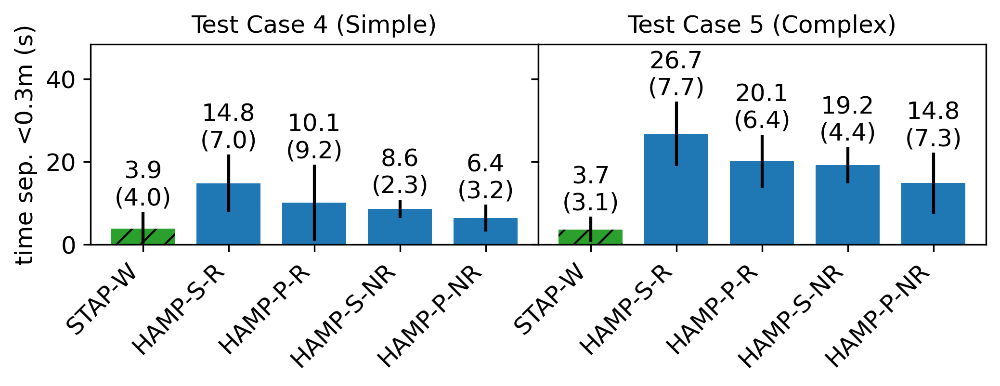

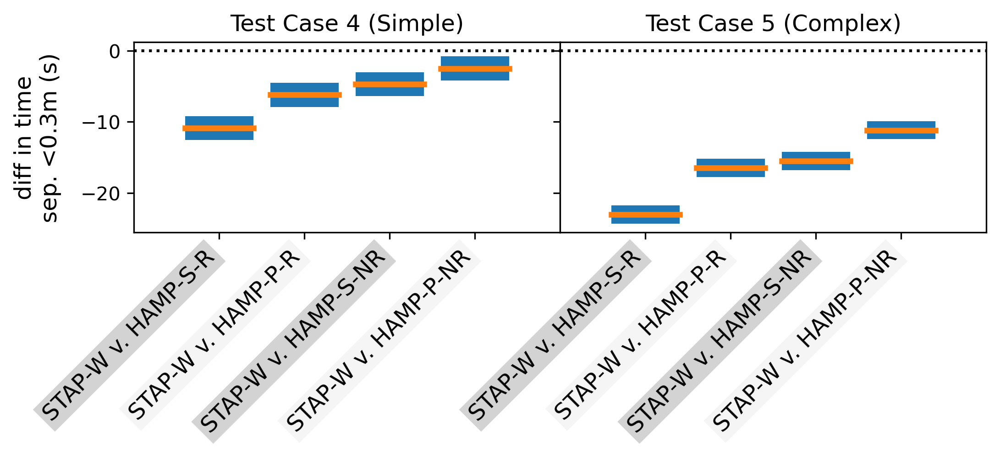

In [19]:
from scipy.stats import t
print('time dist < 0.3m independent t-test')
check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
num_trts = 5
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5    
task_2_3_t_test_tu3_results = independent_t_test('time_under_0p3m',2)
fig1, ax1= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_durations(task_2_3_t_test_tu3_results,2,ax1[0],1)
plot_durations(task_2_3_t_test_tu3_results,3,ax1[1],1)
ax1[0].set_ylabel('time sep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('')
ax1[0].set_title('Test Case 4 (Simple)')
ax1[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig2, ax2= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_tu3_results,2,ax2[0])
plot_comparisons(task_2_3_t_test_tu3_results,3,ax2[1])
ax2[0].set_ylabel('diff in time\nsep. <0.3m (s)',fontsize=fsize,fontweight=fweight)
ax2[0].yaxis.tick_left()
ax2[0].yaxis.set_label_position("left")
ax2[0].set_title('Test Case 4 (Simple)')
ax2[1].yaxis.tick_left()
ax2[1].set_ylabel('')
ax2[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

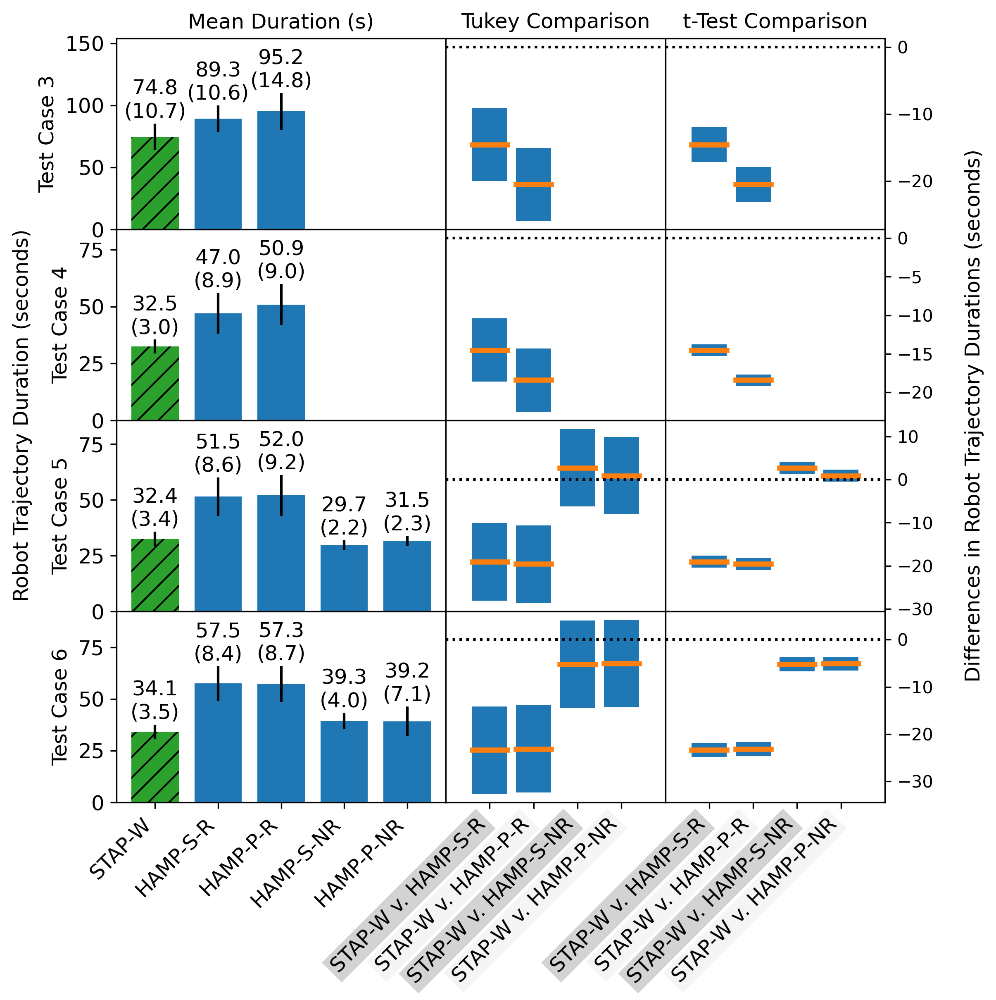

In [20]:
fig, ax= plt.subplots(4,3,sharey=False,sharex='col',figsize=(8, 8),gridspec_kw={'width_ratios': [6, 4,4]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_time_results,1,ax[0,0],1)
plot_durations(task_1_2_tukey_time_results,2,ax[1,0],1)
plot_durations(task_2_3_tukey_time_results,2,ax[2,0],1)
plot_durations(task_2_3_tukey_time_results,3,ax[3,0],1)
plot_comparisons(task_1_2_tukey_time_results,1,ax[0,1])
plot_comparisons(task_1_2_tukey_time_results,2,ax[1,1])
plot_comparisons(task_2_3_tukey_time_results,2,ax[2,1])
plot_comparisons(task_2_3_tukey_time_results,3,ax[3,1])
plot_comparisons(task_1_2_t_test_time_results,1,ax[0,2])
plot_comparisons(task_1_2_t_test_time_results,2,ax[1,2])
plot_comparisons(task_2_3_t_test_time_results,2,ax[2,2])
plot_comparisons(task_2_3_t_test_time_results,3,ax[3,2])
for i in range(4):
    ylim1 = ax[i,1].get_ylim()
    ylim2 = ax[i,2].get_ylim()
    all_ylim = np.append(ylim1,ylim2)
    ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)])
ax[0,0].set_ylabel('Test Case 3')
ax[1,0].set_ylabel('Test Case 4')
ax[2,0].set_ylabel('Test Case 5')
ax[3,0].set_ylabel('Test Case 6')
ax[0,1].set_ylabel('Test Case 3')
ax[1,1].set_ylabel('Test Case 4')
ax[2,1].set_ylabel('Test Case 5')
ax[3,1].set_ylabel('Test Case 6')
ax[0,0].set_title('Mean Duration (s)')
ax[0,1].set_title('Tukey Comparison')
ax[0,2].set_title('t-Test Comparison')
ax[0,2].set_ylabel('')
ax[1,2].set_ylabel('')
ax[2,2].set_ylabel('')
ax[3,2].set_ylabel('')
# ax[0,2].yaxis.tick_right()
# ax[0,2].axhline(0.0,linestyle=':',color='black')
# ax[1,2].yaxis.tick_right()
# ax[1,2].axhline(0.0,linestyle=':',color='black')
fig.text(0.02, 0.5, 'Robot Trajectory Duration (seconds)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
fig.text(0.98, 0.5, 'Differences in Robot Trajectory Durations (seconds)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

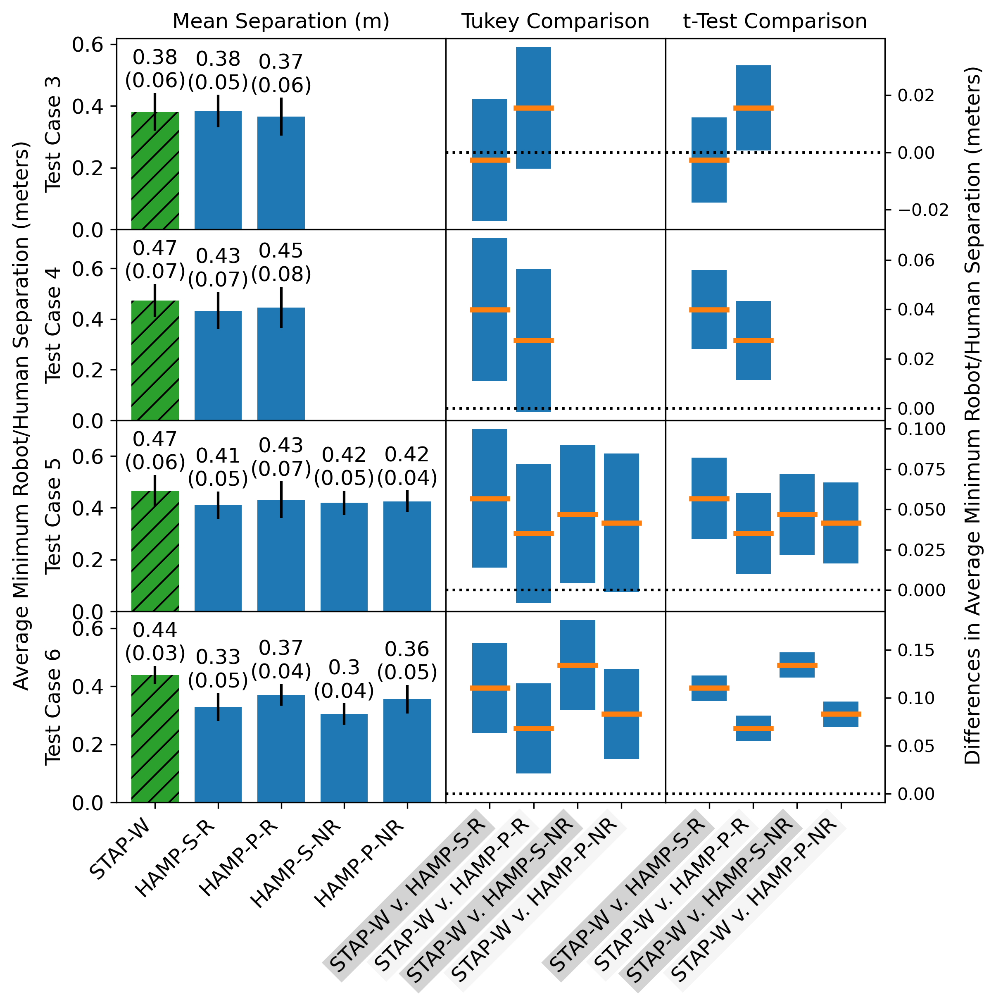

In [22]:
fig, ax= plt.subplots(4,3,sharey=False,sharex='col',figsize=(8, 8),gridspec_kw={'width_ratios': [6, 4,4]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_separation_results,1,ax[0,0],2)
plot_durations(task_1_2_tukey_separation_results,2,ax[1,0],2)
plot_durations(task_2_3_tukey_separation_results,2,ax[2,0],2)
plot_durations(task_2_3_tukey_separation_results,3,ax[3,0],2)
plot_comparisons(task_1_2_tukey_separation_results,1,ax[0,1])
plot_comparisons(task_1_2_tukey_separation_results,2,ax[1,1])
plot_comparisons(task_2_3_tukey_separation_results,2,ax[2,1])
plot_comparisons(task_2_3_tukey_separation_results,3,ax[3,1])
plot_comparisons(task_1_2_t_test_separation_results,1,ax[0,2])
plot_comparisons(task_1_2_t_test_separation_results,2,ax[1,2])
plot_comparisons(task_2_3_t_test_separation_results,2,ax[2,2])
plot_comparisons(task_2_3_t_test_separation_results,3,ax[3,2])
for i in range(4):
    ylim1 = ax[i,1].get_ylim()
    ylim2 = ax[i,2].get_ylim()
    all_ylim = np.append(ylim1,ylim2)
    ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)])
ax[0,0].set_ylabel('Test Case 3')
ax[1,0].set_ylabel('Test Case 4')
ax[2,0].set_ylabel('Test Case 5')
ax[3,0].set_ylabel('Test Case 6')
ax[0,1].set_ylabel('Test Case 3')
ax[1,1].set_ylabel('Test Case 4')
ax[2,1].set_ylabel('Test Case 5')
ax[3,1].set_ylabel('Test Case 6')
ax[0,0].set_title('Mean Separation (m)')
ax[0,1].set_title('Tukey Comparison')
ax[0,2].set_title('t-Test Comparison')
ax[0,2].set_ylabel('')
ax[1,2].set_ylabel('')
ax[2,2].set_ylabel('')
ax[3,2].set_ylabel('')
# ax[0,2].yaxis.tick_right()
# ax[0,2].axhline(0.0,linestyle=':',color='black')
# ax[1,2].yaxis.tick_right()
# ax[1,2].axhline(0.0,linestyle=':',color='black')
fig.text(0.02, 0.5, 'Average Minimum Robot/Human Separation (meters)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
fig.text(0.98, 0.5, 'Differences in Average Minimum Robot/Human Separation (meters)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

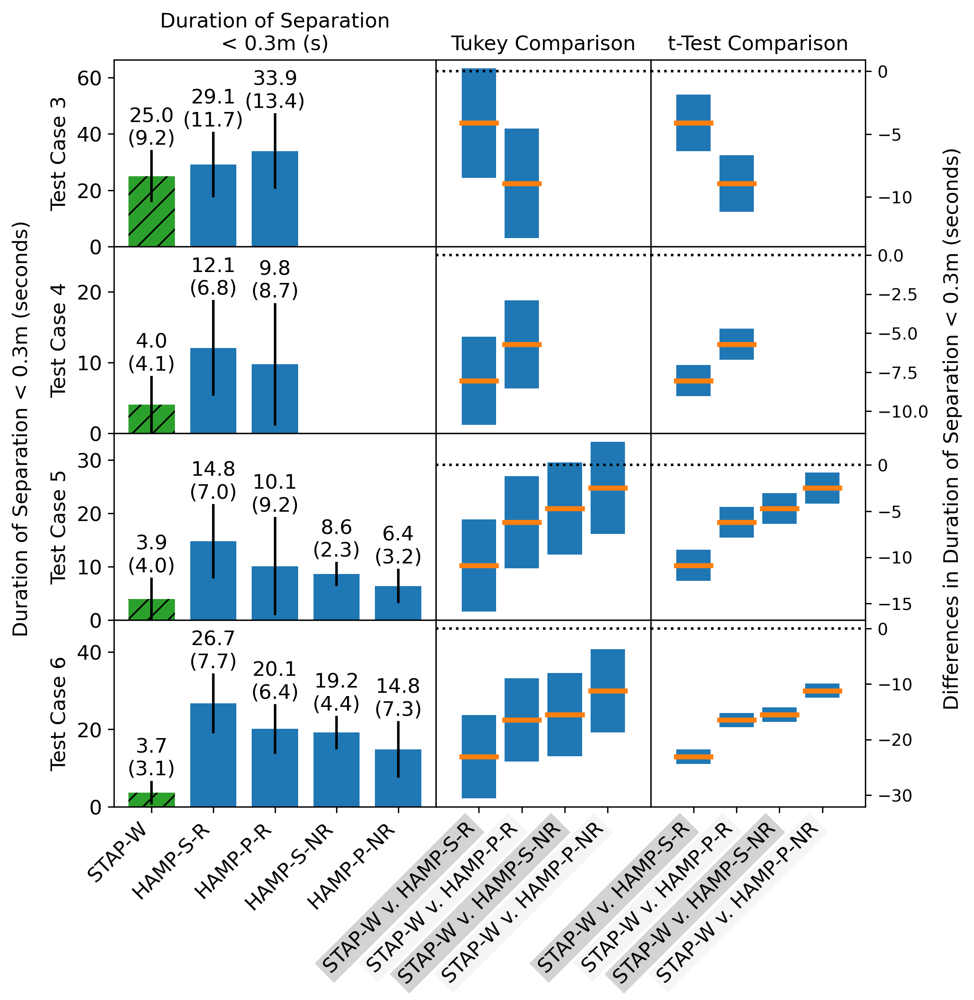

In [21]:
fig, ax= plt.subplots(4,3,sharey=False,sharex='col',figsize=(8, 8),gridspec_kw={'width_ratios': [6, 4,4]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_tu3_results,1,ax[0,0],1)
plot_durations(task_1_2_tukey_tu3_results,2,ax[1,0],1)
plot_durations(task_2_3_tukey_tu3_results,2,ax[2,0],1)
plot_durations(task_2_3_tukey_tu3_results,3,ax[3,0],1)
plot_comparisons(task_1_2_tukey_tu3_results,1,ax[0,1])
plot_comparisons(task_1_2_tukey_tu3_results,2,ax[1,1])
plot_comparisons(task_2_3_tukey_tu3_results,2,ax[2,1])
plot_comparisons(task_2_3_tukey_tu3_results,3,ax[3,1])
plot_comparisons(task_1_2_t_test_tu3_results,1,ax[0,2])
plot_comparisons(task_1_2_t_test_tu3_results,2,ax[1,2])
plot_comparisons(task_2_3_t_test_tu3_results,2,ax[2,2])
plot_comparisons(task_2_3_t_test_tu3_results,3,ax[3,2])
for i in range(4):
    ylim1 = ax[i,1].get_ylim()
    ylim2 = ax[i,2].get_ylim()
    all_ylim = np.append(ylim1,ylim2)
    ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)])
ax[0,0].set_ylabel('Test Case 3')
ax[1,0].set_ylabel('Test Case 4')
ax[2,0].set_ylabel('Test Case 5')
ax[3,0].set_ylabel('Test Case 6')
ax[0,1].set_ylabel('Test Case 3')
ax[1,1].set_ylabel('Test Case 4')
ax[2,1].set_ylabel('Test Case 5')
ax[3,1].set_ylabel('Test Case 6')
ax[0,0].set_title('Duration of Separation\n< 0.3m (s)')
ax[0,1].set_title('Tukey Comparison')
ax[0,2].set_title('t-Test Comparison')
ax[0,2].set_ylabel('')
ax[1,2].set_ylabel('')
ax[2,2].set_ylabel('')
ax[3,2].set_ylabel('')
ax[2,0].set_ylim([0,35])
# ax[0,2].yaxis.tick_right()
# ax[0,2].axhline(0.0,linestyle=':',color='black')
# ax[1,2].yaxis.tick_right()
# ax[1,2].axhline(0.0,linestyle=':',color='black')
fig.text(0.02, 0.5, 'Duration of Separation < 0.3m (seconds)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
fig.text(0.98, 0.5, 'Differences in Duration of Separation < 0.3m (seconds)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

Index(['Participant', 'Shoulders', 'Left Upper Arm', 'Left Forearm',
       'Right Upper Arm', 'Right Forearm', 'Left Elbow Dia', 'Left Wrist Dia',
       'Right Elbow Dia', 'Right Wrist Dia', 'Experience', 't1 m1 a',
       't1 m1 b', 't1 m1 c', 't1 m1 d', 't1 m2 a', 't1 m2 b', 't1 m2 c',
       't1 m2 d', 't1 m3 a', 't1 m3 b', 't1 m3 c', 't1 m3 d', 't2 m1 a',
       't2 m1 b', 't2 m1 c', 't2 m1 d', 't2 m2 a', 't2 m2 b', 't2 m2 c',
       't2 m2 d', 't2 m3 a', 't2 m3 b', 't2 m3 c', 't2 m3 d', 't2 m4 a',
       't2 m4 b', 't2 m4 c', 't2 m4 d', 't2 m5 a', 't2 m5 b', 't2 m5 c',
       't2 m5 d', 't3 m1 a', 't3 m1 b', 't3 m1 c', 't3 m1 d', 't3 m2 a',
       't3 m2 b', 't3 m2 c', 't3 m2 d', 't3 m3 a', 't3 m3 b', 't3 m3 c',
       't3 m3 d', 't3 m4 a', 't3 m4 b', 't3 m4 c', 't3 m4 d', 't3 m5 a',
       't3 m5 b', 't3 m5 c', 't3 m5 d'],
      dtype='object')
0      3
1      2
2      9
3      2
4     10
5      9
6     10
7      8
8      8
9      2
10     7
11     4
12    10
13     3
14     3


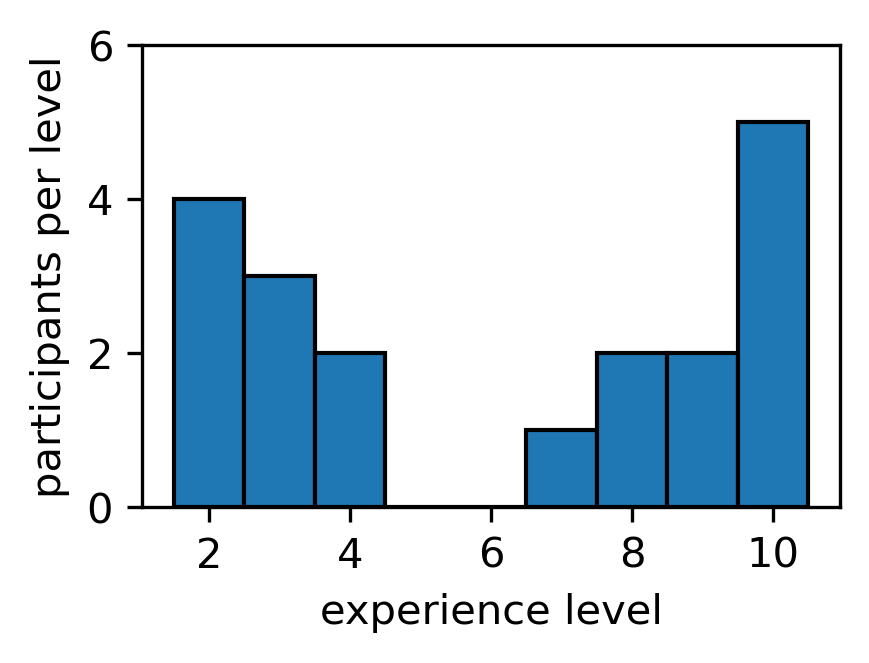

a 1 1 1
a 1 1 2
a 1 1 3
a 1 1 4
a 1 1 5
a 1 1 6
a 1 1 7
a 1 1 8
a 1 1 9
a 1 1 10
a 1 1 11
a 1 1 12
a 1 1 13
a 1 1 14
a 1 1 15
a 1 1 16
a 1 1 17
a 1 1 18
a 1 1 19
b 1 1 1
b 1 1 2
b 1 1 3
b 1 1 4
b 1 1 5
b 1 1 6
b 1 1 7
b 1 1 8
b 1 1 9
b 1 1 10
b 1 1 11
b 1 1 12
b 1 1 13
b 1 1 14
b 1 1 15
b 1 1 16
b 1 1 17
b 1 1 18
b 1 1 19
c 1 1 1
c 1 1 2
c 1 1 3
c 1 1 4
c 1 1 5
c 1 1 6
c 1 1 7
c 1 1 8
c 1 1 9
c 1 1 10
c 1 1 11
c 1 1 12
c 1 1 13
c 1 1 14
c 1 1 15
c 1 1 16
c 1 1 17
c 1 1 18
c 1 1 19
d 1 1 1
d 1 1 2
d 1 1 3
d 1 1 4
d 1 1 5
d 1 1 6
d 1 1 7
d 1 1 8
d 1 1 9
d 1 1 10
d 1 1 11
d 1 1 12
d 1 1 13
d 1 1 14
d 1 1 15
d 1 1 16
d 1 1 17
d 1 1 18
d 1 1 19
a 1 2 1
a 1 2 2
a 1 2 3
a 1 2 4
a 1 2 5
a 1 2 6
a 1 2 7
a 1 2 8
a 1 2 9
a 1 2 10
a 1 2 11
a 1 2 12
a 1 2 13
a 1 2 14
a 1 2 15
a 1 2 16
a 1 2 17
a 1 2 18
a 1 2 19
b 1 2 1
b 1 2 2
b 1 2 3
b 1 2 4
b 1 2 5
b 1 2 6
b 1 2 7
b 1 2 8
b 1 2 9
b 1 2 10
b 1 2 11
b 1 2 12
b 1 2 13
b 1 2 14
b 1 2 15
b 1 2 16
b 1 2 17
b 1 2 18
b 1 2 19
c 1 2 1
c 1 2 2
c 1 2 3
c 1 

In [22]:
#read in questionare info
import pandas as pd
df = pd.read_csv(os.path.join(os.getcwd(),'participant_questions','participant_questions.csv'))
print(df.columns) 
print(df['Experience'])
fig, axs = plt.subplots(1, 1, figsize=(3,2))
axs.hist(df['Experience'], edgecolor='black',bins=np.arange(2, 12, 1)-0.5)
axs.set_ylabel('participants per level')
axs.set_xlabel('experience level')
axs.set_ylim([0,6])
plt.show()
keys = list(df.keys())
survey_data = {}
for i in range(11,len(keys)):
    key_parts = keys[i].split(' ')
    task = str(key_parts[0][1:])
    method = str(key_parts[1][1:])
    question = key_parts[2]
    if question not in survey_data.keys():
        survey_data[question] = {}
    if task not in survey_data[question].keys():
        survey_data[question][task] = {}
    if method not in survey_data[question][task].keys():
        survey_data[question][task][method] = {}
    for j in range(len(df['Participant'])):
        participant = str(df['Participant'][j])
        print(question,task,method,participant)
        survey_data[question][task][method][participant] = df[keys[i]][j]

with open('survey_data.pkl', 'wb') as f:
    pickle.dump(survey_data, f)
    f.close()

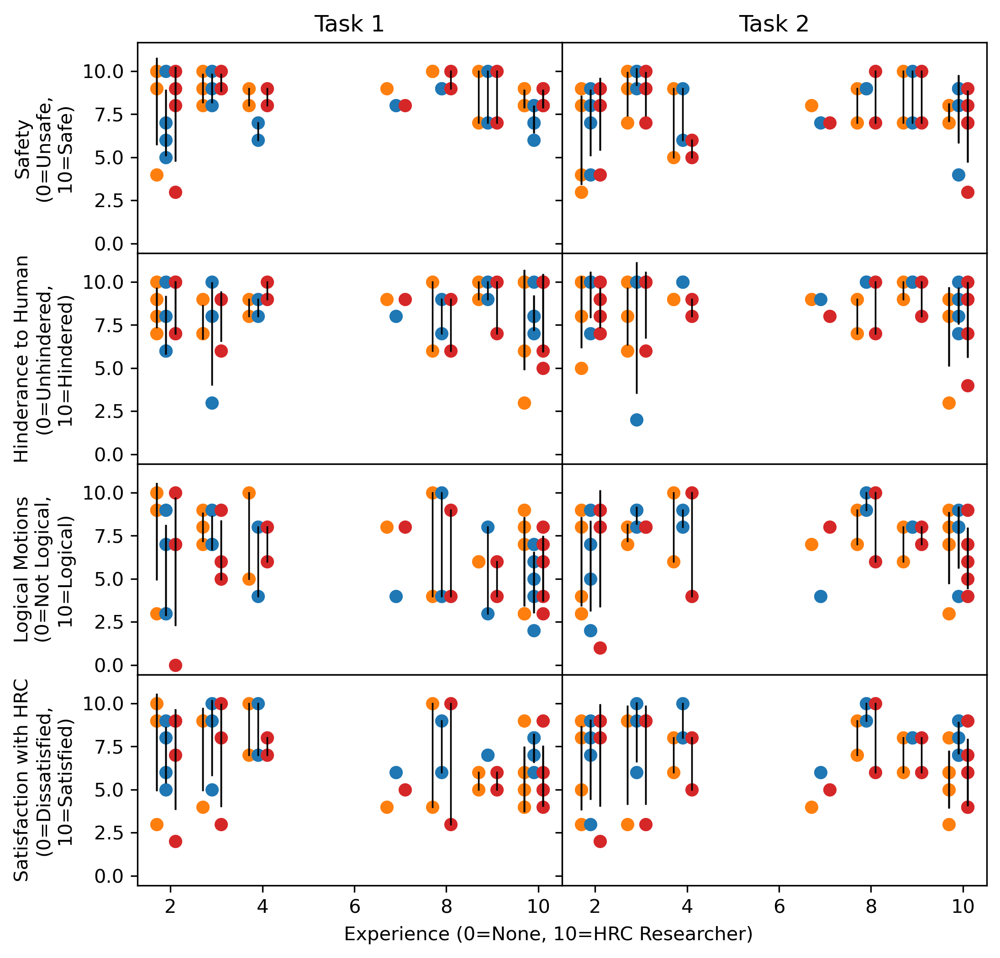

In [23]:
fig, ax= plt.subplots(4,2,sharey=True,sharex=True,figsize=(8, 8))#(5.8, 1.8)
letters = ['a','b','c','d']

colors = ['tab:orange','tab:blue','tab:red','tab:green','tab:purple']
n = np.zeros((4,2,3))
for i in range(4): #question id
    for j in range(2): #task id
        for k in range(3): #method id
            key = 't{} m{} {}'.format(j+1,k+1,letters[i])
            if key in df.keys():
                data = df[key]
                not_is_nan = ~np.isnan(data)
                y = data[not_is_nan]
                x = df['Experience'][not_is_nan]
                n[i,j,k] += len(y)
                ax[i,j].scatter(x+(k-1.5)*0.2,y,color=colors[k])
                for e in x:
                    m = np.mean(y[x==e])
                    v = np.std(y[x==e])
                    ax[i,j].plot([e+(k-1.5)*0.2,e+(k-1.5)*0.2],[m-v,m+v],color='black',linewidth=0.8,zorder=2)
fig.text(0.5, 0.06, 'Experience (0=None, 10=HRC Researcher)', ha='center')
ax[0,0].set_title('Task 1')
ax[0,1].set_title('Task 2')
# ax[0,2].set_title('Task 3')
ax[0,0].set_ylabel('Safety\n(0=Unsafe,\n10=Safe)')
ax[1,0].set_ylabel('Hinderance to Human\n(0=Unhindered,\n10=Hindered)')
ax[2,0].set_ylabel('Logical Motions\n(0=Not Logical,\n10=Logical)')
ax[3,0].set_ylabel('Satisfaction with HRC\n(0=Dissatisfied,\n10=Satisfied)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

In [24]:
def tukey_test_survey_results(question,dec_pts):
    results = stats_results()
    results.tasks = tasks
    results.methods = check_methods
    results.comparisons = comparisons
    results.means = {}
    results.std_devs = {}
    results.conf_ints = {}
    total_samples = {}
    SST = {}
    SSB = {}
    SSE = {}
    MST = {}
    MSB = {}
    MSE = {}
    Yavg = {}
    Ytrt = {}
    Yblk = {}
    Yall = {}
    n_tot = {}
    n_blocks = {}
    n_block = {}
    n_trts = {}
    TSS = {}
    SS_sum = {}
    ci = {}
    HSD = {}
    std_devs = {}
    means = {}
    for task in tasks:
        SST[task]= 0 
        SSB[task]= 0 
        SSE[task]= 0 
        Yavg[task] = {}
        Ytrt[task] = {}
        Yblk[task] = {}
        Yall[task] = 0
        n_tot[task] = 0
        n_blocks[task] = {}
        n_trts[task] = 0
        TSS[task] = 0
        SS_sum[task] = 0
        n_block[task] = 0
        results.conf_ints[task]  ={}
        HSD[task] = {}
        n2 = 0
        results.means[task] = {}
        results.std_devs[task] = {}
        for method in check_methods[task]:
            HSD[task][method] = 0
            n_trts[task] += 1
            n_blocks[task][method] = 0
            Yavg[task][method] = {}
            all_parts_data = np.empty((0))
            for participant in participants:
                n_blocks[task][method] += 1
                n_tot[task]+=1
                n2+=1
                all_parts_data = np.append(all_parts_data,survey_data[question][task][method][participant])
                Yall[task]+=survey_data[question][task][method][participant]
                if not participant in Yblk[task].keys():
                    Yblk[task][participant] = 0
#             print('nb {}:{}'.format(method,n_blocks[task][method]))
            n_block[task] = n_blocks[task][method]
            results.means[task][method] = np.mean(all_parts_data)
            results.std_devs[task][method] = np.std(all_parts_data)
        Yall[task]/=n_tot[task]

    for task in tasks:
        n_blk = {}
        n_trt = {}
        for method in check_methods[task]:
            Ytrt[task][method] = 0
            for participant in participants:
                Ytrt[task][method]+=survey_data[question][task][method][participant]
                if not method in n_trt.keys():
                    n_trt[method] = 0
                n_trt[method]+=1
                Yblk[task][participant]+=survey_data[question][task][method][participant]
                if not participant in n_blk.keys():
                    n_blk[participant] = 0
                n_blk[participant]+=1
            Ytrt[task][method] = Ytrt[task][method]/n_trt[method] #n_blocks[task][method] 
            SST[task]+=n_blocks[task][method]*(Ytrt[task][method]-Yall[task])**2
        for participant in participants:
            Yblk[task][participant]/=n_blk[participant]
            SSB[task]+=n_trts[task]* (Yblk[task][participant]-Yall[task])**2
        for method in check_methods[task]: 
            for participant in participants: 
                SSE[task]+=(survey_data[question][task][method][participant]-Ytrt[task][method]-Yblk[task][participant]+Yall[task])**2
                TSS[task] += (survey_data[question][task][method][participant]-Yall[task])**2
        SS_sum[task] = SST[task] + SSB[task] + SSE[task]
        print('task {} - \n\tSST:{}, \n\tSSB:{}, \n\tSSE:{}, \n\tSST+SSB+SSE:{}, \n\tTSS:{}'.format(task,SST[task],SSB[task],SSE[task],SS_sum[task],TSS[task]))
        MST[task] = SST[task] / (n_trts[task]-1)
        MSB[task] = SSB[task] / (n_block[task]-1)
        MSE[task] = SSE[task] / ((n_trts[task]-1)*(n_block[task]-1))
        print('task {} - MST:{}, MSB:{}, MSE:{}'.format(task,MST[task],MSB[task],MSE[task]))
        q = studentized_range.ppf(0.95, n_trts[task], (n_trts[task]-1)*(n_block[task]-1))
        HSD[task] = q*math.sqrt(MSE[task]/(n_block[task]))
        for i in range(len(comparisons)):
            diff = Ytrt[task][comparisons[i][0]] - Ytrt[task][comparisons[i][1]]
            comparison = '{}:{}'.format(comparisons[i][0],comparisons[i][1])
            results.conf_ints[task][comparison] = {}
            results.conf_ints[task][comparison]['hi'] = diff + HSD[task]
            results.conf_ints[task][comparison]['low'] = diff - HSD[task]
            output_str = '{} - {}:\t'.format(trt_names[comparisons[i][0]],trt_names[comparisons[i][1]])
            tab_stop_number = math.ceil((len(output_str))/8)
            while tab_stop_number<5:
                output_str += '\t'
                tab_stop_number += 1
            output_str += '({},{})'.format(format_num_str(results.conf_ints[task][comparison]['low'],'{{:>5.{}f}}'.format(dec_pts),dec_pts),format_num_str(results.conf_ints[task][comparison]['hi'],'{{:>5.{}f}}'.format(dec_pts),dec_pts))
            print(output_str)
    return copy.deepcopy(results)

In [25]:
def independent_t_test_survey_results(question,dec_pts):
    results = stats_results()
    results.tasks = tasks
    results.methods = check_methods
    results.comparisons = comparisons
    results.means = {}
    results.std_devs = {}
    results.conf_ints = {}
    n={}
    f_var = {}
    f_mean = {}
    MSE = 0
    for task in tasks:
        print('task {}'.format(task))
        if not task in n.keys():
            n[task] = {}
        if not task in f_var.keys():
            f_var[task] = {}
            f_mean[task] = {}
        results.means[task] = {}
        results.std_devs[task] = {}
        results.conf_ints[task]  ={}
        for method in check_methods[task]:
            if not method in n[task].keys():
                n[task][method] = 0
            if not method in f_var[task].keys():
                f_var[task][method] = 0
                f_mean[task][method] = 0
            all_part_data = np.empty((0))
            for participant in participants:
                n[task][method] += reps_per_method
                all_part_data = np.append(all_part_data,survey_data[question][task][method][participant])
            f_var[task][method] = np.var(all_part_data)
            f_mean[task][method] = np.mean(all_part_data)
            results.means[task][method] = f_mean[task][method]
            results.std_devs[task][method] = np.std(all_part_data)
            MSE+=(reps_per_method*len(participants)-1)*f_var[task][method]
        df = total_samples-num_trts
        MSE = MSE/df
        q = studentized_range.ppf(0.95, num_trts, df) 
        for i in range(len(comparisons)):    
            sp2 = ((n[task][comparisons[i][0]]-1)*f_var[task][comparisons[i][0]]+(n[task][comparisons[i][1]]-1)*f_var[task][comparisons[i][0]])/(n[task][comparisons[i][0]]+n[task][comparisons[i][1]]+2)
            diff = f_mean[task][comparisons[i][0]]-f_mean[task][comparisons[i][1]]
            se = math.sqrt(sp2*(1/n[task][comparisons[i][0]]+1/n[task][comparisons[i][1]]))
            t_obs = diff/se
            t_crit = t.ppf(0.95,n[task][comparisons[i][0]]+n[task][comparisons[i][1]]-2)
            comparison = '{}:{}'.format(comparisons[i][0],comparisons[i][1])
            results.conf_ints[task][comparison] = {}
            results.conf_ints[task][comparison]['hi'] = diff+t_crit*se
            results.conf_ints[task][comparison]['low'] = diff-t_crit*se
            output_str = '{} - {}:\t'.format(trt_names[comparisons[i][0]],trt_names[comparisons[i][1]])
            tab_stop_number = math.ceil((len(output_str))/8)
            while tab_stop_number<5:
                output_str += '\t'
                tab_stop_number += 1
            output_str += '({},{})'.format(format_num_str(results.conf_ints[task][comparison]['low'],'{{:>5.{}f}}'.format(dec_pts),dec_pts),format_num_str(results.conf_ints[task][comparison]['hi'],'{{:>5.{}f}}'.format(dec_pts),dec_pts))
            print(output_str)
    return copy.deepcopy(results)
            

In [26]:
questions = {}
questions['a'] = 'How safe did you feel? (0 is not safe at all, 5 is neutral, 10 is very safe)'
questions['b'] = 'Do you think the robot hindered your motions during the task? (0 is robot completely prevented your motions, 5 is neutral, 10 is robot did not impede you motion)'
questions['c'] = 'Did the robot perform logical motions? (0 is robot motions made no sense to you, 5 is neutral, 10 is robot motions made sense to you)'
questions['d'] = 'What is your overall satisfaction with the HRC task? (0 is you would not work in this HRC cell again, 5 is neutral, 10 is you enjoyed working in this cell with the robot)'

analysis for question a. How safe did you feel? (0 is not safe at all, 5 is neutral, 10 is very safe)
task 1 - 
	SST:9.925925925925931, 
	SSB:94.09259259259261, 
	SSE:18.740740740740748, 
	SST+SSB+SSE:122.75925925925928, 
	TSS:122.75925925925935
task 1 - MST:4.9629629629629655, MSB:5.534858387799566, MSE:0.5511982570806102
STAP-W - HAMP-S-R:			( -1.6, -0.4)
STAP-W - HAMP-P-R:			( -1.4, -0.2)
task 2 - 
	SST:4.9259259259259185, 
	SSB:141.25925925925924, 
	SSE:46.407407407407376, 
	SST+SSB+SSE:192.59259259259255, 
	TSS:192.5925925925925
task 2 - MST:2.4629629629629592, MSB:8.309368191721132, MSE:1.3649237472766875
STAP-W - HAMP-S-R:			( -0.3,  1.6)
STAP-W - HAMP-P-R:			( -0.3,  1.6)
task 1
STAP-W - HAMP-S-R:			( -1.3, -0.7)
STAP-W - HAMP-P-R:			( -1.1, -0.4)
task 2
STAP-W - HAMP-S-R:			(  0.2,  1.1)
STAP-W - HAMP-P-R:			(  0.2,  1.1)


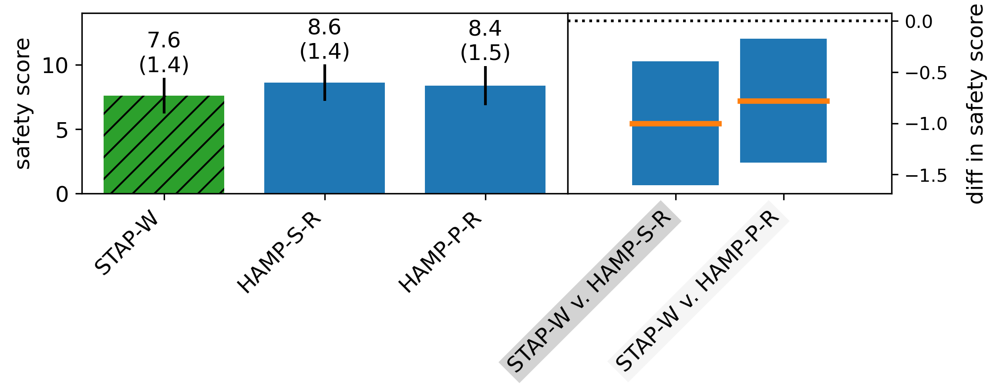

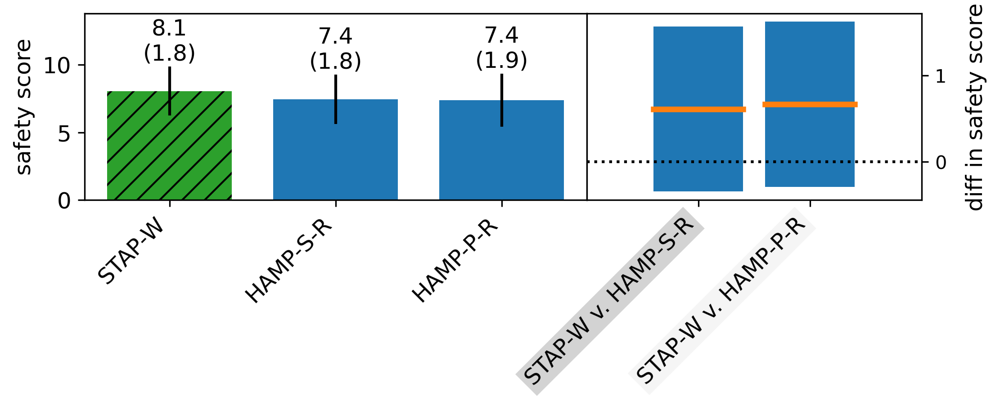

safety questions, only task 2 and 3 with 5 methods
task 2 - 
	SST:11.66666666666667, 
	SSB:54.79999999999999, 
	SSE:37.533333333333346, 
	SST+SSB+SSE:104.0, 
	TSS:104.0
task 2 - MST:2.9166666666666674, MSB:10.959999999999997, MSE:1.8766666666666674
STAP-W - HAMP-S-R:			( -2.5,  2.2)
STAP-W - HAMP-P-R:			( -1.0,  3.7)
STAP-W - HAMP-S-NR:			( -1.4,  3.4)
STAP-W - HAMP-P-NR:			( -1.2,  3.5)
task 3 - 
	SST:21.0, 
	SSB:50.166666666666664, 
	SSE:25.0, 
	SST+SSB+SSE:96.16666666666666, 
	TSS:96.16666666666664
task 3 - MST:5.25, MSB:10.033333333333333, MSE:1.25
STAP-W - HAMP-S-R:			(  0.6,  4.4)
STAP-W - HAMP-P-R:			( -1.3,  2.6)
STAP-W - HAMP-S-NR:			( -0.4,  3.4)
STAP-W - HAMP-P-NR:			( -0.8,  3.1)


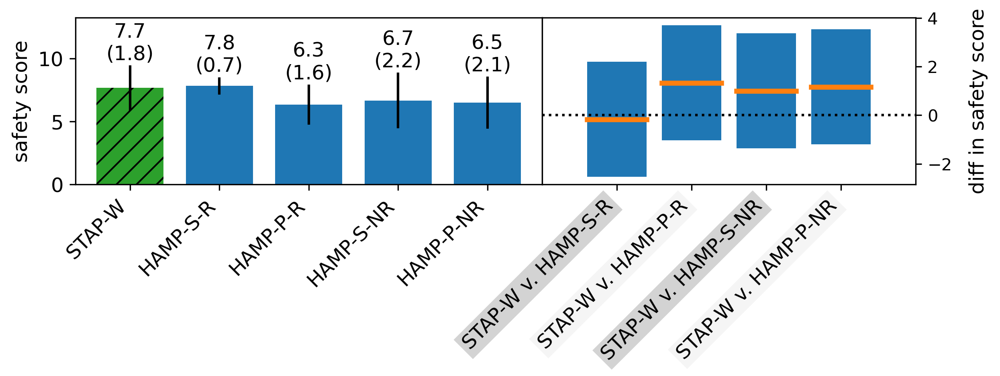

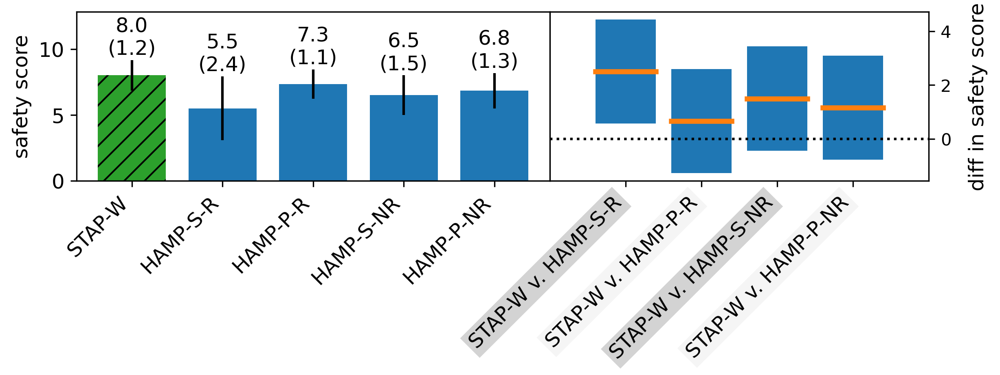

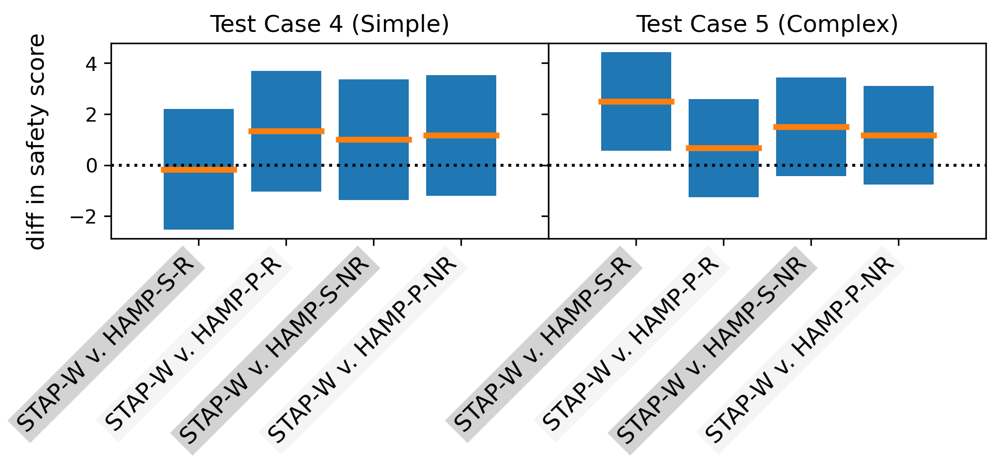

independent t-test
task 2
STAP-W - HAMP-S-R:			( -0.9,  0.6)
STAP-W - HAMP-P-R:			(  0.6,  2.1)
STAP-W - HAMP-S-NR:			(  0.3,  1.7)
STAP-W - HAMP-P-NR:			(  0.4,  1.9)
task 3
STAP-W - HAMP-S-R:			(  2.0,  3.0)
STAP-W - HAMP-P-R:			(  0.2,  1.1)
STAP-W - HAMP-S-NR:			(  1.0,  2.0)
STAP-W - HAMP-P-NR:			(  0.7,  1.6)


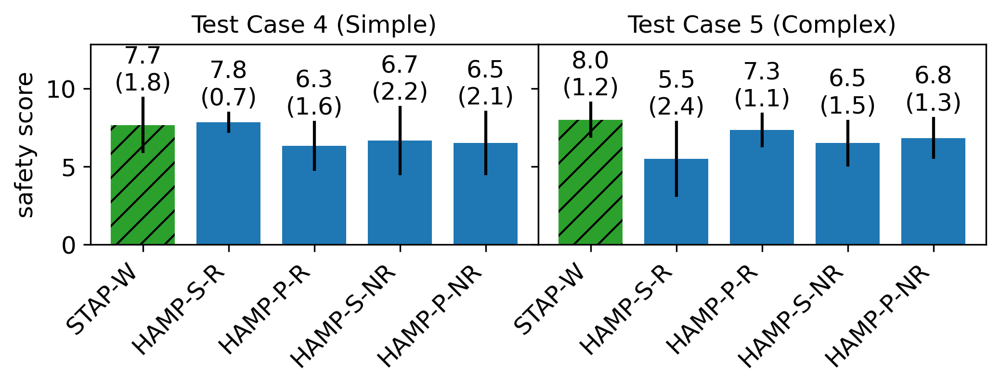

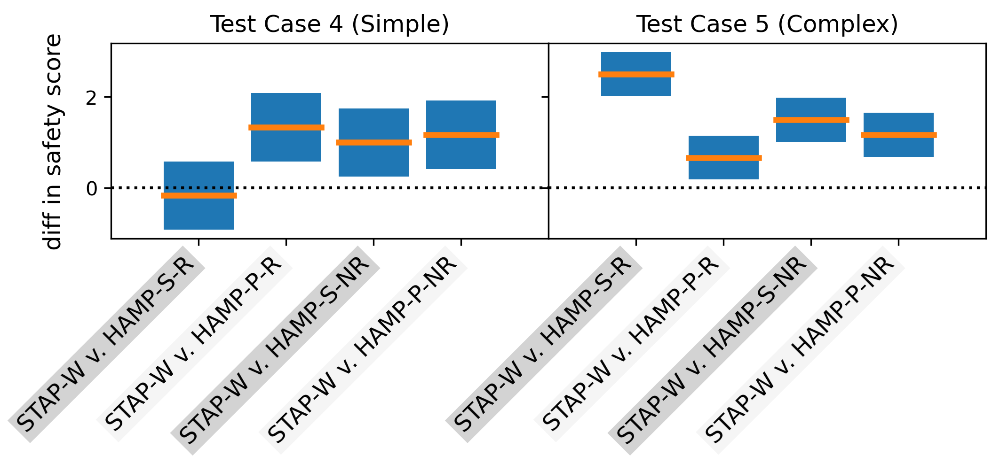

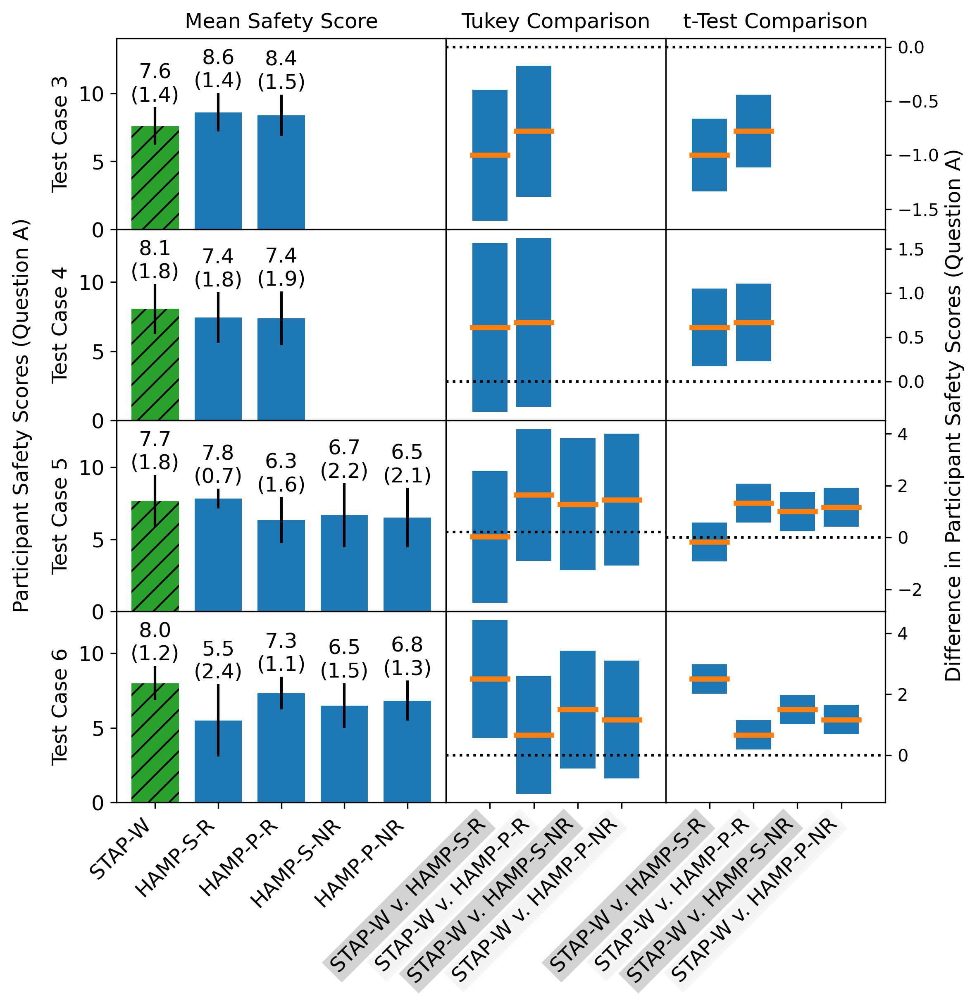

In [27]:
q='a'
print('analysis for question {}. {}'.format(q,questions[q]))
check_methods = {}
check_methods['1'] = ['2','1','3']
check_methods['2'] = ['2','1','3']
check_methods['3'] = ['1','2','3','4','5']
tasks = ['1','2']
participants = list(np.arange(1,19).astype(str))
# comparisons = [['2','1'],['2','3'],['1','3']]
comparisons = [['2','1'],['2','3']]
reps_per_method=5
test_reps_per_method=5
task_1_2_tukey_safety_results = tukey_test_survey_results(q,1)
task_1_2_t_test_safety_results = independent_t_test_survey_results('a',1)
n1 = len(task_1_2_tukey_safety_results.means['1'].keys())
n2 = len(task_1_2_tukey_safety_results.conf_ints['1'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_safety_results,1,ax1[0],1)
plot_comparisons(task_1_2_tukey_safety_results,1,ax1[1])
plt.subplots_adjust(wspace=0, hspace=0.0)
ax1[0].set_ylabel('safety score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in safety score',fontsize=fsize,fontweight=fweight)
plt.show()
n1 = len(task_1_2_tukey_safety_results.means['2'].keys())
n2 = len(task_1_2_tukey_safety_results.conf_ints['2'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_safety_results,2,ax2[0],1)
plot_comparisons(task_1_2_tukey_safety_results,2,ax2[1])
plt.subplots_adjust(wspace=0, hspace=0.0)
ax2[0].set_ylabel('safety score',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in safety score',fontsize=fsize,fontweight=fweight)
plt.show()
print('safety questions, only task 2 and 3 with 5 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5
test_reps_per_method=5#21
task_2_3_tukey_safety_results = tukey_test_survey_results(q,1)
n1 = len(task_2_3_tukey_safety_results.means['2'].keys())
n2 = len(task_2_3_tukey_safety_results.conf_ints['2'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_safety_results,2,ax1[0],1)
plot_comparisons(task_2_3_tukey_safety_results,2,ax1[1])
ax1[0].set_ylabel('safety score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in safety score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_2_3_tukey_safety_results.means['3'].keys())
n2 = len(task_2_3_tukey_safety_results.conf_ints['3'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_safety_results,3,ax2[0],1)
plot_comparisons(task_2_3_tukey_safety_results,3,ax2[1])
ax2[0].set_ylabel('safety score',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in safety score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig3, ax3= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_tukey_safety_results,2,ax3[0])
plot_comparisons(task_2_3_tukey_safety_results,3,ax3[1])
ax3[0].set_ylabel('diff in safety score',fontsize=fsize,fontweight=fweight)
ax3[0].yaxis.tick_left()
ax3[0].yaxis.set_label_position("left")
ax3[0].set_title('Test Case 4 (Simple)')
ax3[1].yaxis.tick_left()
ax3[1].set_ylabel('')
ax3[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
from scipy.stats import t
print('independent t-test')
check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
num_trts = 5
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5    
task_2_3_t_test_safety_results = independent_t_test_survey_results('a',1)
fig1, ax1= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_durations(task_2_3_t_test_safety_results,2,ax1[0],1)
plot_durations(task_2_3_t_test_safety_results,3,ax1[1],1)
ax1[0].set_ylabel('safety score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('')
ax1[0].set_title('Test Case 4 (Simple)')
ax1[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig2, ax2= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_safety_results,2,ax2[0])
plot_comparisons(task_2_3_t_test_safety_results,3,ax2[1])
ax2[0].set_ylabel('diff in safety score',fontsize=fsize,fontweight=fweight)
ax2[0].yaxis.tick_left()
ax2[0].yaxis.set_label_position("left")
ax2[0].set_title('Test Case 4 (Simple)')
ax2[1].yaxis.tick_left()
ax2[1].set_ylabel('')
ax2[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

fig, ax= plt.subplots(4,3,sharey=False,sharex='col',figsize=(8, 8),gridspec_kw={'width_ratios': [6, 4,4]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_safety_results,1,ax[0,0],1)
plot_durations(task_1_2_tukey_safety_results,2,ax[1,0],1)
plot_durations(task_2_3_t_test_safety_results,2,ax[2,0],1)
plot_durations(task_2_3_t_test_safety_results,3,ax[3,0],1)
plot_comparisons(task_1_2_tukey_safety_results,1,ax[0,1])
plot_comparisons(task_1_2_tukey_safety_results,2,ax[1,1])
plot_comparisons(task_2_3_tukey_safety_results,2,ax[2,1])
plot_comparisons(task_2_3_tukey_safety_results,3,ax[3,1])
plot_comparisons(task_1_2_t_test_safety_results,1,ax[0,2])
plot_comparisons(task_1_2_t_test_safety_results,2,ax[1,2])
plot_comparisons(task_2_3_t_test_safety_results,2,ax[2,2])
plot_comparisons(task_2_3_t_test_safety_results,3,ax[3,2])
for i in range(4):
    ylim1 = ax[i,1].get_ylim()
    ylim2 = ax[i,2].get_ylim()
    all_ylim = np.append(ylim1,ylim2)
    if i==2:
        ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)+0.5])
    else:
        ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)])
    ax[i,1].set_yticks([])
ax[0,0].set_ylabel('Test Case 3')
ax[1,0].set_ylabel('Test Case 4')
ax[2,0].set_ylabel('Test Case 5')
ax[3,0].set_ylabel('Test Case 6')
ax[0,1].set_ylabel('Test Case 3')
ax[1,1].set_ylabel('Test Case 4')
ax[2,1].set_ylabel('Test Case 5')
ax[3,1].set_ylabel('Test Case 6')
ax[0,0].set_title('Mean Safety Score')
ax[0,1].set_title('Tukey Comparison')
ax[0,2].set_title('t-Test Comparison')
ax[0,2].set_ylabel('')
ax[1,2].set_ylabel('')
ax[2,2].set_ylabel('')
ax[3,2].set_ylabel('')
# ax[0,2].yaxis.tick_right()
# ax[0,2].axhline(0.0,linestyle=':',color='black')
# ax[1,2].yaxis.tick_right()
# ax[1,2].axhline(0.0,linestyle=':',color='black')
fig.text(0.02, 0.5, 'Participant Safety Scores (Question A)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
fig.text(0.96, 0.5, 'Difference in Participant Safety Scores (Question A)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()


analysis for question b. Do you think the robot hindered your motions during the task? (0 is robot completely prevented your motions, 5 is neutral, 10 is robot did not impede you motion)
task 1 - 
	SST:1.4444444444444449, 
	SSB:117.33333333333337, 
	SSE:44.55555555555555, 
	SST+SSB+SSE:163.33333333333337, 
	TSS:163.33333333333331
task 1 - MST:0.7222222222222224, MSB:6.901960784313728, MSE:1.310457516339869
STAP-W - HAMP-S-R:			( -1.2,  0.7)
STAP-W - HAMP-P-R:			( -1.3,  0.5)
task 2 - 
	SST:7.0000000000000036, 
	SSB:122.0, 
	SSE:50.33333333333331, 
	SST+SSB+SSE:179.33333333333331, 
	TSS:179.3333333333332
task 2 - MST:3.5000000000000018, MSB:7.176470588235294, MSE:1.4803921568627443
STAP-W - HAMP-S-R:			( -0.2,  1.8)
STAP-W - HAMP-P-R:			( -0.3,  1.7)
task 1
STAP-W - HAMP-S-R:			( -0.7,  0.1)
STAP-W - HAMP-P-R:			( -0.8,  0.0)
task 2
STAP-W - HAMP-S-R:			(  0.4,  1.3)
STAP-W - HAMP-P-R:			(  0.2,  1.1)


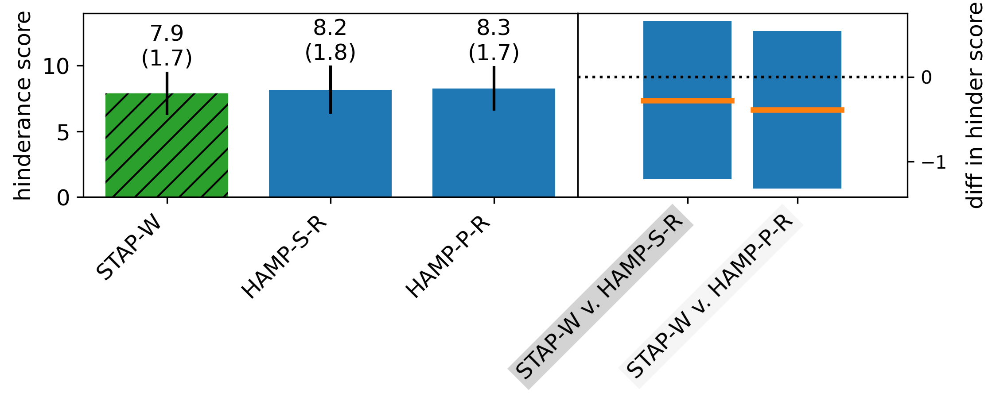

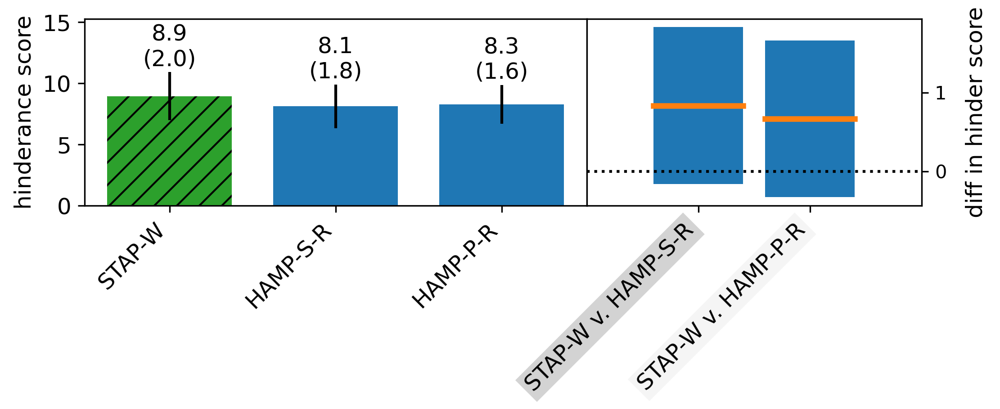

safety questions, only task 2 and 3 with 5 methods
task 2 - 
	SST:13.800000000000008, 
	SSB:47.36666666666666, 
	SSE:43.8, 
	SST+SSB+SSE:104.96666666666667, 
	TSS:104.96666666666664
task 2 - MST:3.450000000000002, MSB:9.473333333333333, MSE:2.19
STAP-W - HAMP-S-R:			( -1.6,  3.6)
STAP-W - HAMP-P-R:			( -1.2,  3.9)
STAP-W - HAMP-S-NR:			( -0.7,  4.4)
STAP-W - HAMP-P-NR:			( -0.7,  4.4)
task 3 - 
	SST:71.4666666666667, 
	SSB:20.799999999999986, 
	SSE:34.533333333333324, 
	SST+SSB+SSE:126.80000000000001, 
	TSS:126.80000000000004
task 3 - MST:17.866666666666674, MSB:4.1599999999999975, MSE:1.7266666666666661
STAP-W - HAMP-S-R:			(  1.1,  5.6)
STAP-W - HAMP-P-R:			(  0.1,  4.6)
STAP-W - HAMP-S-NR:			(  2.4,  6.9)
STAP-W - HAMP-P-NR:			(  0.9,  5.4)


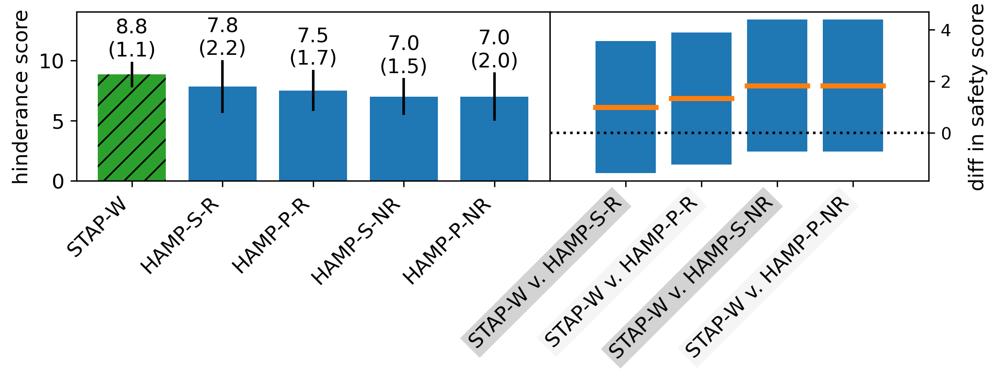

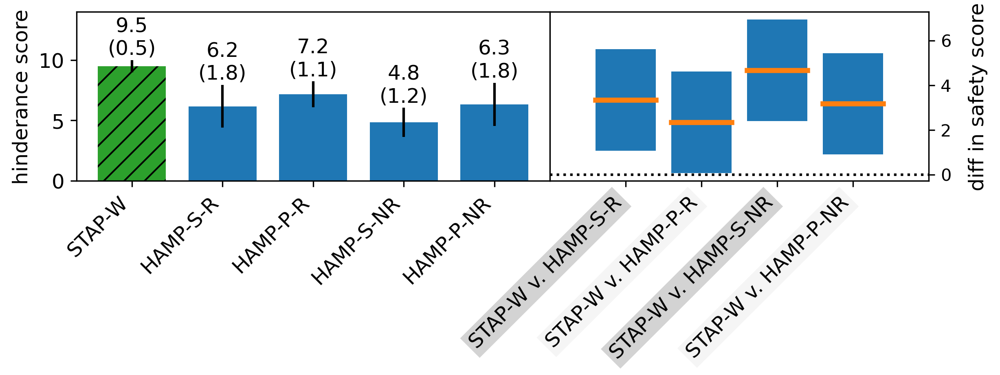

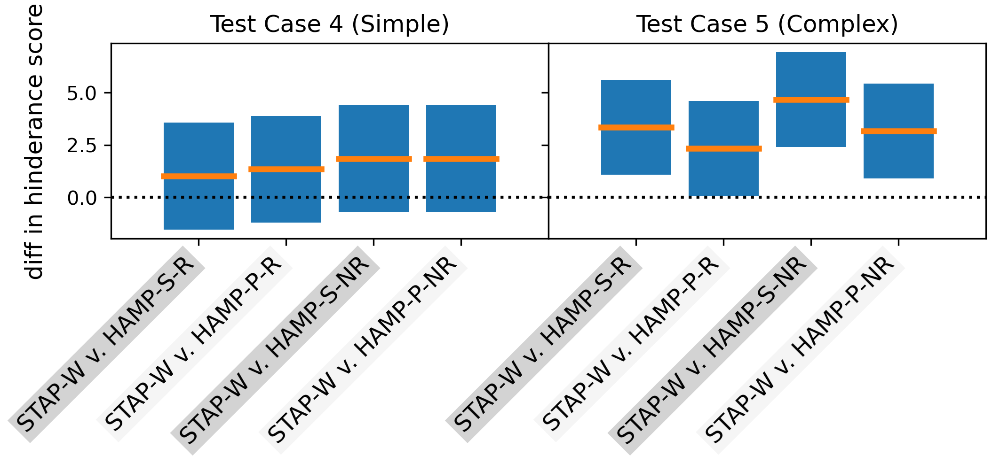

independent t-test
task 2
STAP-W - HAMP-S-R:			(  0.6,  1.4)
STAP-W - HAMP-P-R:			(  0.9,  1.8)
STAP-W - HAMP-S-NR:			(  1.4,  2.3)
STAP-W - HAMP-P-NR:			(  1.4,  2.3)
task 3
STAP-W - HAMP-S-R:			(  3.1,  3.5)
STAP-W - HAMP-P-R:			(  2.1,  2.5)
STAP-W - HAMP-S-NR:			(  4.5,  4.9)
STAP-W - HAMP-P-NR:			(  3.0,  3.4)


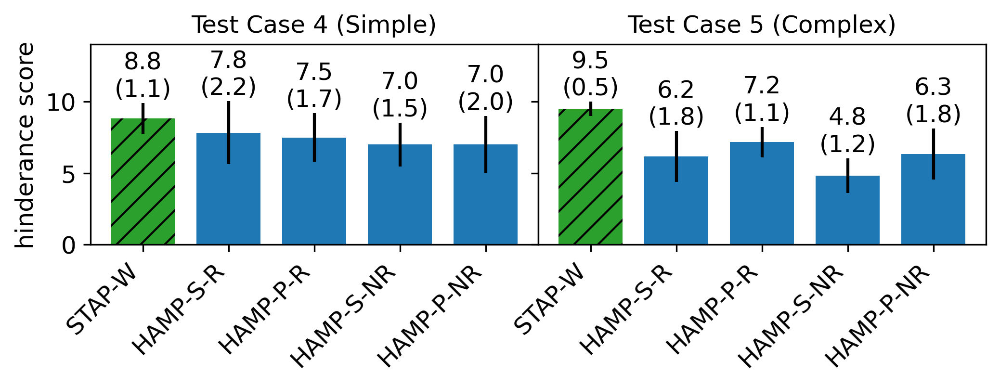

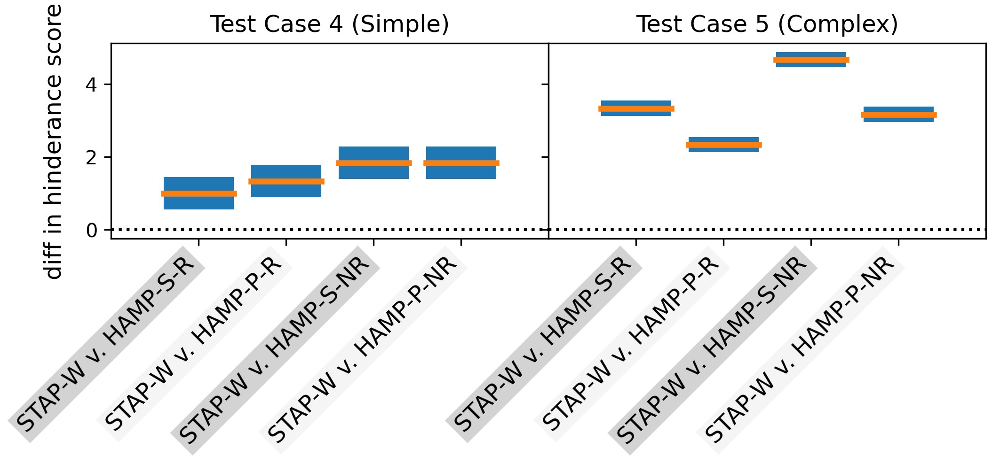

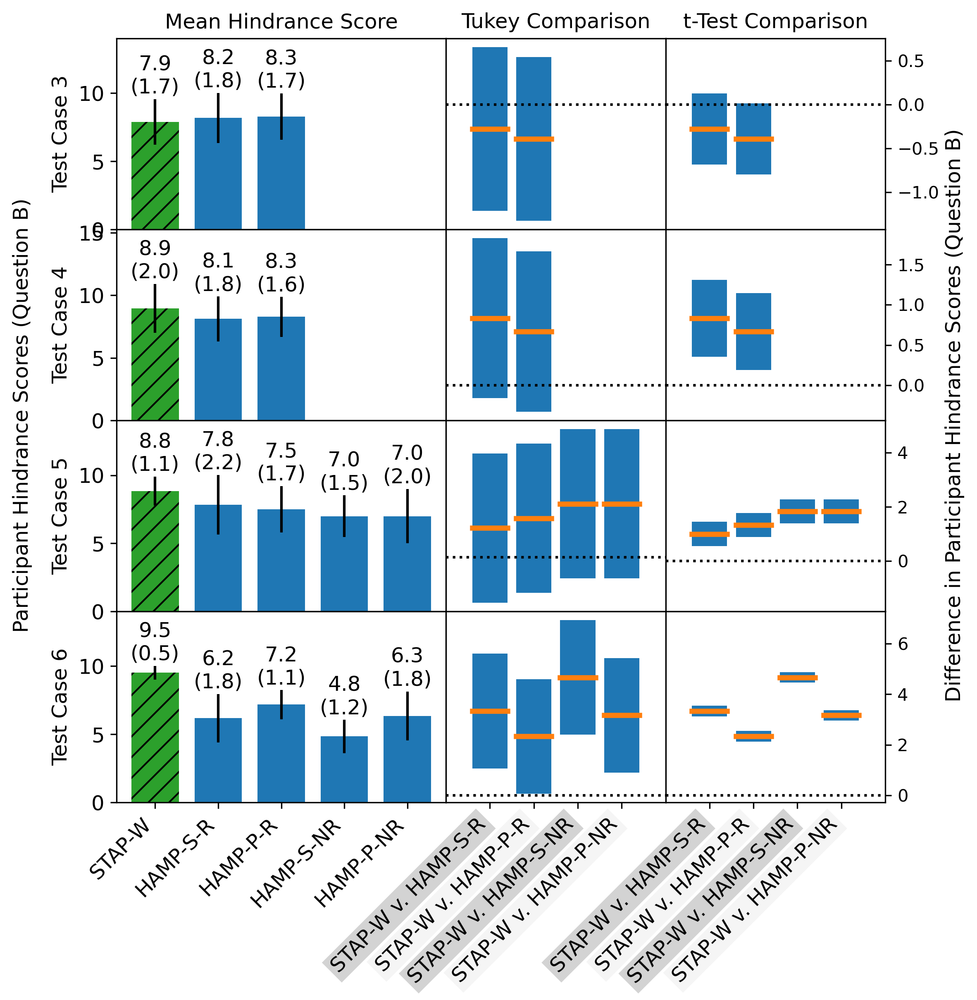

In [28]:
q='b'
print('analysis for question {}. {}'.format(q,questions[q]))
check_methods = {}
check_methods['1'] = ['2','1','3']
check_methods['2'] = ['2','1','3']
check_methods['3'] = ['1','2','3','4','5']
tasks = ['1','2']
participants = list(np.arange(1,19).astype(str))
# comparisons = [['2','1'],['2','3'],['1','3']]
comparisons = [['2','1'],['2','3']]
reps_per_method=5
test_reps_per_method=5
task_1_2_tukey_hinder_results = tukey_test_survey_results(q,1)
task_1_2_t_test_hinder_results = independent_t_test_survey_results(q,1)
n1 = len(task_1_2_tukey_hinder_results.means['1'].keys())
n2 = len(task_1_2_tukey_hinder_results.conf_ints['1'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_hinder_results,1,ax1[0],1)
plot_comparisons(task_1_2_tukey_hinder_results,1,ax1[1])
ax1[0].set_ylabel('hinderance score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in hinder score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_1_2_tukey_hinder_results.means['2'].keys())
n2 = len(task_1_2_tukey_hinder_results.conf_ints['2'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_hinder_results,2,ax2[0],1)
plot_comparisons(task_1_2_tukey_hinder_results,2,ax2[1])
ax2[0].set_ylabel('hinderance score',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in hinder score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
print('safety questions, only task 2 and 3 with 5 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5
test_reps_per_method=5#21
task_2_3_tukey_hinder_results = tukey_test_survey_results(q,1)
n1 = len(task_2_3_tukey_hinder_results.means['2'].keys())
n2 = len(task_2_3_tukey_hinder_results.conf_ints['2'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_hinder_results,2,ax1[0],1)
plot_comparisons(task_2_3_tukey_hinder_results,2,ax1[1])
ax1[0].set_ylabel('hinderance score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in safety score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_2_3_tukey_hinder_results.means['3'].keys())
n2 = len(task_2_3_tukey_hinder_results.conf_ints['3'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_hinder_results,3,ax2[0],1)
plot_comparisons(task_2_3_tukey_hinder_results,3,ax2[1])
ax2[0].set_ylabel('hinderance score',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in safety score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig3, ax3= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_tukey_hinder_results,2,ax3[0])
plot_comparisons(task_2_3_tukey_hinder_results,3,ax3[1])
ax3[0].set_ylabel('diff in hinderance score',fontsize=fsize,fontweight=fweight)
ax3[0].yaxis.tick_left()
ax3[0].yaxis.set_label_position("left")
ax3[0].set_title('Test Case 4 (Simple)')
ax3[1].yaxis.tick_left()
ax3[1].set_ylabel('')
ax3[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
from scipy.stats import t
print('independent t-test')
check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
num_trts = 5
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5    
task_2_3_t_test_hinder_results = independent_t_test_survey_results(q,1)
fig1, ax1= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_durations(task_2_3_t_test_hinder_results,2,ax1[0],1)
plot_durations(task_2_3_t_test_hinder_results,3,ax1[1],1)
ax1[0].set_ylabel('hinderance score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('')
ax1[0].set_title('Test Case 4 (Simple)')
ax1[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig2, ax2= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_hinder_results,2,ax2[0])
plot_comparisons(task_2_3_t_test_hinder_results,3,ax2[1])
ax2[0].set_ylabel('diff in hinderance score',fontsize=fsize,fontweight=fweight)
ax2[0].yaxis.tick_left()
ax2[0].yaxis.set_label_position("left")
ax2[0].set_title('Test Case 4 (Simple)')
ax2[1].yaxis.tick_left()
ax2[1].set_ylabel('')
ax2[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

fig, ax= plt.subplots(4,3,sharey=False,sharex='col',figsize=(8, 8),gridspec_kw={'width_ratios': [6, 4,4]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_hinder_results,1,ax[0,0],1)
plot_durations(task_1_2_tukey_hinder_results,2,ax[1,0],1)
plot_durations(task_2_3_t_test_hinder_results,2,ax[2,0],1)
plot_durations(task_2_3_t_test_hinder_results,3,ax[3,0],1)
plot_comparisons(task_1_2_tukey_hinder_results,1,ax[0,1])
plot_comparisons(task_1_2_tukey_hinder_results,2,ax[1,1])
plot_comparisons(task_2_3_tukey_hinder_results,2,ax[2,1])
plot_comparisons(task_2_3_tukey_hinder_results,3,ax[3,1])
plot_comparisons(task_1_2_t_test_hinder_results,1,ax[0,2])
plot_comparisons(task_1_2_t_test_hinder_results,2,ax[1,2])
plot_comparisons(task_2_3_t_test_hinder_results,2,ax[2,2])
plot_comparisons(task_2_3_t_test_hinder_results,3,ax[3,2])
for i in range(4):
    ylim1 = ax[i,1].get_ylim()
    ylim2 = ax[i,2].get_ylim()
    all_ylim = np.append(ylim1,ylim2)
    if i==2:
        ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)+0.5])
    else:
        ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)])
    ax[i,1].set_yticks([])
ax[0,0].set_ylabel('Test Case 3')
ax[1,0].set_ylabel('Test Case 4')
ax[2,0].set_ylabel('Test Case 5')
ax[3,0].set_ylabel('Test Case 6')
ax[0,1].set_ylabel('Test Case 3')
ax[1,1].set_ylabel('Test Case 4')
ax[2,1].set_ylabel('Test Case 5')
ax[3,1].set_ylabel('Test Case 6')
ax[0,0].set_title('Mean Hindrance Score')
ax[0,1].set_title('Tukey Comparison')
ax[0,2].set_title('t-Test Comparison')
ax[0,2].set_ylabel('')
ax[1,2].set_ylabel('')
ax[2,2].set_ylabel('')
ax[3,2].set_ylabel('')
# ax[0,2].yaxis.tick_right()
# ax[0,2].axhline(0.0,linestyle=':',color='black')
# ax[1,2].yaxis.tick_right()
# ax[1,2].axhline(0.0,linestyle=':',color='black')
fig.text(0.02, 0.5, 'Participant Hindrance Scores (Question B)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
fig.text(0.96, 0.5, 'Difference in Participant Hindrance Scores (Question B)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

analysis for question c. Did the robot perform logical motions? (0 is robot motions made no sense to you, 5 is neutral, 10 is robot motions made sense to you)
task 1 - 
	SST:15.81481481481483, 
	SSB:204.14814814814812, 
	SSE:80.85185185185183, 
	SST+SSB+SSE:300.8148148148148, 
	TSS:300.8148148148148
task 1 - MST:7.907407407407415, MSB:12.00871459694989, MSE:2.3779956427015243
STAP-W - HAMP-S-R:			( -2.5, -0.0)
STAP-W - HAMP-P-R:			( -1.6,  0.9)
task 2 - 
	SST:2.111111111111114, 
	SSB:160.66666666666669, 
	SSE:76.55555555555554, 
	SST+SSB+SSE:239.33333333333334, 
	TSS:239.33333333333334
task 2 - MST:1.055555555555557, MSB:9.450980392156865, MSE:2.251633986928104
STAP-W - HAMP-S-R:			( -0.8,  1.7)
STAP-W - HAMP-P-R:			( -0.8,  1.6)
task 1
STAP-W - HAMP-S-R:			( -1.8, -0.7)
STAP-W - HAMP-P-R:			( -0.9,  0.2)
task 2
STAP-W - HAMP-S-R:			( -0.1,  1.0)
STAP-W - HAMP-P-R:			( -0.1,  0.9)


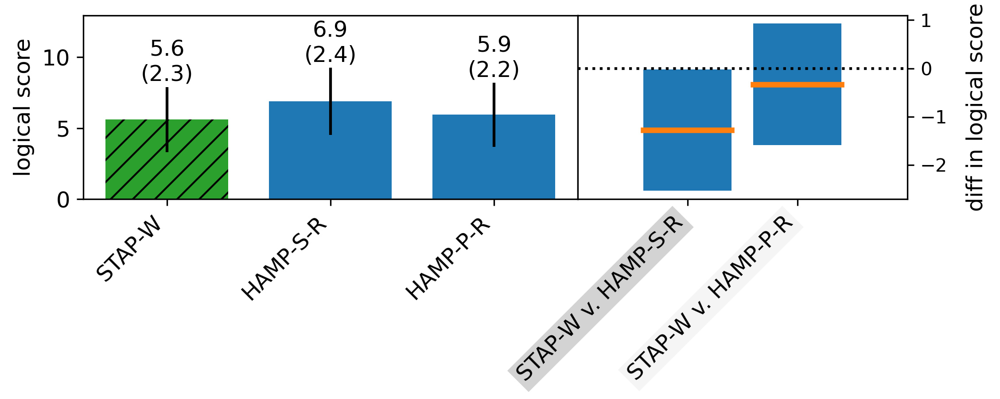

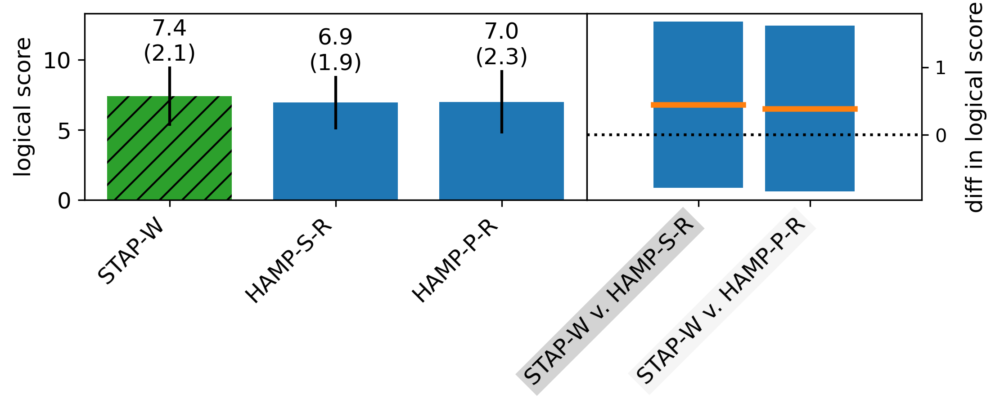

safety questions, only task 2 and 3 with 5 methods
task 2 - 
	SST:13.866666666666667, 
	SSB:21.86666666666666, 
	SSE:56.13333333333334, 
	SST+SSB+SSE:91.86666666666667, 
	TSS:91.86666666666662
task 2 - MST:3.466666666666667, MSB:4.373333333333332, MSE:2.806666666666667
STAP-W - HAMP-S-R:			( -2.2,  3.6)
STAP-W - HAMP-P-R:			( -1.6,  4.2)
STAP-W - HAMP-S-NR:			( -3.6,  2.2)
STAP-W - HAMP-P-NR:			( -2.9,  2.9)
task 3 - 
	SST:13.333333333333327, 
	SSB:30.266666666666676, 
	SSE:39.066666666666656, 
	SST+SSB+SSE:82.66666666666666, 
	TSS:82.66666666666666
task 3 - MST:3.3333333333333317, MSB:6.0533333333333355, MSE:1.9533333333333327
STAP-W - HAMP-S-R:			( -0.4,  4.4)
STAP-W - HAMP-P-R:			( -1.4,  3.4)
STAP-W - HAMP-S-NR:			( -1.7,  3.1)
STAP-W - HAMP-P-NR:			( -1.9,  2.9)


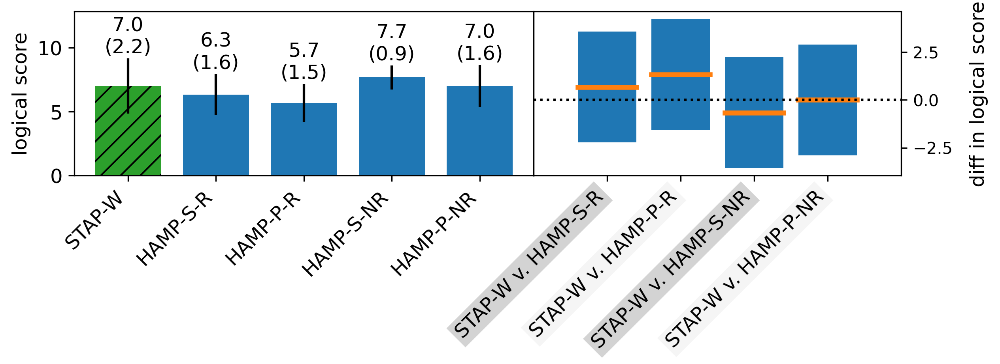

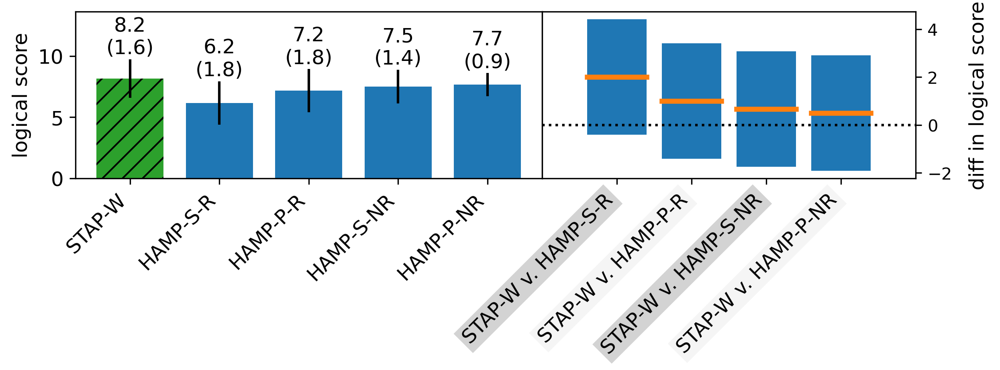

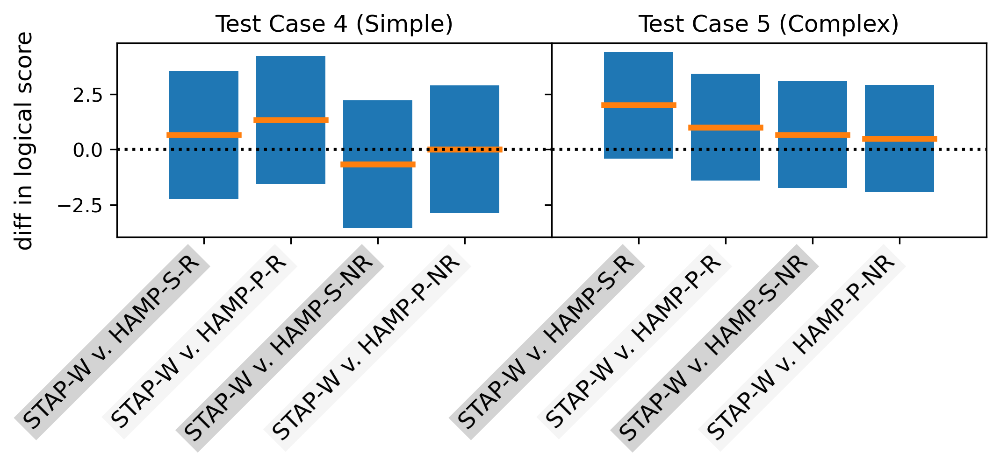

independent t-test
task 2
STAP-W - HAMP-S-R:			( -0.2,  1.6)
STAP-W - HAMP-P-R:			(  0.4,  2.2)
STAP-W - HAMP-S-NR:			( -1.6,  0.2)
STAP-W - HAMP-P-NR:			( -0.9,  0.9)
task 3
STAP-W - HAMP-S-R:			(  1.3,  2.7)
STAP-W - HAMP-P-R:			(  0.3,  1.7)
STAP-W - HAMP-S-NR:			(  0.0,  1.3)
STAP-W - HAMP-P-NR:			( -0.2,  1.2)


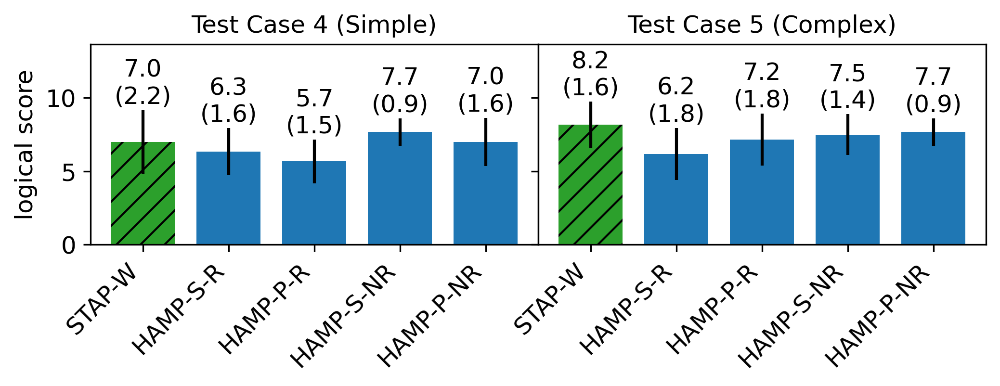

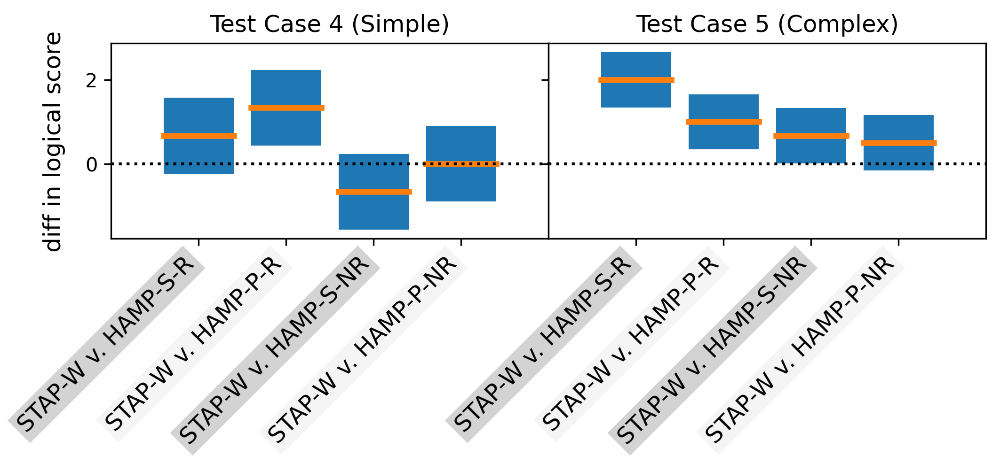

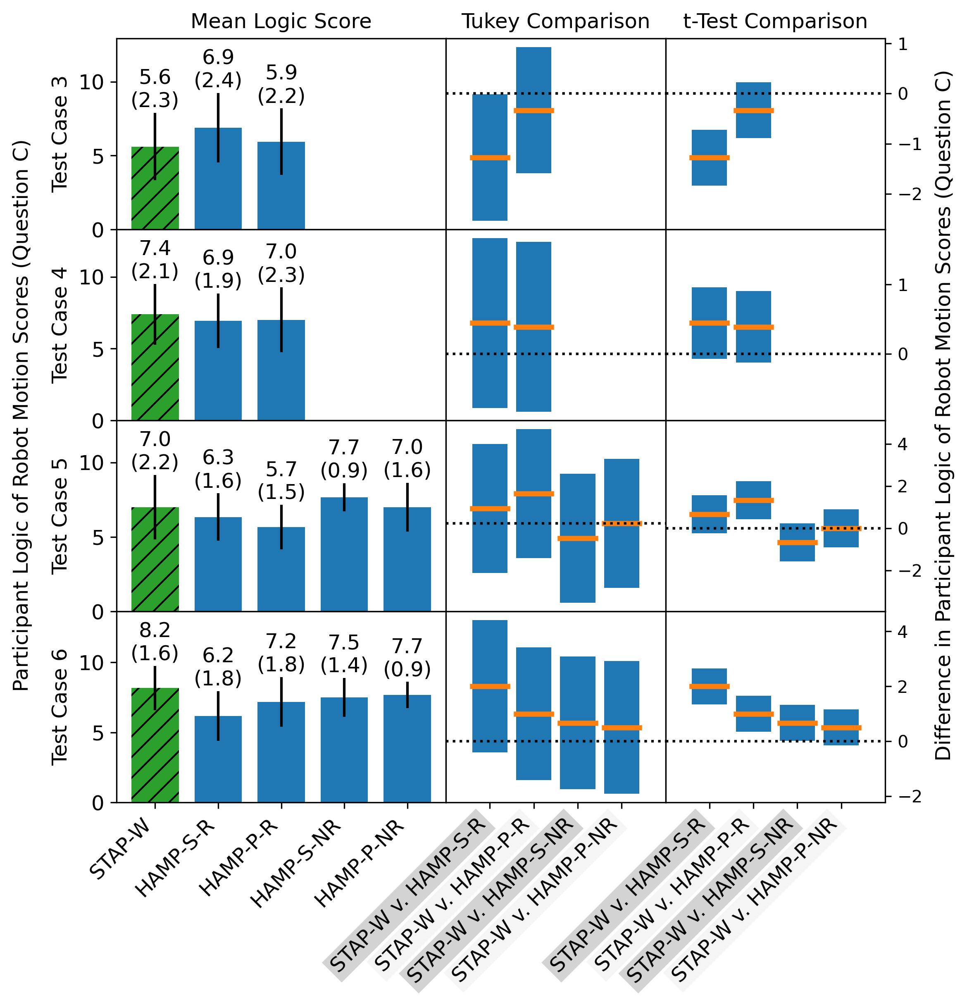

In [29]:
q='c'
print('analysis for question {}. {}'.format(q,questions[q]))
check_methods = {}
check_methods['1'] = ['2','1','3']
check_methods['2'] = ['2','1','3']
check_methods['3'] = ['1','2','3','4','5']
tasks = ['1','2']
participants = list(np.arange(1,19).astype(str))
# comparisons = [['2','1'],['2','3'],['1','3']]
comparisons = [['2','1'],['2','3']]
reps_per_method=5
test_reps_per_method=5
task_1_2_tukey_logic_results = tukey_test_survey_results(q,1)
task_1_2_t_test_logic_results = independent_t_test_survey_results(q,1)
n1 = len(task_1_2_tukey_logic_results.means['1'].keys())
n2 = len(task_1_2_tukey_logic_results.conf_ints['1'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_logic_results,1,ax1[0],1)
plot_comparisons(task_1_2_tukey_logic_results,1,ax1[1])
ax1[0].set_ylabel('logical score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in logical score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_1_2_tukey_logic_results.means['2'].keys())
n2 = len(task_1_2_tukey_logic_results.conf_ints['2'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_logic_results,2,ax2[0],1)
plot_comparisons(task_1_2_tukey_logic_results,2,ax2[1])
ax2[0].set_ylabel('logical score',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in logical score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
print('safety questions, only task 2 and 3 with 5 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5
test_reps_per_method=5#21
task_2_3_tukey_logic_results = tukey_test_survey_results(q,1)
n1 = len(task_2_3_tukey_logic_results.means['2'].keys())
n2 = len(task_2_3_tukey_logic_results.conf_ints['2'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_logic_results,2,ax1[0],1)
plot_comparisons(task_2_3_tukey_logic_results,2,ax1[1])
ax1[0].set_ylabel('logical score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in logical score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_2_3_tukey_logic_results.means['3'].keys())
n2 = len(task_2_3_tukey_logic_results.conf_ints['3'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_logic_results,3,ax2[0],1)
plot_comparisons(task_2_3_tukey_logic_results,3,ax2[1])
ax2[0].set_ylabel('logical score',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in logical score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig3, ax3= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_tukey_logic_results,2,ax3[0])
plot_comparisons(task_2_3_tukey_logic_results,3,ax3[1])
ax3[0].set_ylabel('diff in logical score',fontsize=fsize,fontweight=fweight)
ax3[0].yaxis.tick_left()
ax3[0].yaxis.set_label_position("left")
ax3[0].set_title('Test Case 4 (Simple)')
ax3[1].yaxis.tick_left()
ax3[1].set_ylabel('')
ax3[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
from scipy.stats import t
print('independent t-test')
check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
num_trts = 5
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5    
task_2_3_t_test_logic_results = independent_t_test_survey_results(q,1)
fig1, ax1= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_durations(task_2_3_t_test_logic_results,2,ax1[0],1)
plot_durations(task_2_3_t_test_logic_results,3,ax1[1],1)
ax1[0].set_ylabel('logical score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('')
ax1[0].set_title('Test Case 4 (Simple)')
ax1[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig2, ax2= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_logic_results,2,ax2[0])
plot_comparisons(task_2_3_t_test_logic_results,3,ax2[1])
ax2[0].set_ylabel('diff in logical score',fontsize=fsize,fontweight=fweight)
ax2[0].yaxis.tick_left()
ax2[0].yaxis.set_label_position("left")
ax2[0].set_title('Test Case 4 (Simple)')
ax2[1].yaxis.tick_left()
ax2[1].set_ylabel('')
ax2[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

fig, ax= plt.subplots(4,3,sharey=False,sharex='col',figsize=(8, 8),gridspec_kw={'width_ratios': [6, 4,4]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_logic_results,1,ax[0,0],1)
plot_durations(task_1_2_tukey_logic_results,2,ax[1,0],1)
plot_durations(task_2_3_t_test_logic_results,2,ax[2,0],1)
plot_durations(task_2_3_t_test_logic_results,3,ax[3,0],1)
plot_comparisons(task_1_2_tukey_logic_results,1,ax[0,1])
plot_comparisons(task_1_2_tukey_logic_results,2,ax[1,1])
plot_comparisons(task_2_3_tukey_logic_results,2,ax[2,1])
plot_comparisons(task_2_3_tukey_logic_results,3,ax[3,1])
plot_comparisons(task_1_2_t_test_logic_results,1,ax[0,2])
plot_comparisons(task_1_2_t_test_logic_results,2,ax[1,2])
plot_comparisons(task_2_3_t_test_logic_results,2,ax[2,2])
plot_comparisons(task_2_3_t_test_logic_results,3,ax[3,2])
for i in range(4):
    ylim1 = ax[i,1].get_ylim()
    ylim2 = ax[i,2].get_ylim()
    all_ylim = np.append(ylim1,ylim2)
    if i==2:
        ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)+0.5])
    else:
        ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)])
    ax[i,1].set_yticks([])
ax[0,0].set_ylabel('Test Case 3')
ax[1,0].set_ylabel('Test Case 4')
ax[2,0].set_ylabel('Test Case 5')
ax[3,0].set_ylabel('Test Case 6')
ax[0,1].set_ylabel('Test Case 3')
ax[1,1].set_ylabel('Test Case 4')
ax[2,1].set_ylabel('Test Case 5')
ax[3,1].set_ylabel('Test Case 6')
ax[0,0].set_title('Mean Logic Score')
ax[0,1].set_title('Tukey Comparison')
ax[0,2].set_title('t-Test Comparison')
ax[0,2].set_ylabel('')
ax[1,2].set_ylabel('')
ax[2,2].set_ylabel('')
ax[3,2].set_ylabel('')
# ax[0,2].yaxis.tick_right()
# ax[0,2].axhline(0.0,linestyle=':',color='black')
# ax[1,2].yaxis.tick_right()
# ax[1,2].axhline(0.0,linestyle=':',color='black')
fig.text(0.02, 0.5, 'Participant Logic of Robot Motion Scores (Question C)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
fig.text(0.95, 0.5, 'Difference in Participant Logic of Robot Motion Scores (Question C)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

analysis for question d. What is your overall satisfaction with the HRC task? (0 is you would not work in this HRC cell again, 5 is neutral, 10 is you enjoyed working in this cell with the robot)
task 1 - 
	SST:11.703703703703697, 
	SSB:207.9259259259259, 
	SSE:43.62962962962963, 
	SST+SSB+SSE:263.25925925925924, 
	TSS:263.2592592592593
task 1 - MST:5.8518518518518485, MSB:12.230936819172111, MSE:1.2832244008714597
STAP-W - HAMP-S-R:			( -0.1,  1.7)
STAP-W - HAMP-P-R:			(  0.2,  2.0)
task 2 - 
	SST:26.703703703703724, 
	SSB:189.20370370370372, 
	SSE:32.629629629629626, 
	SST+SSB+SSE:248.53703703703707, 
	TSS:248.5370370370371
task 2 - MST:13.351851851851862, MSB:11.129629629629632, MSE:0.9596949891067537
STAP-W - HAMP-S-R:			(  0.8,  2.4)
STAP-W - HAMP-P-R:			(  0.5,  2.1)
task 1
STAP-W - HAMP-S-R:			(  0.4,  1.1)
STAP-W - HAMP-P-R:			(  0.7,  1.5)
task 2
STAP-W - HAMP-S-R:			(  1.2,  2.0)
STAP-W - HAMP-P-R:			(  0.9,  1.7)


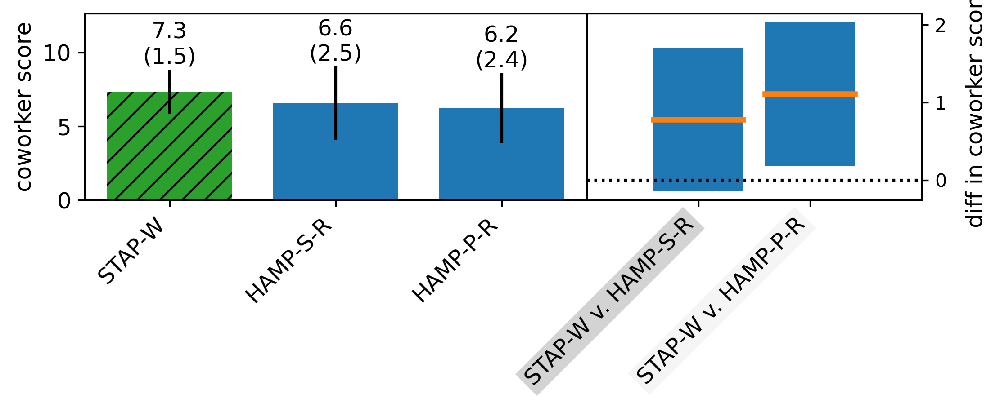

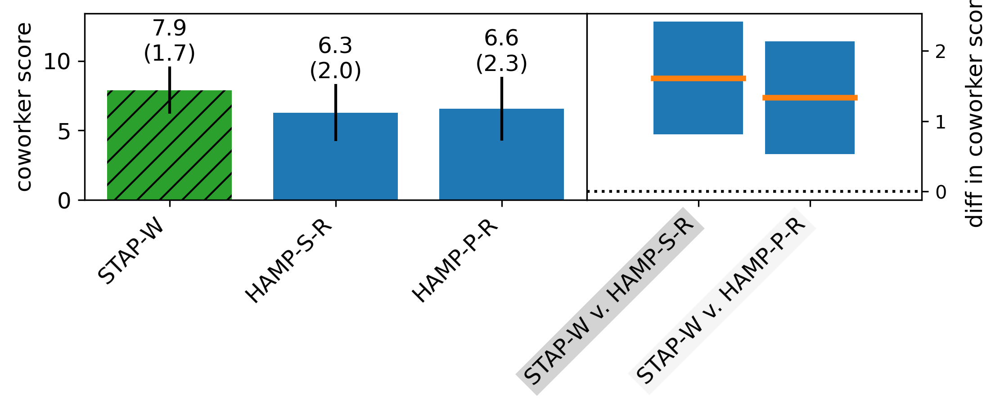

safety questions, only task 2 and 3 with 5 methods
task 2 - 
	SST:27.800000000000004, 
	SSB:26.400000000000013, 
	SSE:20.600000000000005, 
	SST+SSB+SSE:74.80000000000003, 
	TSS:74.80000000000001
task 2 - MST:6.950000000000001, MSB:5.280000000000003, MSE:1.0300000000000002
STAP-W - HAMP-S-R:			(  0.7,  4.3)
STAP-W - HAMP-P-R:			(  0.6,  4.1)
STAP-W - HAMP-S-NR:			( -0.9,  2.6)
STAP-W - HAMP-P-NR:			( -0.9,  2.6)
task 3 - 
	SST:33.333333333333336, 
	SSB:29.866666666666653, 
	SSE:23.466666666666676, 
	SST+SSB+SSE:86.66666666666666, 
	TSS:86.66666666666669
task 3 - MST:8.333333333333334, MSB:5.973333333333331, MSE:1.1733333333333338
STAP-W - HAMP-S-R:			(  1.3,  5.0)
STAP-W - HAMP-P-R:			( -0.0,  3.7)
STAP-W - HAMP-S-NR:			(  0.3,  4.0)
STAP-W - HAMP-P-NR:			( -0.7,  3.0)


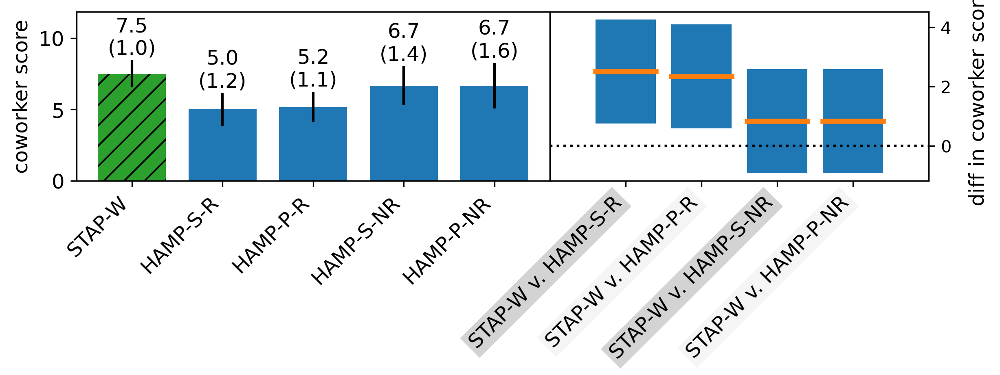

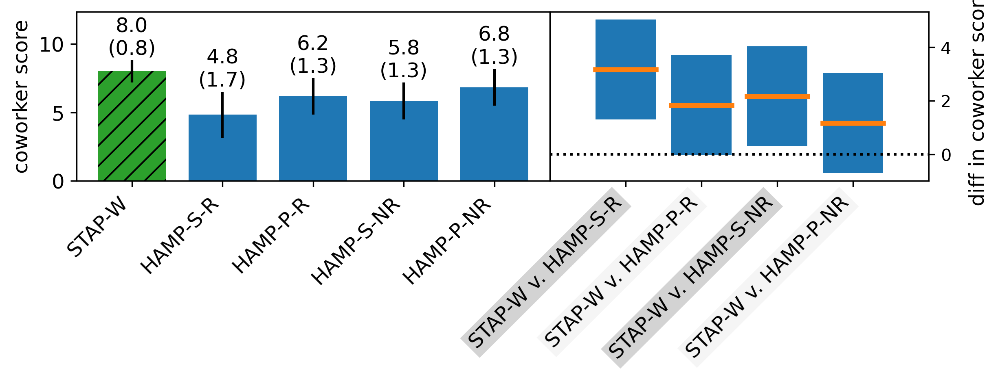

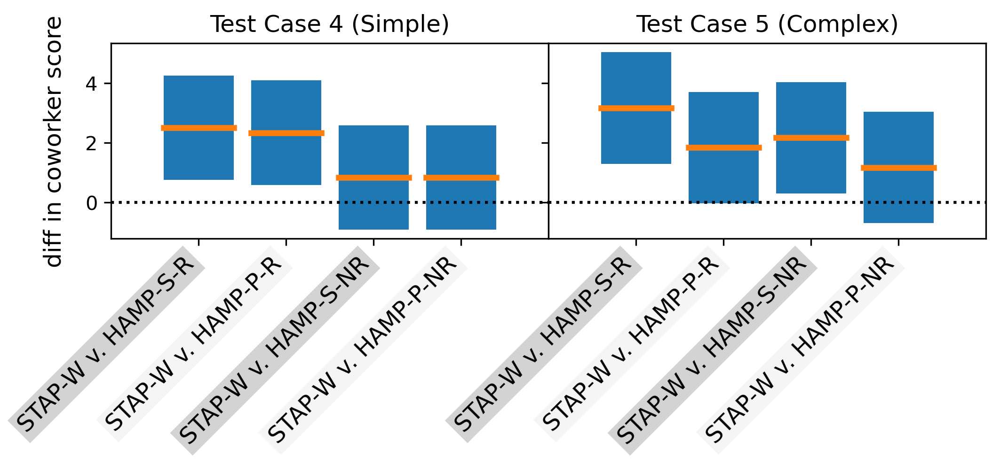

independent t-test
task 2
STAP-W - HAMP-S-R:			(  2.1,  2.9)
STAP-W - HAMP-P-R:			(  1.9,  2.7)
STAP-W - HAMP-S-NR:			(  0.4,  1.2)
STAP-W - HAMP-P-NR:			(  0.4,  1.2)
task 3
STAP-W - HAMP-S-R:			(  2.8,  3.5)
STAP-W - HAMP-P-R:			(  1.5,  2.2)
STAP-W - HAMP-S-NR:			(  1.8,  2.5)
STAP-W - HAMP-P-NR:			(  0.8,  1.5)


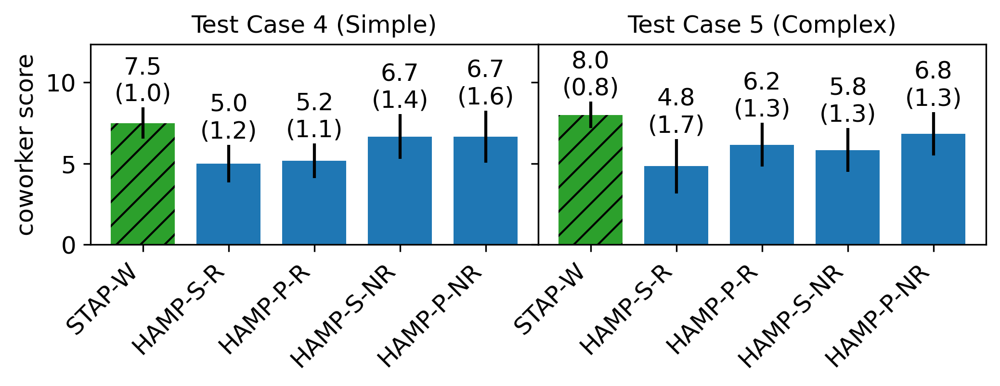

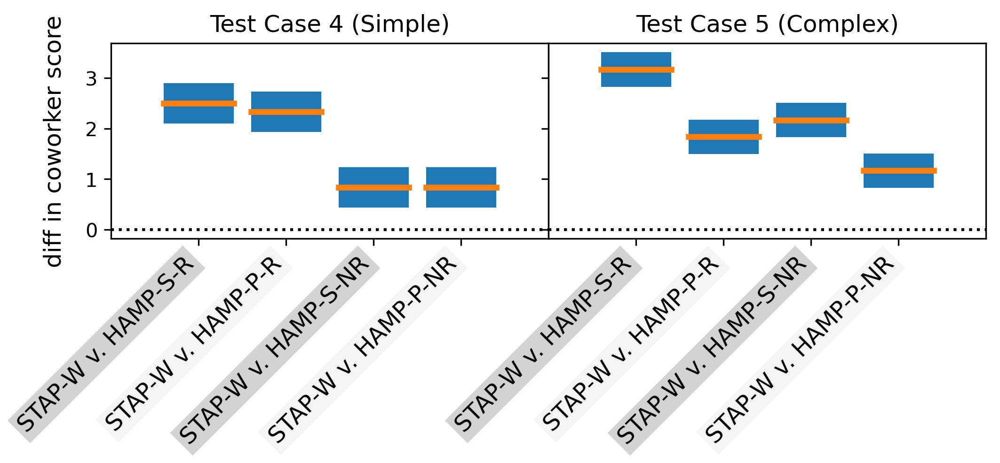

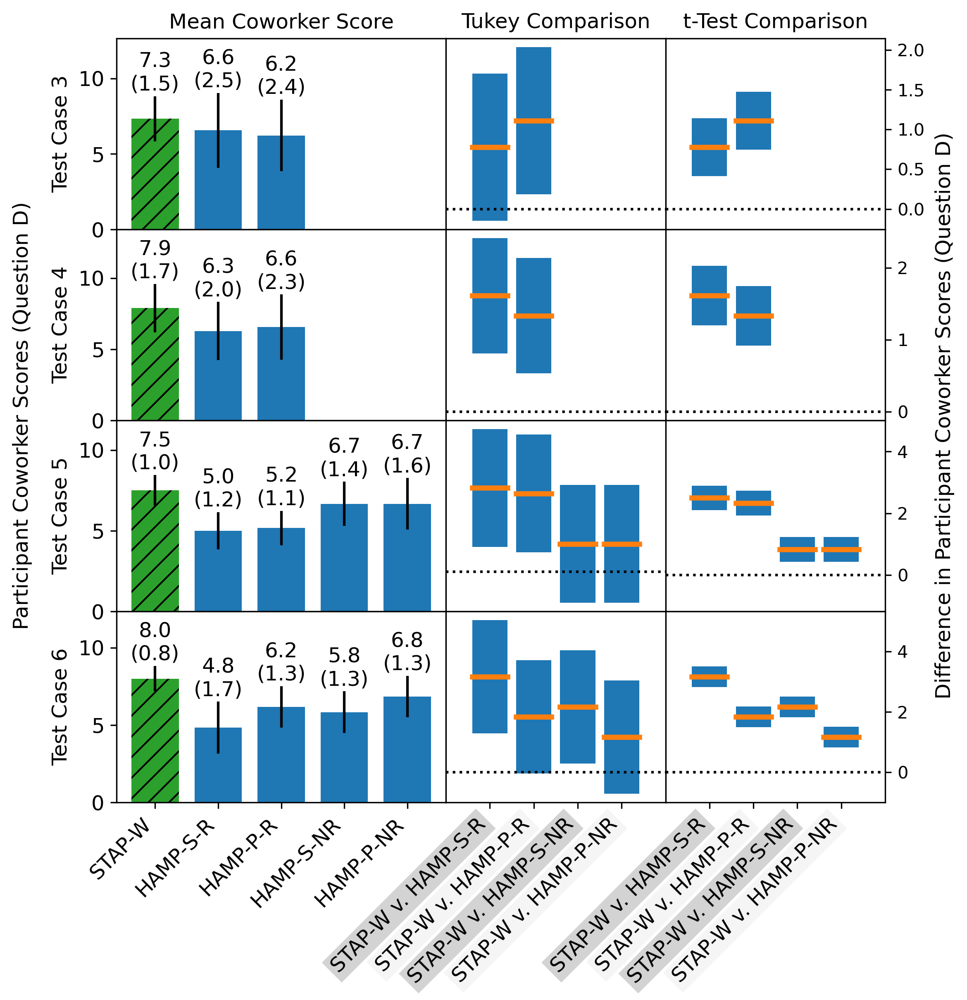

In [30]:
q='d'
print('analysis for question {}. {}'.format(q,questions[q]))
check_methods = {}
check_methods['1'] = ['2','1','3']
check_methods['2'] = ['2','1','3']
check_methods['3'] = ['1','2','3','4','5']
tasks = ['1','2']
participants = list(np.arange(1,19).astype(str))
# comparisons = [['2','1'],['2','3'],['1','3']]
comparisons = [['2','1'],['2','3']]
reps_per_method=5
test_reps_per_method=5
task_1_2_tukey_coworker_results = tukey_test_survey_results(q,1)
task_1_2_t_test_coworker_results = independent_t_test_survey_results(q,1)
n1 = len(task_1_2_tukey_coworker_results.means['1'].keys())
n2 = len(task_1_2_tukey_coworker_results.conf_ints['1'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_coworker_results,1,ax1[0],1)
plot_comparisons(task_1_2_tukey_coworker_results,1,ax1[1])
ax1[0].set_ylabel('coworker score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in coworker score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_1_2_tukey_coworker_results.means['2'].keys())
n2 = len(task_1_2_tukey_coworker_results.conf_ints['2'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(8, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_coworker_results,2,ax2[0],1)
plot_comparisons(task_1_2_tukey_coworker_results,2,ax2[1])
ax2[0].set_ylabel('coworker score',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in coworker score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
print('safety questions, only task 2 and 3 with 5 methods')
from scipy.stats import studentized_range
import math

total_samples = 0
num_trts = len(trt_names)

check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5
test_reps_per_method=5#21
task_2_3_tukey_coworker_results = tukey_test_survey_results(q,1)
n1 = len(task_2_3_tukey_coworker_results.means['2'].keys())
n2 = len(task_2_3_tukey_coworker_results.conf_ints['2'].keys())
fig1, ax1= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_coworker_results,2,ax1[0],1)
plot_comparisons(task_2_3_tukey_coworker_results,2,ax1[1])
ax1[0].set_ylabel('coworker score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('diff in coworker score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
n1 = len(task_2_3_tukey_coworker_results.means['3'].keys())
n2 = len(task_2_3_tukey_coworker_results.conf_ints['3'].keys())
fig2, ax2= plt.subplots(1,2,sharey=False,sharex=False,figsize=(9, 1.8),gridspec_kw={'width_ratios': [n1, n2]})#(5.8, 1.8)
plot_durations(task_2_3_tukey_coworker_results,3,ax2[0],1)
plot_comparisons(task_2_3_tukey_coworker_results,3,ax2[1])
ax2[0].set_ylabel('coworker score',fontsize=fsize,fontweight=fweight)
ax2[1].set_ylabel('diff in coworker score',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig3, ax3= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_tukey_coworker_results,2,ax3[0])
plot_comparisons(task_2_3_tukey_coworker_results,3,ax3[1])
ax3[0].set_ylabel('diff in coworker score',fontsize=fsize,fontweight=fweight)
ax3[0].yaxis.tick_left()
ax3[0].yaxis.set_label_position("left")
ax3[0].set_title('Test Case 4 (Simple)')
ax3[1].yaxis.tick_left()
ax3[1].set_ylabel('')
ax3[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
from scipy.stats import t
print('independent t-test')
check_methods = {}
check_methods['2'] = ['2','1','3','4','5']
check_methods['3'] = ['2','1','3','4','5']
num_trts = 5
tasks = ['2','3']
participants = ['5','7','11','12','16','17']
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['1','3'],['4','1'],['4','3'],['5','1'],['5','3'],['4','5']]
# comparisons = [['2','1'],['2','3'],['2','4'],['2','5'],['4','1'],['4','3'],['5','1'],['5','3']]
comparisons = [['2','1'],['2','3'],['2','4'],['2','5']]
reps_per_method=5    
task_2_3_t_test_coworker_results = independent_t_test_survey_results(q,1)
fig1, ax1= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_durations(task_2_3_t_test_coworker_results,2,ax1[0],1)
plot_durations(task_2_3_t_test_coworker_results,3,ax1[1],1)
ax1[0].set_ylabel('coworker score',fontsize=fsize,fontweight=fweight)
ax1[1].set_ylabel('')
ax1[0].set_title('Test Case 4 (Simple)')
ax1[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig2, ax2= plt.subplots(1,2,sharey=True,sharex=False,figsize=(8, 1.8))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_coworker_results,2,ax2[0])
plot_comparisons(task_2_3_t_test_coworker_results,3,ax2[1])
ax2[0].set_ylabel('diff in coworker score',fontsize=fsize,fontweight=fweight)
ax2[0].yaxis.tick_left()
ax2[0].yaxis.set_label_position("left")
ax2[0].set_title('Test Case 4 (Simple)')
ax2[1].yaxis.tick_left()
ax2[1].set_ylabel('')
ax2[1].set_title('Test Case 5 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

fig, ax= plt.subplots(4,3,sharey=False,sharex='col',figsize=(8, 8),gridspec_kw={'width_ratios': [6, 4,4]})#(5.8, 1.8)
plot_durations(task_1_2_tukey_coworker_results,1,ax[0,0],1)
plot_durations(task_1_2_tukey_coworker_results,2,ax[1,0],1)
plot_durations(task_2_3_t_test_coworker_results,2,ax[2,0],1)
plot_durations(task_2_3_t_test_coworker_results,3,ax[3,0],1)
plot_comparisons(task_1_2_tukey_coworker_results,1,ax[0,1])
plot_comparisons(task_1_2_tukey_coworker_results,2,ax[1,1])
plot_comparisons(task_2_3_tukey_coworker_results,2,ax[2,1])
plot_comparisons(task_2_3_tukey_coworker_results,3,ax[3,1])
plot_comparisons(task_1_2_t_test_coworker_results,1,ax[0,2])
plot_comparisons(task_1_2_t_test_coworker_results,2,ax[1,2])
plot_comparisons(task_2_3_t_test_coworker_results,2,ax[2,2])
plot_comparisons(task_2_3_t_test_coworker_results,3,ax[3,2])
for i in range(4):
    ylim1 = ax[i,1].get_ylim()
    ylim2 = ax[i,2].get_ylim()
    all_ylim = np.append(ylim1,ylim2)
    if i==2:
        ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)+0.5])
    else:
        ax[i,2].set_ylim([np.min(all_ylim),np.max(all_ylim)])
    ax[i,1].set_yticks([])
ax[0,0].set_ylabel('Test Case 3')
ax[1,0].set_ylabel('Test Case 4')
ax[2,0].set_ylabel('Test Case 5')
ax[3,0].set_ylabel('Test Case 6')
ax[0,1].set_ylabel('Test Case 3')
ax[1,1].set_ylabel('Test Case 4')
ax[2,1].set_ylabel('Test Case 5')
ax[3,1].set_ylabel('Test Case 6')
ax[0,0].set_title('Mean Coworker Score')
ax[0,1].set_title('Tukey Comparison')
ax[0,2].set_title('t-Test Comparison')
ax[0,2].set_ylabel('')
ax[1,2].set_ylabel('')
ax[2,2].set_ylabel('')
ax[3,2].set_ylabel('')
# ax[0,2].yaxis.tick_right()
# ax[0,2].axhline(0.0,linestyle=':',color='black')
# ax[1,2].yaxis.tick_right()
# ax[1,2].axhline(0.0,linestyle=':',color='black')
fig.text(0.02, 0.5, 'Participant Coworker Scores (Question D)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
fig.text(0.95, 0.5, 'Difference in Participant Coworker Scores (Question D)', va='center', rotation='vertical',fontsize=fsize,fontweight=fweight)
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()

In [31]:
headers = ['participant','task','method','experience','safety score','hinderance score','logic score','coworker score','avg. robot time','std. robot time', 'avg. separation','std. separation','avg. time under 0.3m','std. time under 0.3m']
output_data = np.empty((0,len(headers)))
for task in all_data['samples'].keys():
    for method in all_data['samples'][task].keys():
        for participant in all_data['samples'][task][method].keys():
            tmp_row = np.zeros((len(headers)))
            tmp_row[0] = int(participant)
            tmp_row[1] = int(task)
            tmp_row[2] = int(method)
            tmp_row[3] = df['Experience'][tmp_row[0]-1]
            tmp_row[4] = survey_data['a'][task][method][participant]
            tmp_row[5] = survey_data['b'][task][method][participant]
            tmp_row[6] = survey_data['c'][task][method][participant]
            tmp_row[7] = survey_data['d'][task][method][participant]
            tmp_row[8] = np.mean(all_data['final_times_arr'][task][method][participant][:5])
            tmp_row[9] = np.std(all_data['final_times_arr'][task][method][participant][:5])
            tmp_row[10] = np.mean(all_data['avg_sep'][task][method][participant][:5])
            tmp_row[11] = np.std(all_data['avg_sep'][task][method][participant][:5])
            tmp_row[12] = np.mean(all_data['time_under_0p3m'][task][method][participant][:5])
            tmp_row[13] = np.std(all_data['time_under_0p3m'][task][method][participant][:5])
            output_data = np.append(output_data,tmp_row.reshape((1,tmp_row.shape[0])),axis=0)
np.savetxt('all_part_data.csv',output_data,delimiter=',',header=','.join(headers))


Index(['correlation', 't 1 m 1', 't 1 m 2', 't 1 m 3', 't 2 m 1', 't 2 m 2',
       't 2 m 3', 't 2 m 4', 't 2 m 5', 't 3 m 1', 't 3 m 2', 't 3 m 3',
       't 3 m 4', 't 3 m 5'],
      dtype='object')
11


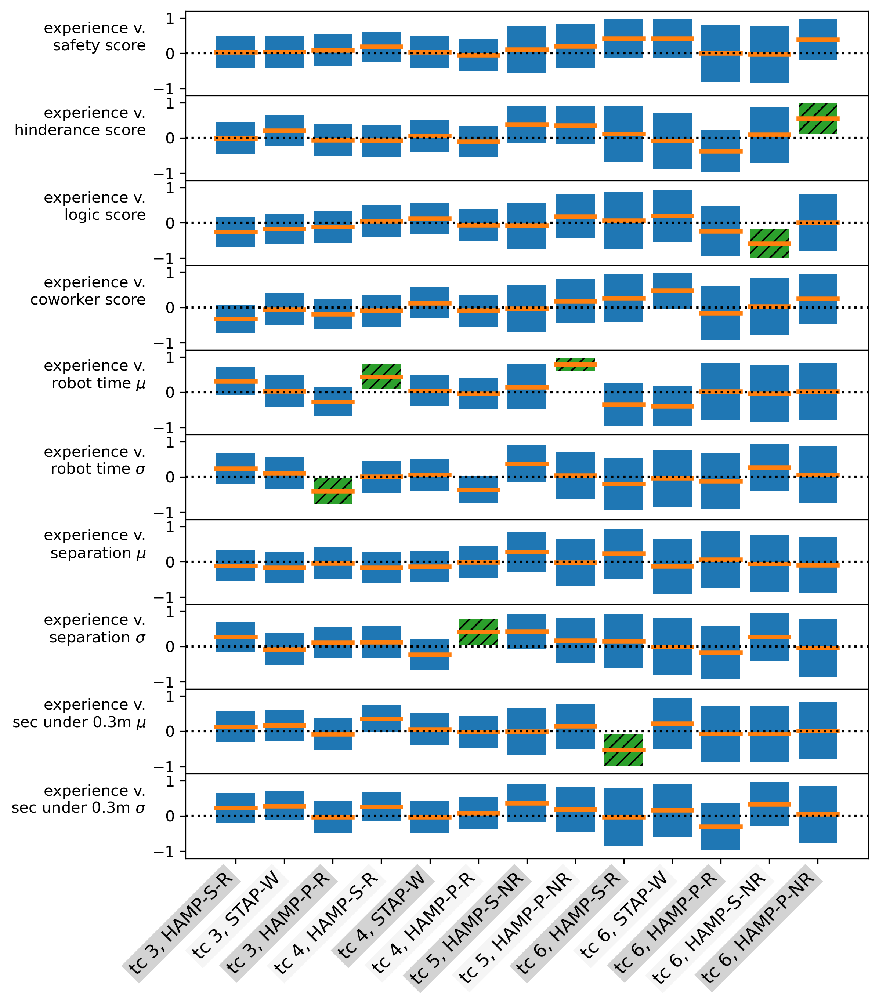

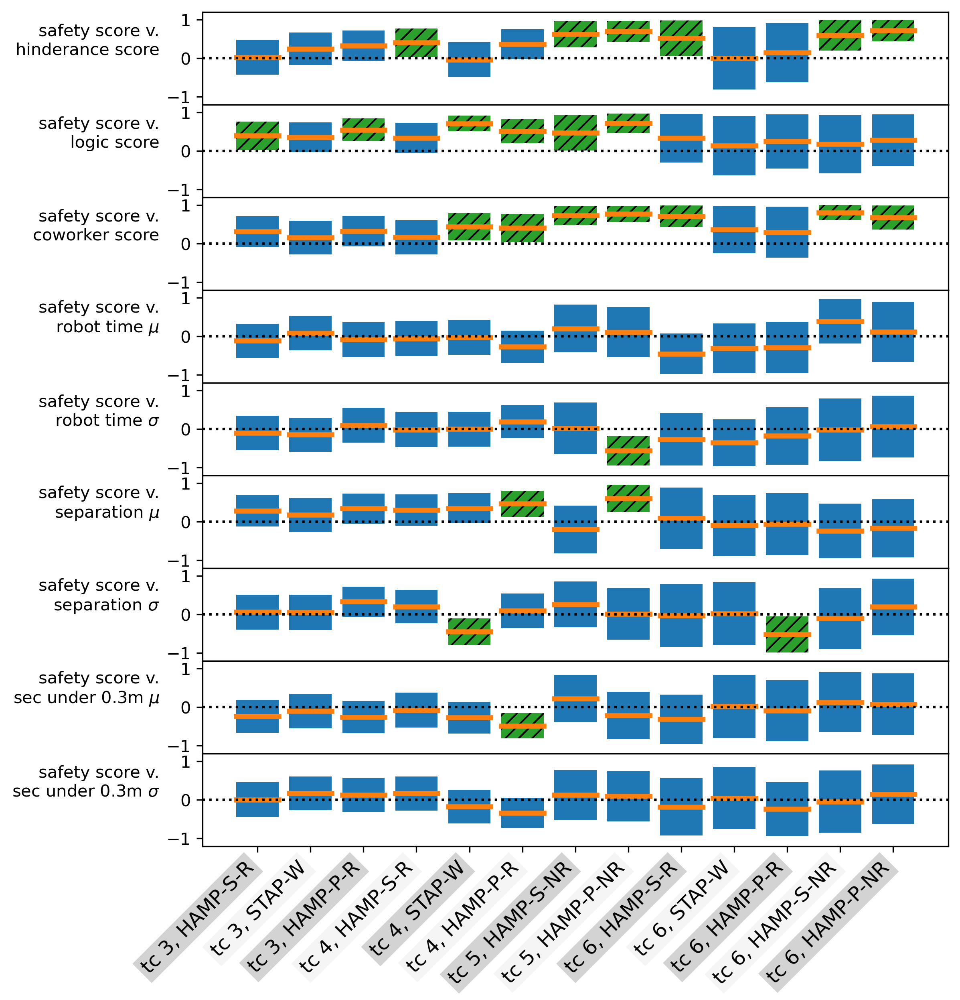

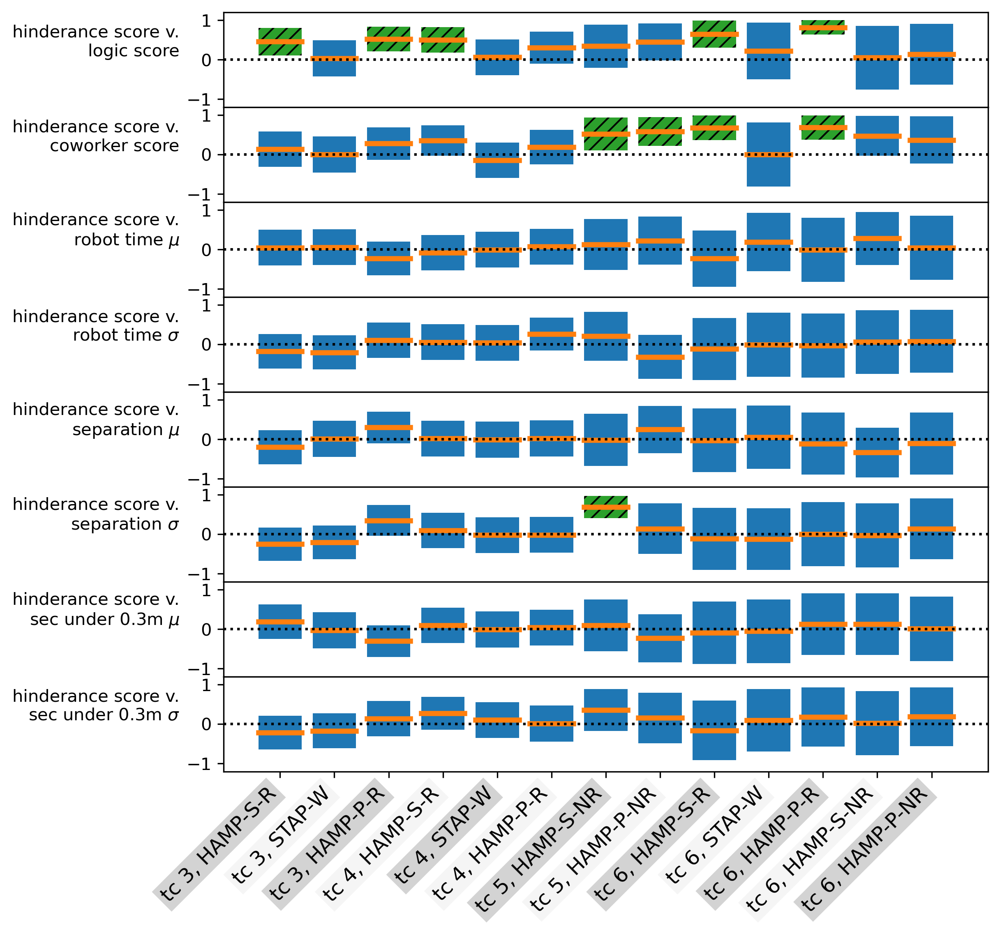

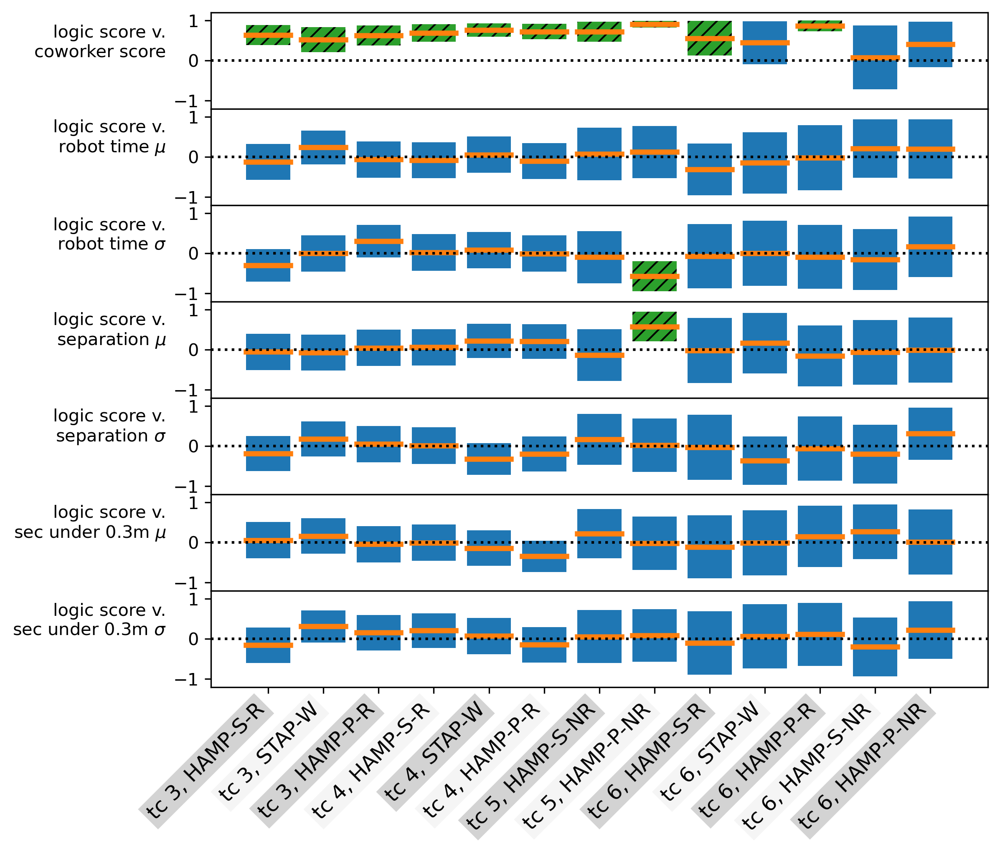

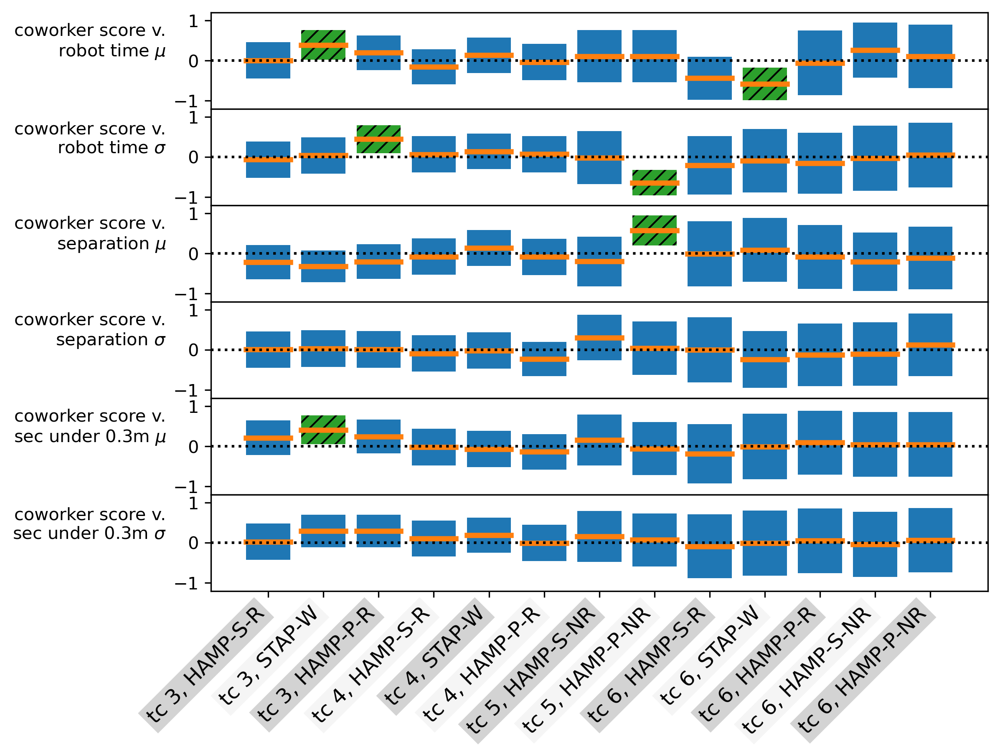

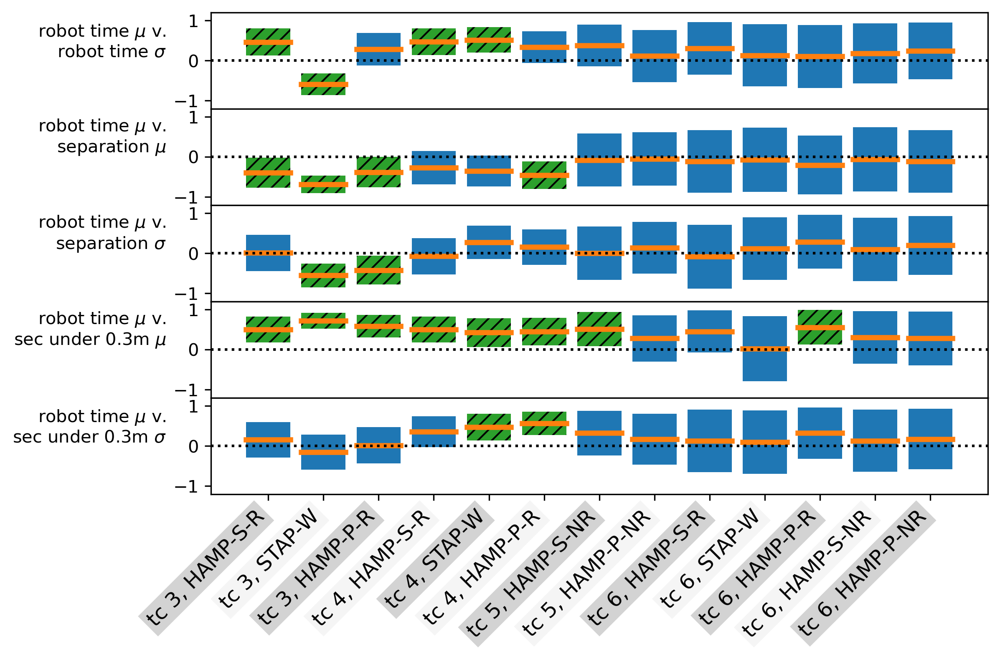

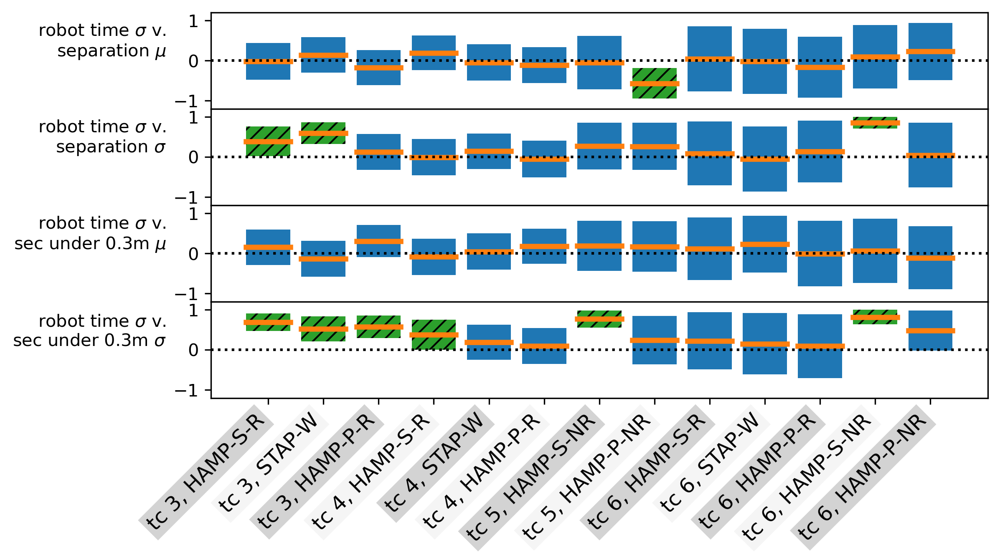

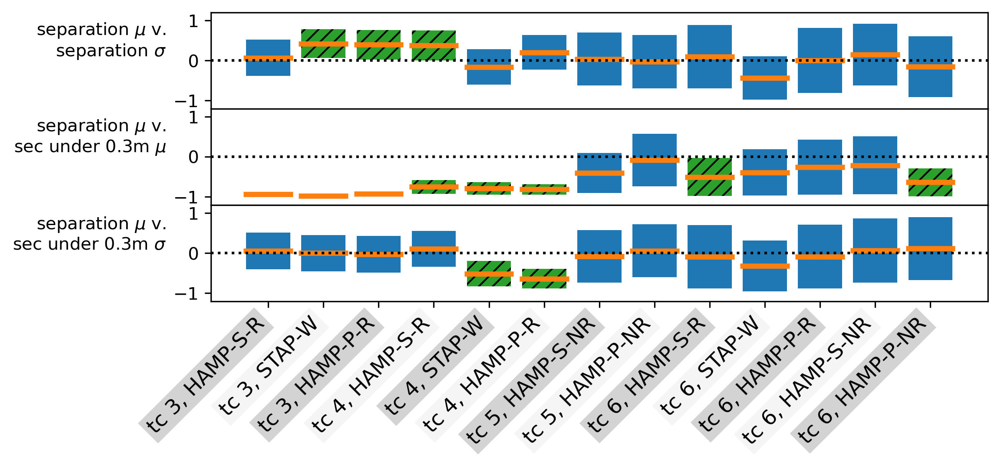

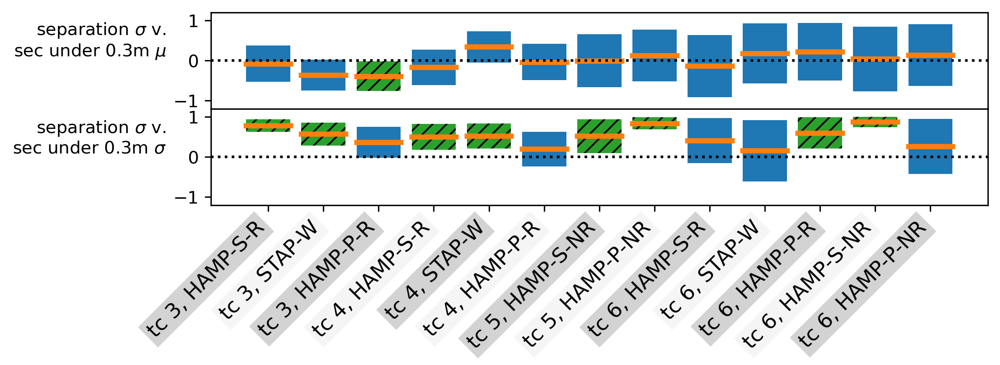

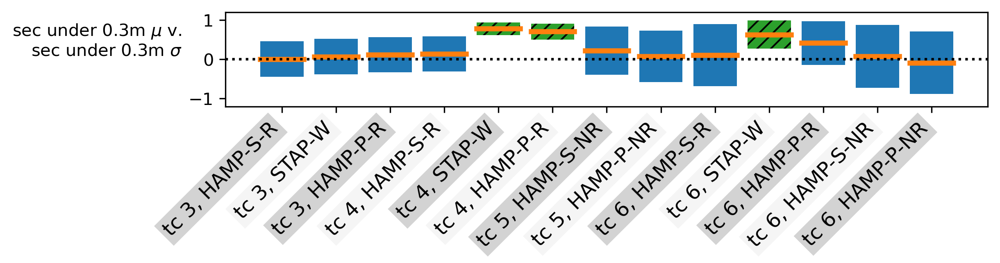

In [32]:
#read in questionare info
import pandas as pd
df_corr = pd.read_csv(os.path.join(os.getcwd(),'participant_questions','correlations.csv'))
print(df_corr.columns) 
corr_np = df_corr.to_numpy()
import_fields = ['experience','safety.score','hinderance.score','logic.score','coworker.score','avg..robot.time','std..robot.time',
 'avg..separation','std..separation','avg..time.under.0.3m','std..time.under.0.3m']
output_fields = ['experience','safety score','hinderance score','logic score','coworker score','robot time $\mu$','robot time $\sigma$',
 'separation $\mu$','separation $\sigma$','sec under 0.3m $\mu$','sec under 0.3m $\sigma$']
print(len(output_fields))
col_names = ['tc 3, HAMP-S-R','tc 3, STAP-W','tc 3, HAMP-P-R','tc 4, HAMP-S-R','tc 4, STAP-W','tc 4, HAMP-P-R','tc 5, HAMP-S-NR','tc 5, HAMP-P-NR','tc 6, HAMP-S-R','tc 6, STAP-W','tc 6, HAMP-P-R','tc 6, HAMP-S-NR','tc 6, HAMP-P-NR']
start_r = 0
f_names = ['exp_corr','safety_score_corr','hinderance_corr','logic_score_corr','coworker_score_corr','avg_robot_time_corr',
           'std_robot_time_corr','avg_separation_corr','std_separation_corr','avg_t_u_p3_corr','std_t_u_p3_corr']
for k in reversed(range(1,11)):
    fig, axs = plt.subplots(k, 1, figsize=(8,k))
    if k==1:
        axs = [axs]
    for j in range(k): 
        for i in range(13):
            s1 = corr_np[j*2+start_r,i+1]>0
            s2 = corr_np[j*2+start_r+1,i+1]>0
            if s1==s2:
                c = 'tab:green'
                h = '///'
            else:
                c = 'tab:blue'
                h = ''
            axs[j].add_patch(Rectangle((i-0.4,corr_np[j*2+start_r,i+1]), 0.8, corr_np[j*2+start_r+1,i+1]-corr_np[j*2+start_r,i+1],facecolor=c,hatch=h))
            mean_diff = 0.5*(corr_np[j*2+start_r,i+1]+corr_np[j*2+start_r+1,i+1])
            axs[j].plot([i-0.4,i+0.4],[mean_diff,mean_diff],color='tab:orange',linewidth=3)
        axs[j].axhline(0.0,linestyle='dotted',color='black')
        axs[j].set_ylabel('{} v.\n{}'.format(output_fields[10-k],output_fields[j+(10-k)+1]),rotation=0,horizontalalignment='right')
        axs[j].set_ylim([-1.2,1.2])
    start_r += k*2
    axs[-1].set_xticks(range(13),col_names,rotation=45,fontsize=fsize,ha='right')
    lbls = axs[-1].get_xticklabels()
    for i in range(len(lbls)):
    #         lbls[i].set_backgroundcolor('lightgray' if i % 2 == 0 else 'whitesmoke')
        lbls[i].set_bbox(dict(boxstyle='square,pad=0.2',facecolor='lightgray' if i % 2 == 0 else 'whitesmoke', edgecolor='None'))
    plt.subplots_adjust(wspace=0, hspace=0.0)
    plt.savefig(os.path.join(os.getcwd(),'images',f_names[10-k]),dpi=600,facecolor='white',bbox_inches='tight')
    plt.show()



Index(['Unnamed: 0', 't 1', 't 2', 't 3'], dtype='object')
11


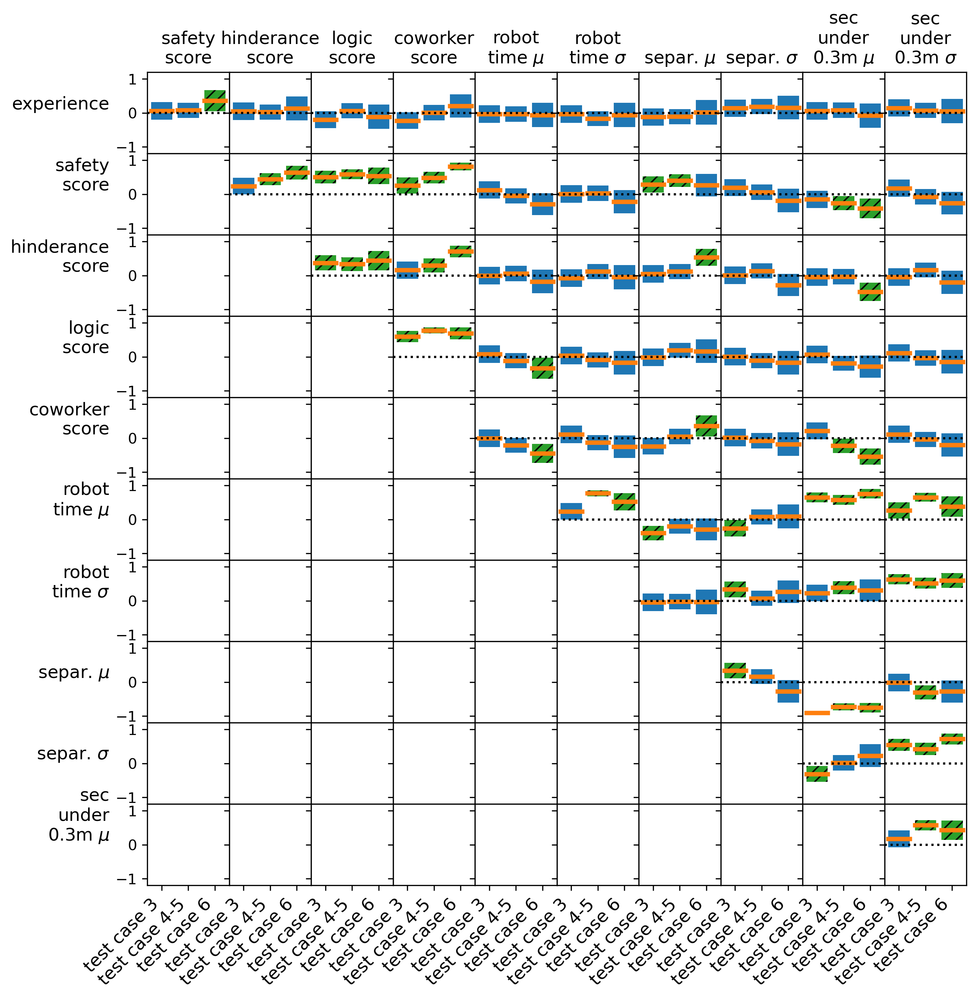

In [33]:
import pandas as pd
df_corr = pd.read_csv(os.path.join(os.getcwd(),'participant_questions','correlations_tasks.csv'))
print(df_corr.columns) 
corr_np = df_corr.to_numpy()
import_fields = ['experience','safety.score','hinderance.score','logic.score','coworkder.score','avg..robot.time','std..robot.time',
 'avg..separation','std..separation','avg..time.under.0.3m','std..time.under.0.3m']
output_fields = ['experience','safety\nscore','hinderance\nscore','logic\nscore','coworker\nscore','robot\ntime $\mu$','robot\ntime $\sigma$',
 'separ. $\mu$','separ. $\sigma$','sec\nunder\n0.3m $\mu$','sec\nunder\n0.3m $\sigma$']
print(len(output_fields))
col_names = ['test case 3','test case 4-5','test case 6']
start_r = 0
f_names = ['exp_corr','safety_score_corr','hinderance_corr','logic_score_corr','coworker_score_corr','avg_robot_time_corr',
           'std_robot_time_corr','avg_separation_corr','std_separation_corr','avg_t_u_p3_corr','std_t_u_p3_corr']
fig, axs = plt.subplots(10, 10, figsize=(10,10),sharex=True, sharey=True)
for k in reversed(range(1,11)):  
    for j in range(k): 
        for i in range(3):
            s1 = corr_np[j*2+start_r,i+1]>0
            s2 = corr_np[j*2+start_r+1,i+1]>0
            if s1==s2:
                c = 'tab:green'
                h = '///'
            else:
                c = 'tab:blue'
                h = ''
            axs[10-k,j+(10-k)].add_patch(Rectangle((i-0.4,corr_np[j*2+start_r,i+1]), 0.8, corr_np[j*2+start_r+1,i+1]-corr_np[j*2+start_r,i+1],facecolor=c,hatch=h))
            mean_diff = 0.5*(corr_np[j*2+start_r,i+1]+corr_np[j*2+start_r+1,i+1])
            axs[10-k,j+(10-k)].plot([i-0.4,i+0.4],[mean_diff,mean_diff],color='tab:orange',linewidth=3)
        axs[10-k,j+(10-k)].axhline(0.0,linestyle='dotted',color='black')
        if j==0:
            axs[10-k,j].set_ylabel('{}'.format(output_fields[10-k]),rotation=0,horizontalalignment='right',fontsize=fsize)
            axs[10-k,j].set_ylim([-1.2,1.2])
    start_r += k*2
for i in range(10):
    axs[-1,i].set_xticks(range(3),col_names,rotation=45,fontsize=fsize,ha='right')
for j in range(10):
    axs[0,j].set_title('{}'.format(output_fields[j+1]),fontsize=fsize)
# lbls = axs[-1].get_xticklabels()
# for i in range(len(lbls)):
# #         lbls[i].set_backgroundcolor('lightgray' if i % 2 == 0 else 'whitesmoke')
#     lbls[i].set_bbox(dict(boxstyle='square,pad=0.2',facecolor='lightgray' if i % 2 == 0 else 'whitesmoke', edgecolor='None'))
plt.subplots_adjust(wspace=0, hspace=0.0)
# plt.savefig(os.path.join(os.getcwd(),'images',f_names[10-k]),dpi=600,facecolor='white',bbox_inches='tight')
plt.show()

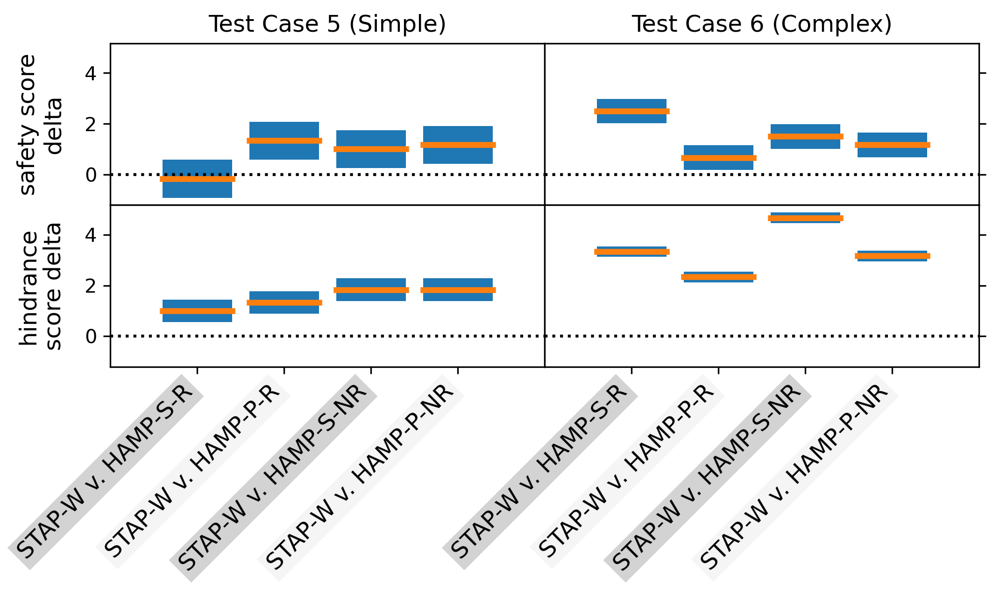

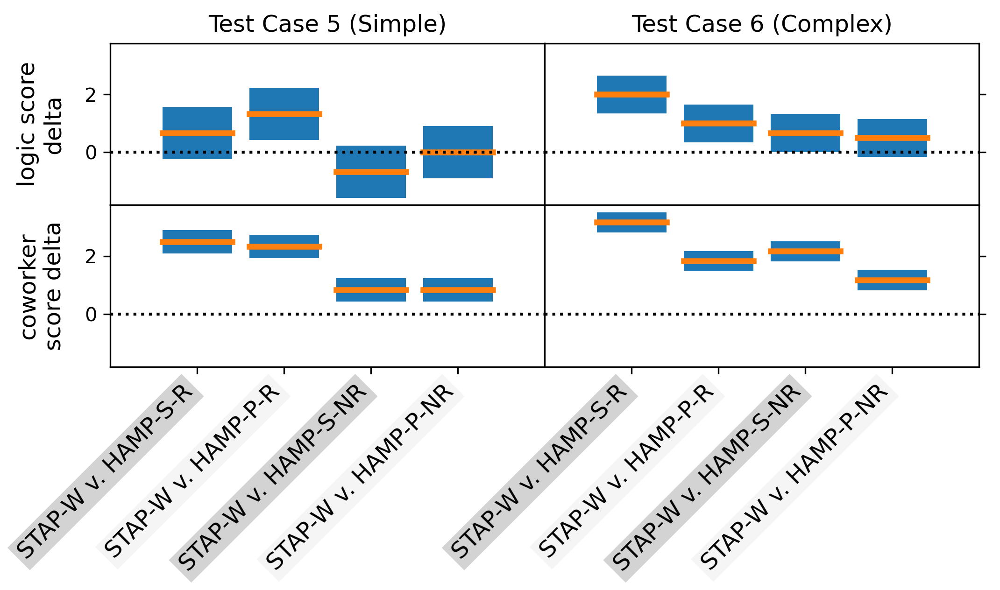

In [37]:

fig, ax= plt.subplots(2,2,sharey=True,sharex=True,figsize=(8, 3))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_safety_results,2,ax[0,0])
plot_comparisons(task_2_3_t_test_safety_results,3,ax[0,1])
ax[0,0].set_xticks([])
ax[0,1].set_xticks([])
plot_comparisons(task_2_3_t_test_hinder_results,2,ax[1,0])
plot_comparisons(task_2_3_t_test_hinder_results,3,ax[1,1])
ax[0,0].set_ylabel('safety score\ndelta',fontsize=fsize,fontweight=fweight)
ax[0,0].yaxis.tick_left()
ax[0,0].yaxis.set_label_position("left")
ax[0,1].set_ylabel('')
ax[1,0].set_ylabel('hindrance\nscore delta',fontsize=fsize,fontweight=fweight)
ax[1,0].yaxis.tick_left()
ax[1,0].yaxis.set_label_position("left")
ax[1,1].set_ylabel('')
ax[0,0].set_title('Test Case 5 (Simple)')
ax[0,1].set_title('Test Case 6 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()
fig, ax= plt.subplots(2,2,sharey=True,sharex=True,figsize=(8, 3))#(5.8, 1.8)
plot_comparisons(task_2_3_t_test_logic_results,2,ax[0,0])
plot_comparisons(task_2_3_t_test_logic_results,3,ax[0,1])
ax[0,0].set_xticks([])
ax[0,1].set_xticks([])
plot_comparisons(task_2_3_t_test_coworker_results,2,ax[1,0])
plot_comparisons(task_2_3_t_test_coworker_results,3,ax[1,1])
ax[0,0].set_ylabel('logic score\ndelta',fontsize=fsize,fontweight=fweight)
ax[0,0].yaxis.tick_left()
ax[0,0].yaxis.set_label_position("left")
ax[0,1].set_ylabel('')
ax[1,0].set_ylabel('coworker\nscore delta',fontsize=fsize,fontweight=fweight)
ax[1,0].yaxis.tick_left()
ax[1,0].yaxis.set_label_position("left")
ax[1,1].set_ylabel('')
ax[0,0].set_title('Test Case 5 (Simple)')
ax[0,1].set_title('Test Case 6 (Complex)')
plt.subplots_adjust(wspace=0, hspace=0.0)
plt.show()